# Seasonal meterological analysis

# Set the figure size to fit an A4 portrait width
plt.figure(figsize=(8.27, 6))  # 8.27 inches wide, adjust height as needed

# Set the figure size to fit an A4 landscape width
plt.figure(figsize=(11.7, 6))  # 11.7 inches wide, adjust height as needed

Typical Margin Considerations
Standard Document Margins: Often, documents have margins of about 1 inch (2.54 cm) on all sides. This means you have less usable width on the page.
Portrait A4 Page: Usable width ≈ 6.27 inches (8.27 inches - 2 inches for margins)
Landscape A4 Page: Usable width ≈ 9.7 inches (11.7 inches - 2 inches for margins)
Adjusting figsize for Standard Margins

In [15]:
import pandas as pd
import os
from glob import glob
from statistics import mean
import seaborn as sns

# Import libraries
import matplotlib.pyplot as plt
import numpy as np

import matplotlib as mpl
mpl.rcParams['axes.titlesize'] = 15
mpl.rcParams['axes.labelsize'] = 10
mpl.rcParams['xtick.labelsize'] = 9
mpl.rcParams['ytick.labelsize'] = 9
mpl.rcParams['legend.fontsize'] = 9

%matplotlib inline

In [16]:
def mk_dir_fn(path_):
    
    if not os.path.isdir(path_):
        os.mkdir(path_)
 

In [30]:
# type of data
d_type = "daily_rain"
#d_type = "et_morton_actual"
d_type = "max_temp"
# d_type = "min_temp"
d_type = "rh_tmax" # error
# d_type = "rh_tmin"
# d_type = "vp"


if d_type == "daily_rain":
    str_type = "rainfall"
    y_lim = [-5, 30]
    unit = "mm"
    
elif d_type == "et_morton_actual":
    str_type = "ME (Actual)"
    y_lim = [0, 10]
    unit = "mm"

elif d_type == "max_temp":
    str_type = "Max Temp"
    y_lim = [20, 45]
    unit = "\u2103"

elif d_type == "min_temp":
    str_type = "Minimum Temperature"
    y_lim = [0, 40]
    unit = "\u2103"

elif d_type == "rh_tmax":
    str_type = "Max RH at Max Temp"
    y_lim = [3200, 3400]
    unit = "%"
    
elif d_type == "rh_tmin":
    str_type = "relative humidity at minimum temperature"
    y_lim = [3200, 3400]
    unit = "%"

elif d_type == "vp":
    str_type = "vapour pressure"
    
else:
    pass

# met data
#dir_ = r"X:\PGB\RSU\biomass\raw_zonal_stats\met\collation\slats_tern\{0}".format(d_type)
#dir_ = r"C:\Users\robot\projects\biomass\zonal_stats_raw\met_clean\{0}\cor".format(d_type)
dir_ = r"C:\Users\robot\projects\biomass\zonal_stats_raw\met_clean\{0}\mth_mavg".format(d_type)
dir2_ = r"C:\Users\robot\projects\biomass\zonal_stats_raw\met_clean_2024\{0}\mth_mavg".format(d_type)

# plot directories
export_dir = r"C:\Users\robot\projects\biomass\plots\{0}".format(d_type)
mk_dir_fn(export_dir)

export_box = os.path.join(export_dir, "box_plots")
mk_dir_fn(export_box)
export_box = os.path.join(export_dir, "box_plots", "mean")
mk_dir_fn(export_box)


export_line = os.path.join(export_dir, "timeseries")
mk_dir_fn(export_line)
export_line = os.path.join(export_dir, "timeseries", "mean")
mk_dir_fn(export_line)


# csv_export = r"C:\Users\robot\projects\biomass\met_zonal_stats_per_site\{0}".format(d_type)
# mk_dir_fn(csv_export)

# box_dir = os.path.join(csv_export, d_type)
# mk_dir_fn(box_dir)

# time_dir = os.path.join(export_line, d_type)
# mk_dir_fn(time_dir)


In [31]:
dir_

'C:\\Users\\robot\\projects\\biomass\\zonal_stats_raw\\met_clean\\rh_tmax\\mth_mavg'

In [32]:
dir2_

'C:\\Users\\robot\\projects\\biomass\\zonal_stats_raw\\met_clean_2024\\rh_tmax\\mth_mavg'

In [33]:
#dir_ = r"C:\Users\robot\projects\biomass\zonal_stats_raw\met_clean\daily_rain\mth_msum"

# Box Plot

   ident            site  im_date       mean  \
0      1  agb02.2012_1ha   199301  65.670968   
1      1  agb02.2012_1ha   199302  69.400000   
2      1  agb02.2012_1ha   199303  62.777419   
3      1  agb02.2012_1ha   199304  50.676667   
4      1  agb02.2012_1ha   199305  47.316129   

                            im_name    d_type  
0  rhmax_nt_199301199301_mavga2.tif  mth_mavg  
1  rhmax_nt_199302199302_mavga2.tif  mth_mavg  
2  rhmax_nt_199303199303_mavga2.tif  mth_mavg  
3  rhmax_nt_199304199304_mavga2.tif  mth_mavg  
4  rhmax_nt_199305199305_mavga2.tif  mth_mavg  
['agb02.2012_1ha' 'amg01.2012_1ha' 'amg03.2012_1ha' 'amg05.2012_1ha'
 'amg06.2012_1ha' 'amg08.2012_1ha' 'amg10.2012_1ha' 'ant01.2012_1ha'
 'ant02.2012_1ha' 'ant03.2012_1ha' 'ant04.2012_1ha' 'ant06.2012_1ha'
 'ant07.2012_1ha' 'ant09.2012_1ha' 'antgr01.2012_1ha' 'auv01.2012_1ha'
 'auv02.2012_1ha' 'auv03.2012_1ha' 'auv05.2012_1ha' 'auv06.2012_1ha'
 'auv07.2012_1ha' 'auv08.2012_1ha' 'auv09.2012_1ha' 'barkely01.2011_1ha'
 'b

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

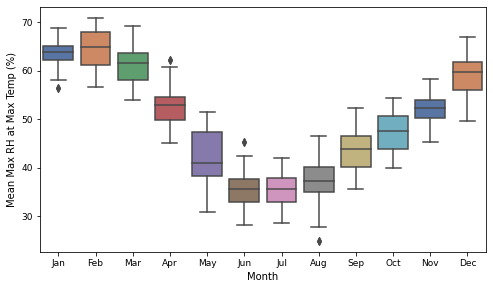

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\agb02_2012_1ha_rh_tmax_mean_box.jpg
amg01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg01_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

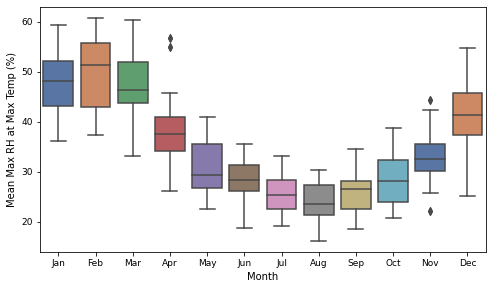

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg01_2012_1ha_rh_tmax_mean_box.jpg
amg03.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg03_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

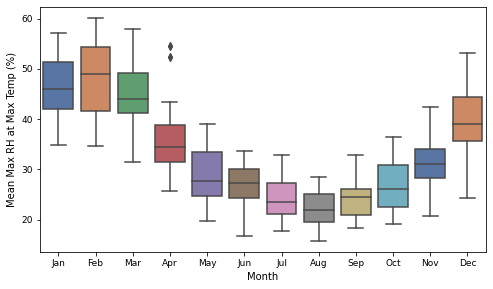

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg03_2012_1ha_rh_tmax_mean_box.jpg
amg05.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg05_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

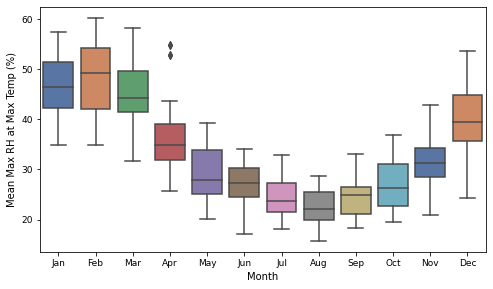

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg05_2012_1ha_rh_tmax_mean_box.jpg
amg06.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg06_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

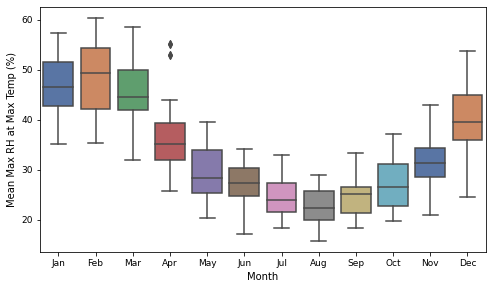

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg06_2012_1ha_rh_tmax_mean_box.jpg
amg08.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg08_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

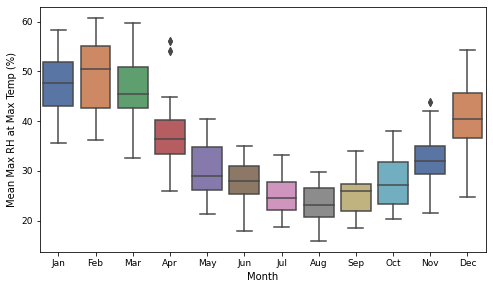

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg08_2012_1ha_rh_tmax_mean_box.jpg
amg10.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg10_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

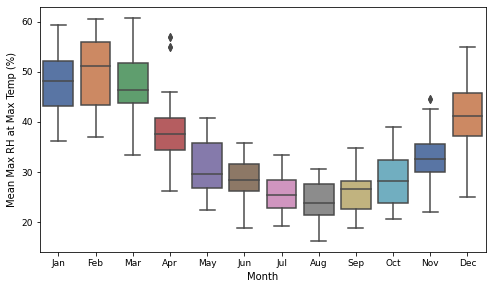

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\amg10_2012_1ha_rh_tmax_mean_box.jpg
ant01.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant01_2012_1ha_rh_tmax_mean_box.jpg


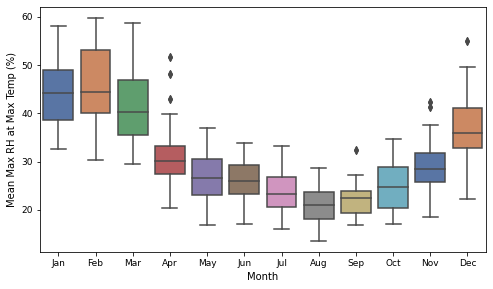

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant01_2012_1ha_rh_tmax_mean_box.jpg
ant02.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant02_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

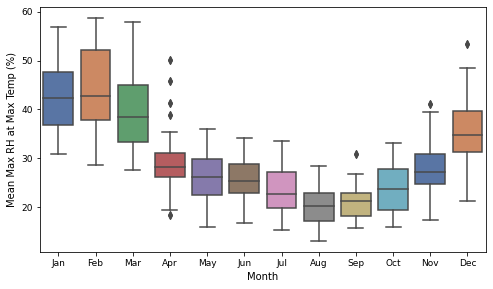

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant02_2012_1ha_rh_tmax_mean_box.jpg
ant03.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant03_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

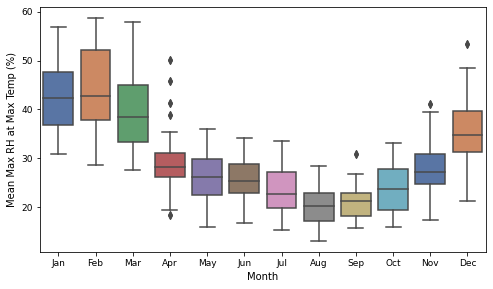

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant03_2012_1ha_rh_tmax_mean_box.jpg
ant04.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant04_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

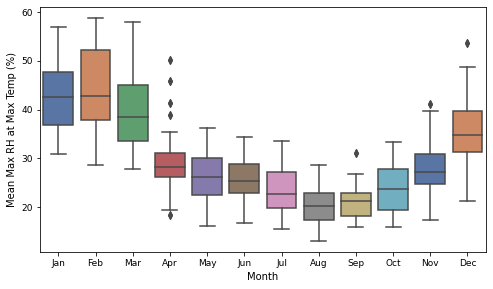

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant04_2012_1ha_rh_tmax_mean_box.jpg
ant06.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant06_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

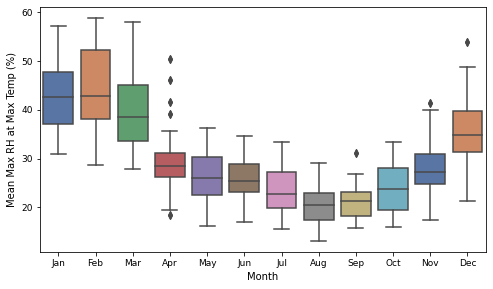

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant06_2012_1ha_rh_tmax_mean_box.jpg
ant07.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant07_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

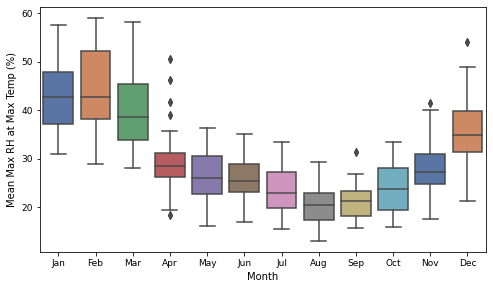

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant07_2012_1ha_rh_tmax_mean_box.jpg
ant09.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant09_2012_1ha_rh_tmax_mean_box.jpg


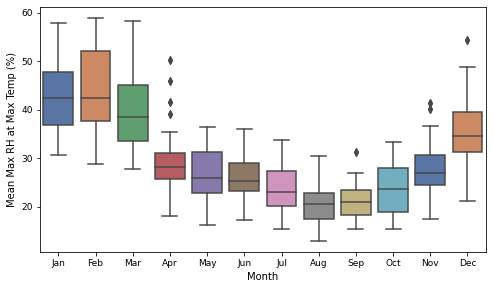

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ant09_2012_1ha_rh_tmax_mean_box.jpg
antgr01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\antgr01_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

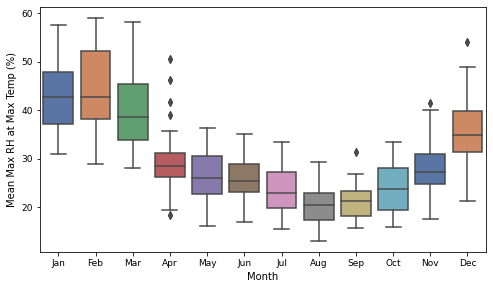

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\antgr01_2012_1ha_rh_tmax_mean_box.jpg
auv01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv01_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

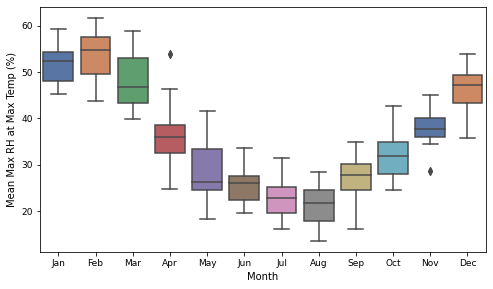

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv01_2012_1ha_rh_tmax_mean_box.jpg
auv02.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv02_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

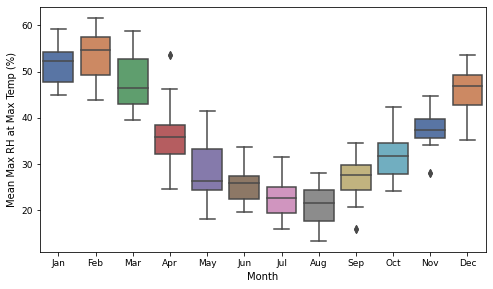

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv02_2012_1ha_rh_tmax_mean_box.jpg
auv03.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv03_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

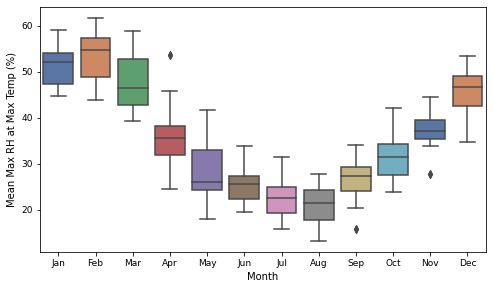

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv03_2012_1ha_rh_tmax_mean_box.jpg
auv05.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv05_2012_1ha_rh_tmax_mean_box.jpg


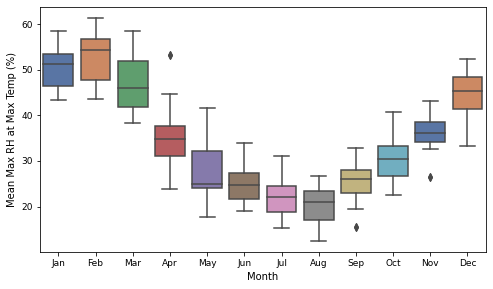

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv05_2012_1ha_rh_tmax_mean_box.jpg
auv06.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv06_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

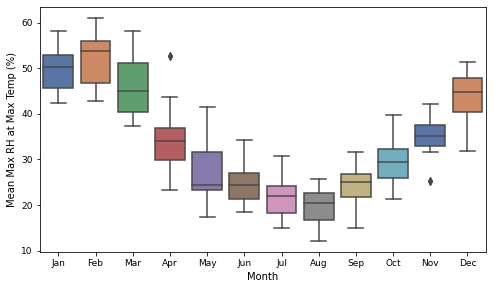

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv06_2012_1ha_rh_tmax_mean_box.jpg
auv07.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv07_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

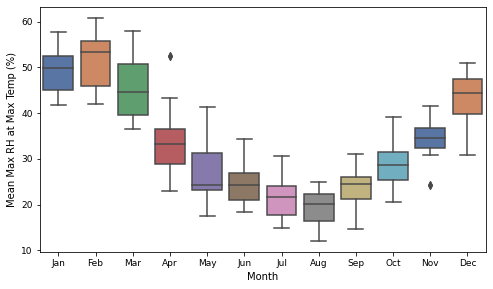

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv07_2012_1ha_rh_tmax_mean_box.jpg
auv08.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv08_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

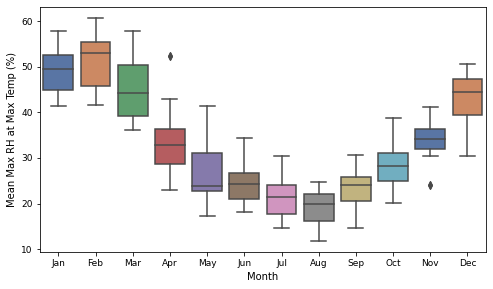

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv08_2012_1ha_rh_tmax_mean_box.jpg
auv09.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv09_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

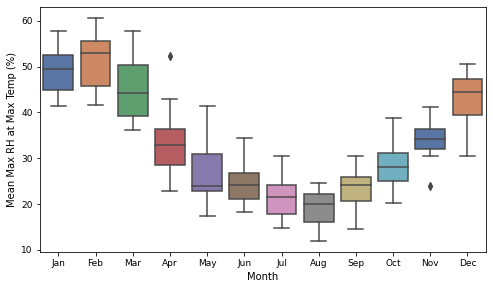

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\auv09_2012_1ha_rh_tmax_mean_box.jpg
barkely01.2011_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely01_2011_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

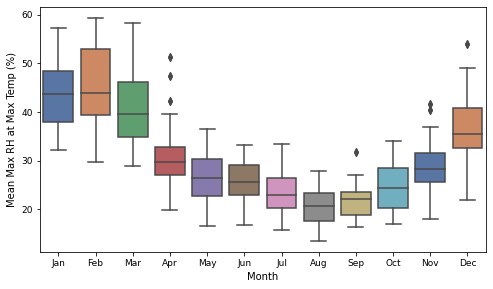

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely01_2011_1ha_rh_tmax_mean_box.jpg
barkely02.2011_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely02_2011_1ha_rh_tmax_mean_box.jpg


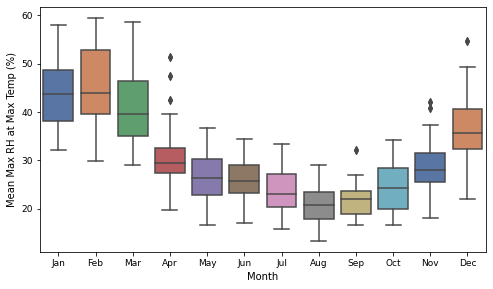

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely02_2011_1ha_rh_tmax_mean_box.jpg
barkely03.2011_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely03_2011_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

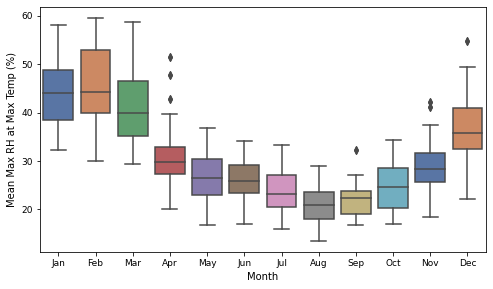

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely03_2011_1ha_rh_tmax_mean_box.jpg
barkely04.2011_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely04_2011_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

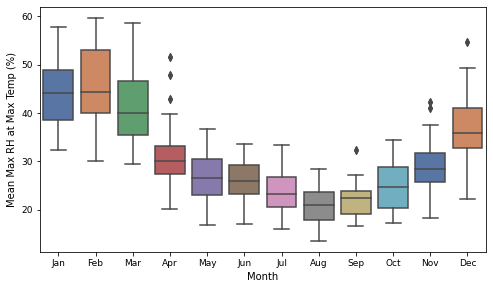

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely04_2011_1ha_rh_tmax_mean_box.jpg
barkely05.2011_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely05_2011_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

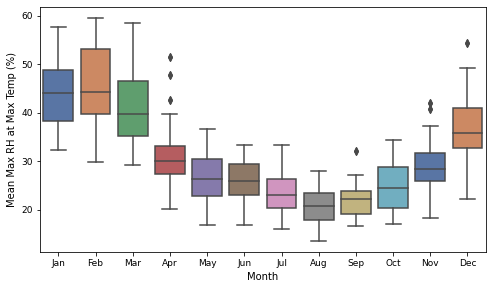

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely05_2011_1ha_rh_tmax_mean_box.jpg
barkely06.2011_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely06_2011_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

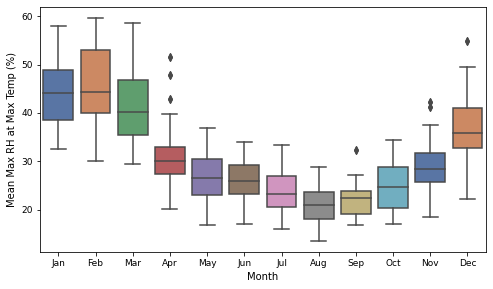

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely06_2011_1ha_rh_tmax_mean_box.jpg
barkely07.2011_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely07_2011_1ha_rh_tmax_mean_box.jpg


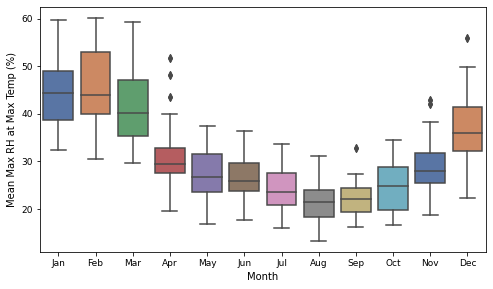

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\barkely07_2011_1ha_rh_tmax_mean_box.jpg
bc101.2024_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\bc101_2024_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

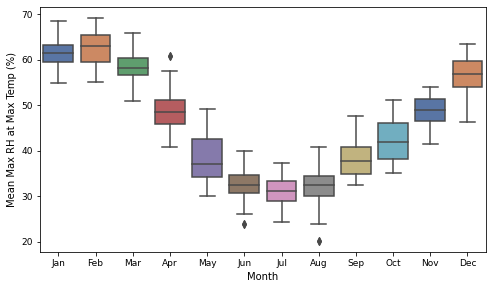

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\bc101_2024_1ha_rh_tmax_mean_box.jpg
buff01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\buff01_2012_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

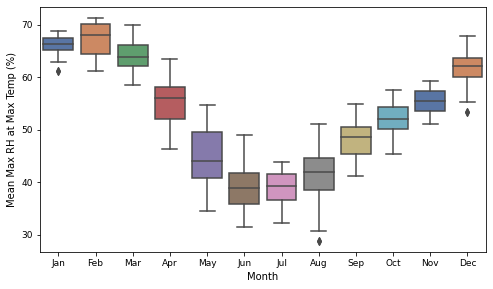

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\buff01_2012_1ha_rh_tmax_mean_box.jpg
centa13.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\centa13_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

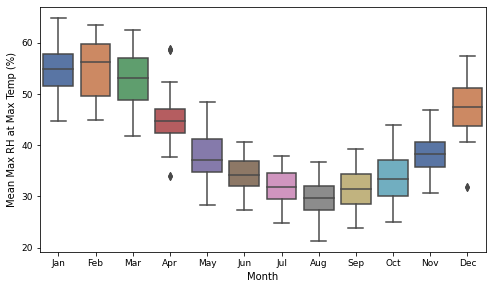

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\centa13_2013_1ha_rh_tmax_mean_box.jpg
centa14.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\centa14_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

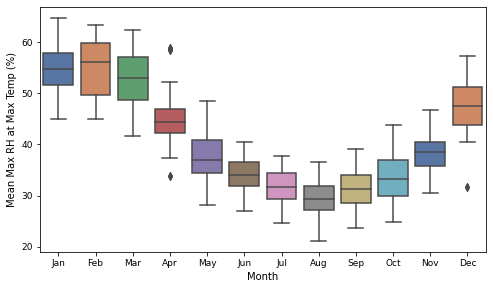

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\centa14_2012_1ha_rh_tmax_mean_box.jpg
cpr01.2024_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\cpr01_2024_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

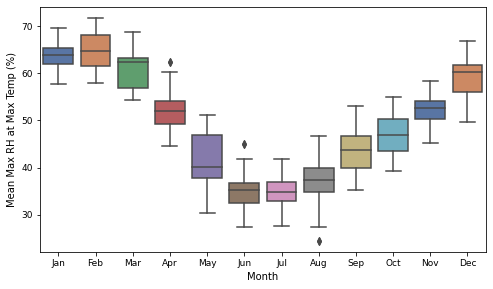

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\cpr01_2024_1ha_rh_tmax_mean_box.jpg
cpr02.2024_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\cpr02_2024_1ha_rh_tmax_mean_box.jpg


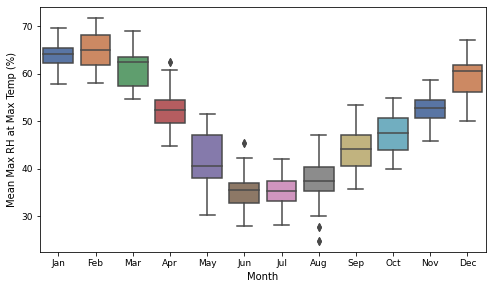

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\cpr02_2024_1ha_rh_tmax_mean_box.jpg
cpr03.2024_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\cpr03_2024_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

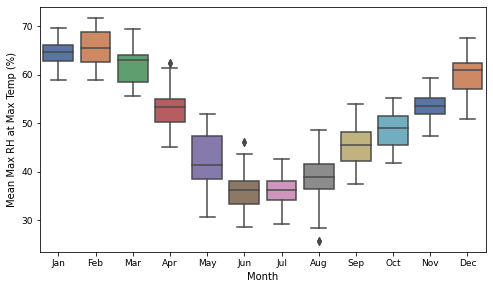

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\cpr03_2024_1ha_rh_tmax_mean_box.jpg
cpr04.2024_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\cpr04_2024_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

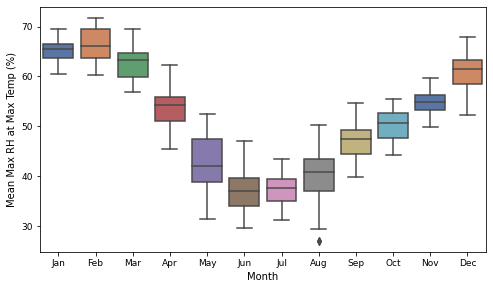

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\cpr04_2024_1ha_rh_tmax_mean_box.jpg
el01.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\el01_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

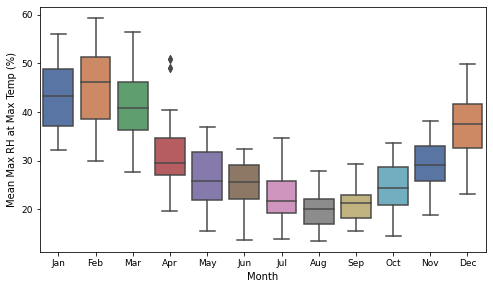

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\el01_2013_1ha_rh_tmax_mean_box.jpg
el02.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\el02_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

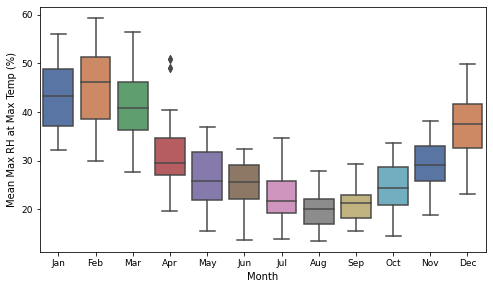

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\el02_2013_1ha_rh_tmax_mean_box.jpg
ep01.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ep01_2012_1ha_rh_tmax_mean_box.jpg


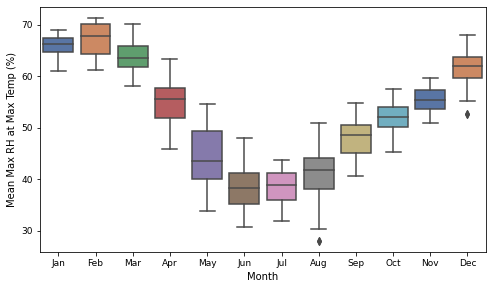

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ep01_2012_1ha_rh_tmax_mean_box.jpg
fin101.2024_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\fin101_2024_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

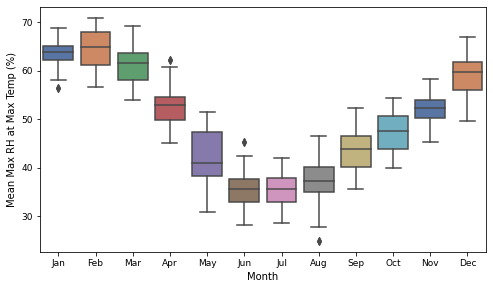

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\fin101_2024_1ha_rh_tmax_mean_box.jpg
fin102.2024_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\fin102_2024_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

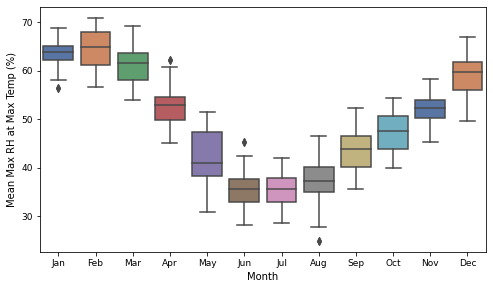

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\fin102_2024_1ha_rh_tmax_mean_box.jpg
girra01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\girra01_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

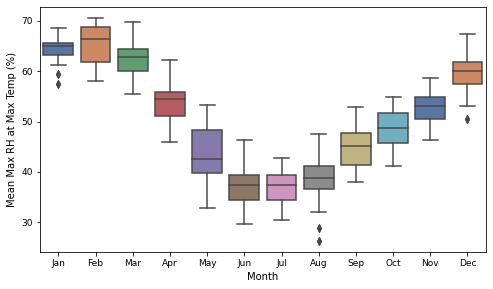

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\girra01_2012_1ha_rh_tmax_mean_box.jpg
girra02.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\girra02_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

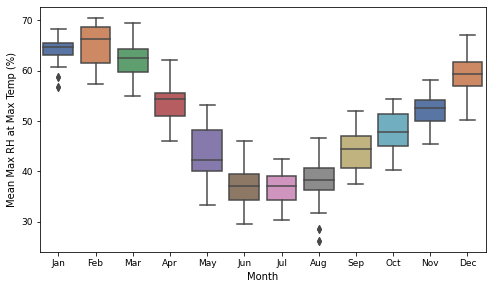

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\girra02_2012_1ha_rh_tmax_mean_box.jpg
gulf10.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\gulf10_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

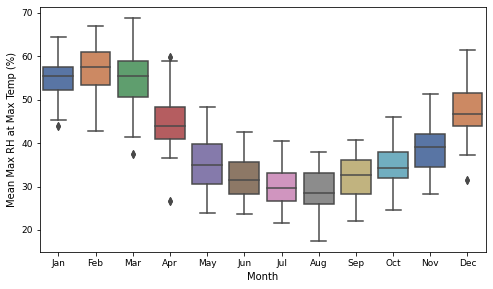

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\gulf10_2013_1ha_rh_tmax_mean_box.jpg
gulf11.2013_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\gulf11_2013_1ha_rh_tmax_mean_box.jpg


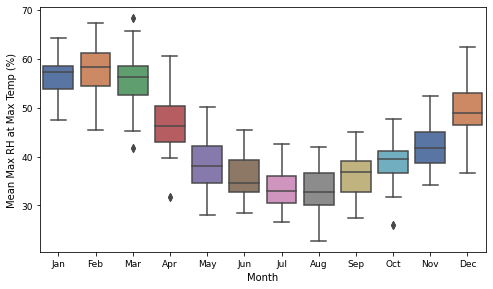

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\gulf11_2013_1ha_rh_tmax_mean_box.jpg
gulf12.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\gulf12_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

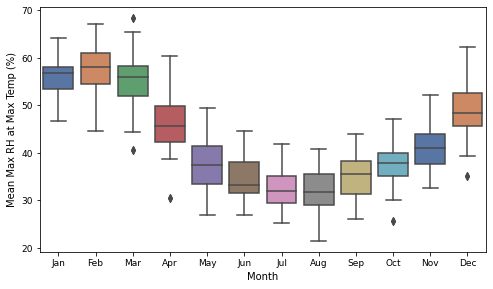

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\gulf12_2013_1ha_rh_tmax_mean_box.jpg
hsf01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\hsf01_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

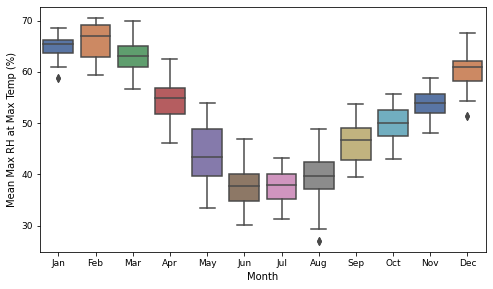

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\hsf01_2012_1ha_rh_tmax_mean_box.jpg
hsf02.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\hsf02_2012_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

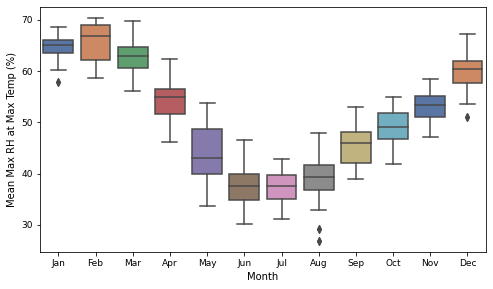

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\hsf02_2012_1ha_rh_tmax_mean_box.jpg
hshr01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\hshr01_2012_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

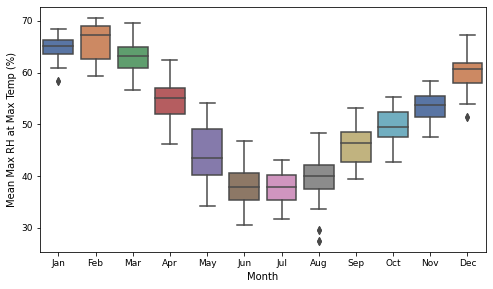

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\hshr01_2012_1ha_rh_tmax_mean_box.jpg
jdr01.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr01_2012_1ha_rh_tmax_mean_box.jpg


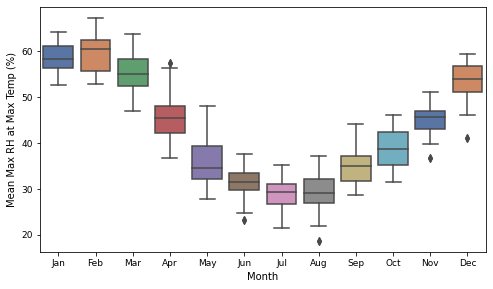

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr01_2012_1ha_rh_tmax_mean_box.jpg
jdr02.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr02_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

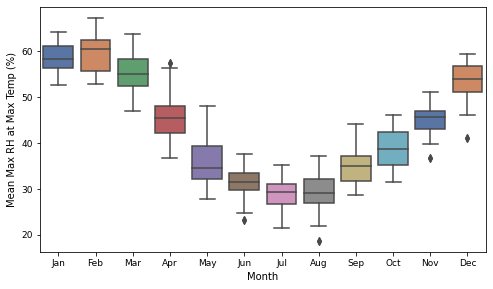

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr02_2012_1ha_rh_tmax_mean_box.jpg
jdr03.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr03_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

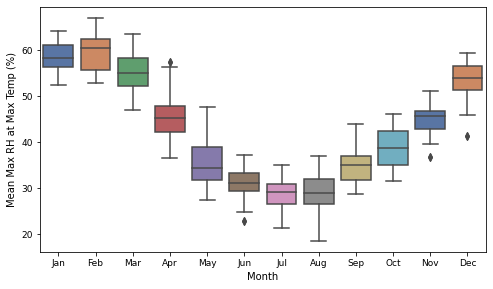

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr03_2012_1ha_rh_tmax_mean_box.jpg
jdr04.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr04_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

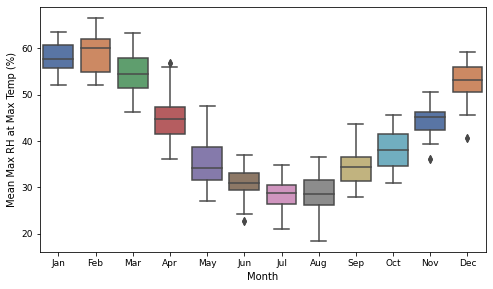

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr04_2012_1ha_rh_tmax_mean_box.jpg
jdr05.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr05_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

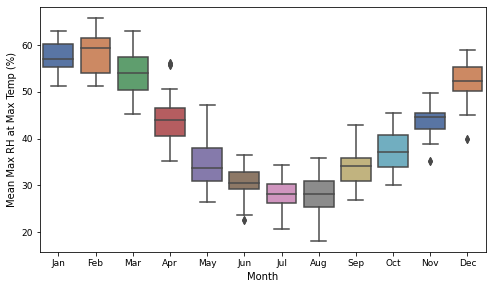

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jdr05_2012_1ha_rh_tmax_mean_box.jpg
jnk101.2024_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jnk101_2024_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

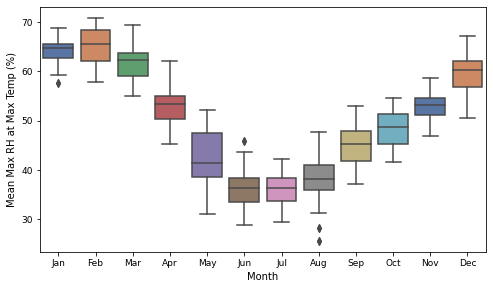

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jnk101_2024_1ha_rh_tmax_mean_box.jpg
jnk102.2024_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jnk102_2024_1ha_rh_tmax_mean_box.jpg


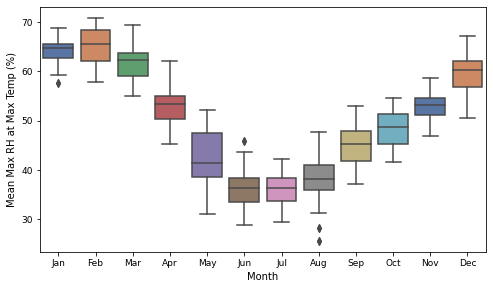

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jnk102_2024_1ha_rh_tmax_mean_box.jpg
jnk103.2024_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jnk103_2024_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

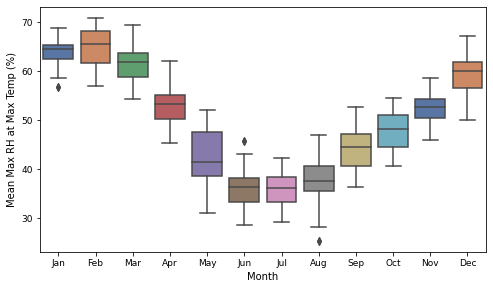

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\jnk103_2024_1ha_rh_tmax_mean_box.jpg
larr15.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\larr15_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

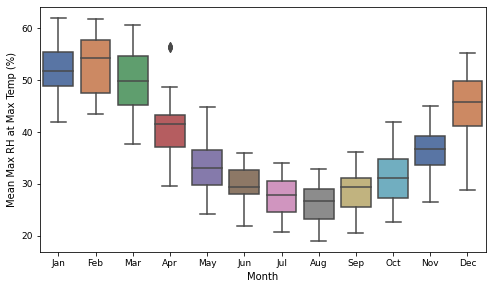

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\larr15_2013_1ha_rh_tmax_mean_box.jpg
legu01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu01_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

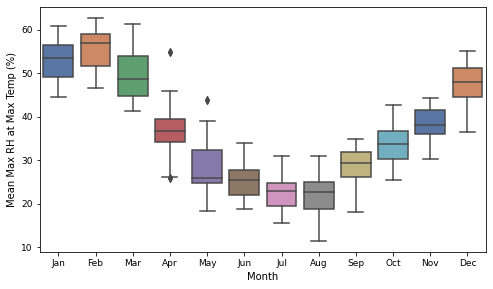

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu01_2012_1ha_rh_tmax_mean_box.jpg
legu02.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu02_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

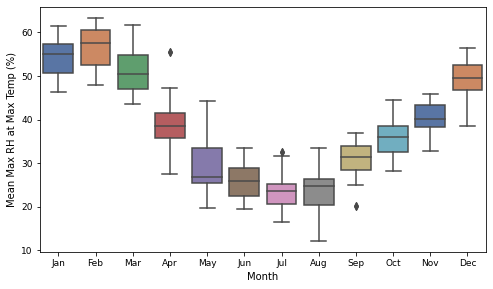

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu02_2012_1ha_rh_tmax_mean_box.jpg
legu03.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu03_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

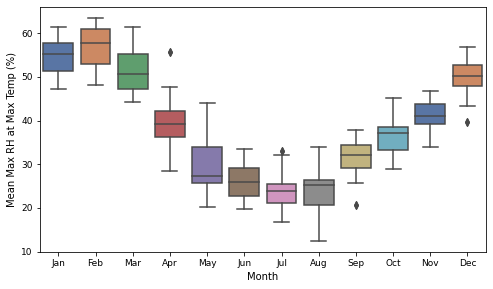

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu03_2012_1ha_rh_tmax_mean_box.jpg
legu04.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu04_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

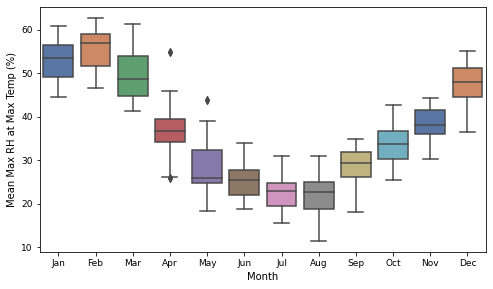

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu04_2012_1ha_rh_tmax_mean_box.jpg
legu05.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu05_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

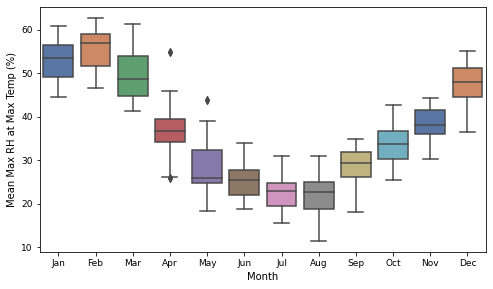

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu05_2012_1ha_rh_tmax_mean_box.jpg
legu06.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu06_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

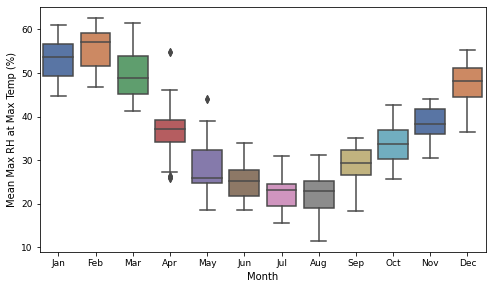

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu06_2012_1ha_rh_tmax_mean_box.jpg
legu07.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu07_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

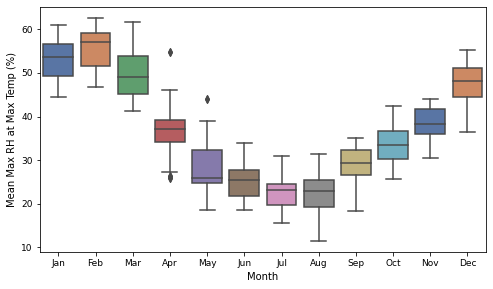

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu07_2012_1ha_rh_tmax_mean_box.jpg
legu08.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu08_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

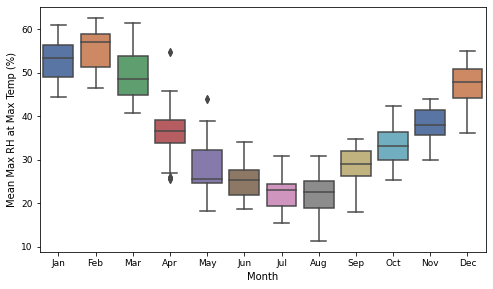

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\legu08_2012_1ha_rh_tmax_mean_box.jpg
lfr101.2024_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lfr101_2024_1ha_rh_tmax_mean_box.jpg


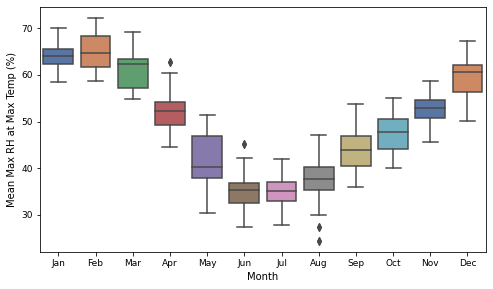

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lfr101_2024_1ha_rh_tmax_mean_box.jpg
lfr102.2024_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lfr102_2024_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

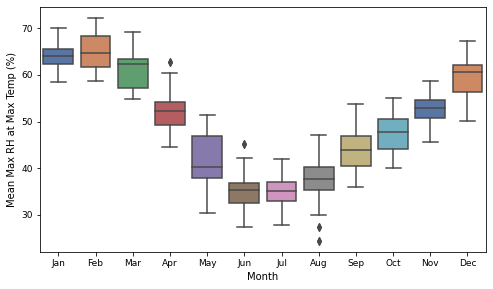

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lfr102_2024_1ha_rh_tmax_mean_box.jpg
lim01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim01_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

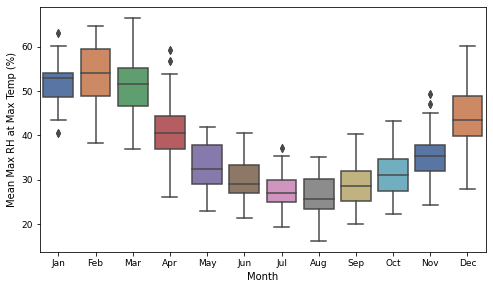

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim01_2012_1ha_rh_tmax_mean_box.jpg
lim03.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim03_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

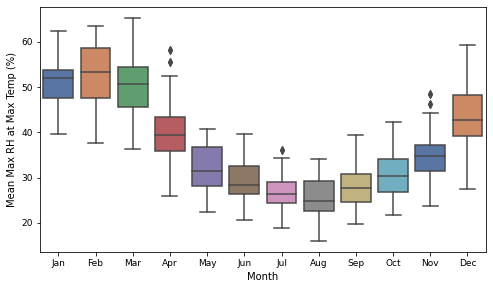

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim03_2012_1ha_rh_tmax_mean_box.jpg
lim04.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim04_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

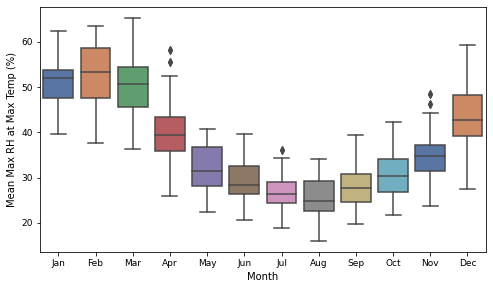

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim04_2012_1ha_rh_tmax_mean_box.jpg
lim06.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim06_2012_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

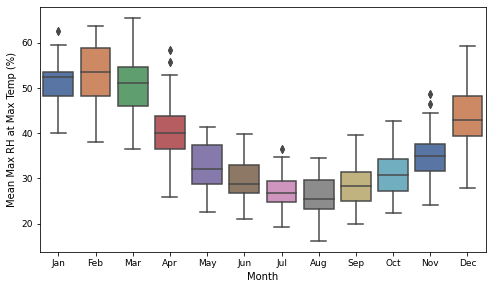

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim06_2012_1ha_rh_tmax_mean_box.jpg
lim08.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim08_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

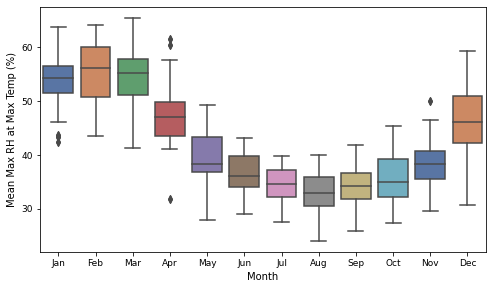

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim08_2013_1ha_rh_tmax_mean_box.jpg
lim09.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim09_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

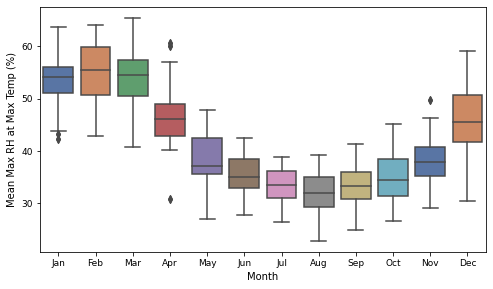

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lim09_2013_1ha_rh_tmax_mean_box.jpg
lit01.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lit01_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

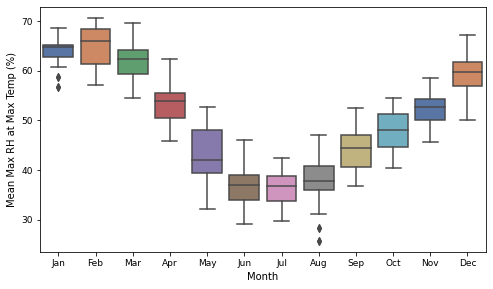

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lit01_2013_1ha_rh_tmax_mean_box.jpg
lto04.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lto04_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

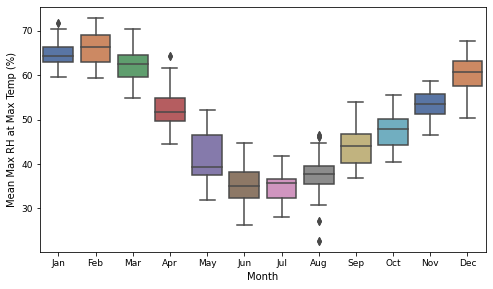

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lto04_2013_1ha_rh_tmax_mean_box.jpg
lto05.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lto05_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

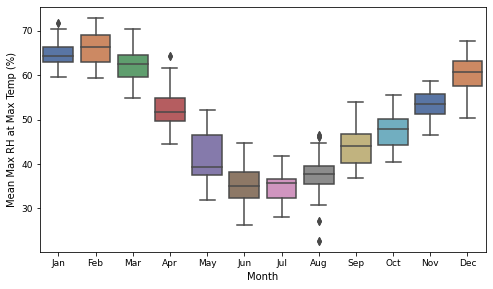

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\lto05_2013_1ha_rh_tmax_mean_box.jpg
nc02.2013_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nc02_2013_1ha_rh_tmax_mean_box.jpg


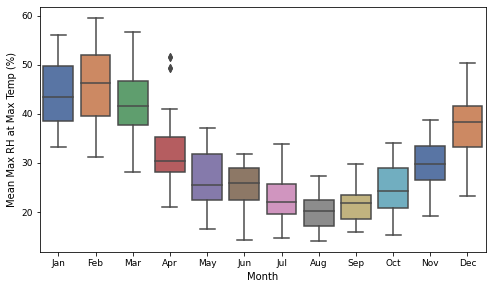

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nc02_2013_1ha_rh_tmax_mean_box.jpg
nc03.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nc03_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

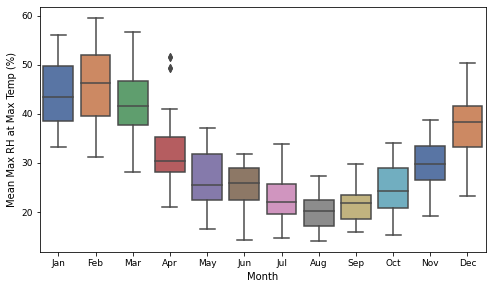

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nc03_2013_1ha_rh_tmax_mean_box.jpg
nt001.2011_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nt001_2011_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

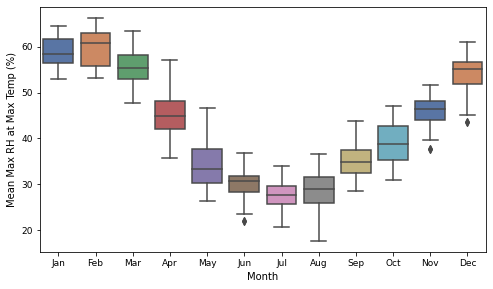

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nt001_2011_1ha_rh_tmax_mean_box.jpg
nt002.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nt002_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

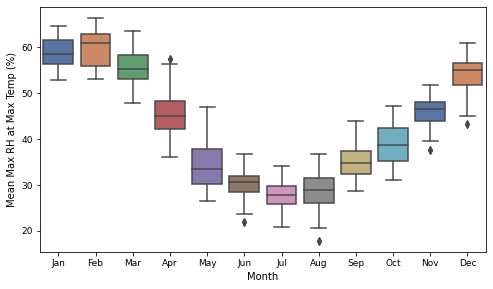

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nt002_2012_1ha_rh_tmax_mean_box.jpg
nt003.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nt003_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

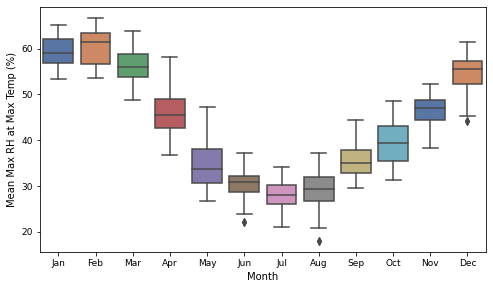

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nt003_2012_1ha_rh_tmax_mean_box.jpg
nt004.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nt004_2012_1ha_rh_tmax_mean_box.jpg


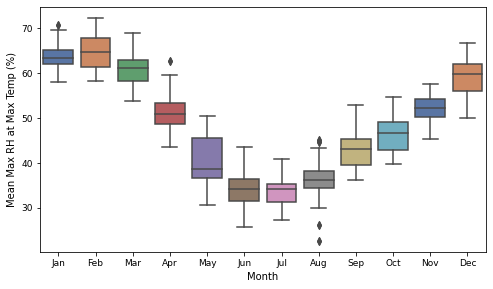

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nt004_2012_1ha_rh_tmax_mean_box.jpg
ntaarp0001.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntaarp0001_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

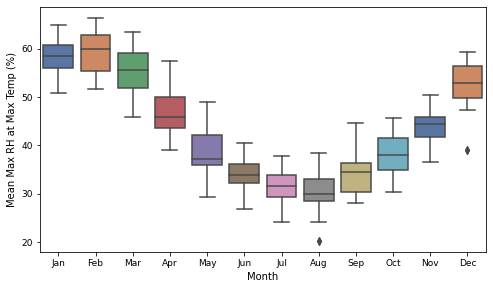

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntaarp0001_2016_1ha_rh_tmax_mean_box.jpg
ntaarp0002.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntaarp0002_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

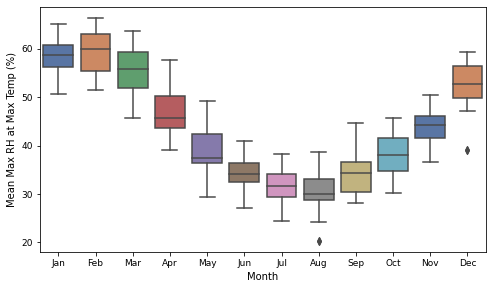

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntaarp0002_2016_1ha_rh_tmax_mean_box.jpg
ntaarp0003.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntaarp0003_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

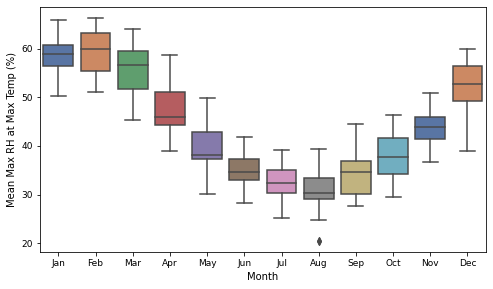

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntaarp0003_2016_1ha_rh_tmax_mean_box.jpg
ntadac0001.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntadac0001_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

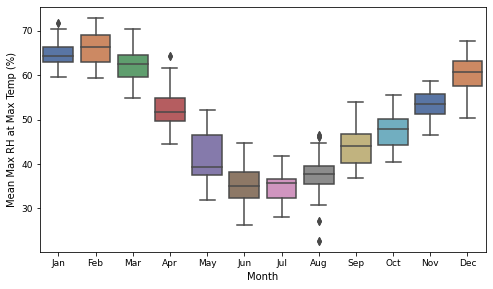

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntadac0001_2013_1ha_rh_tmax_mean_box.jpg
ntadac0002.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntadac0002_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

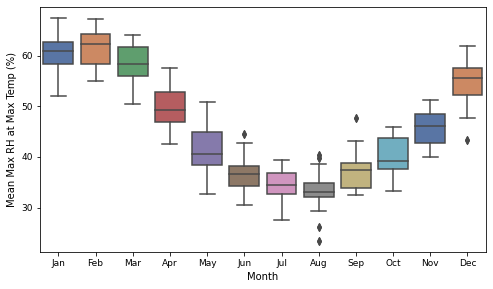

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntadac0002_2016_1ha_rh_tmax_mean_box.jpg
ntagfu0001.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0001_2012_1ha_rh_tmax_mean_box.jpg


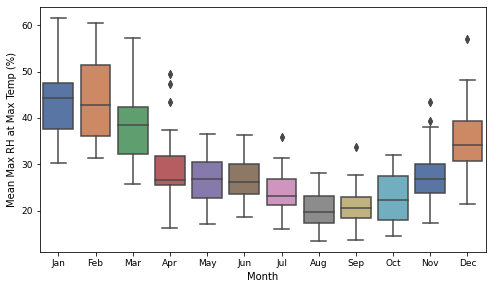

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0001_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0002.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0002_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

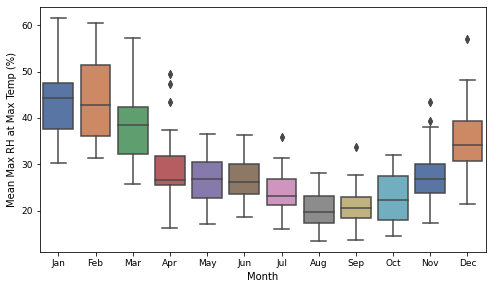

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0002_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0003.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0003_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

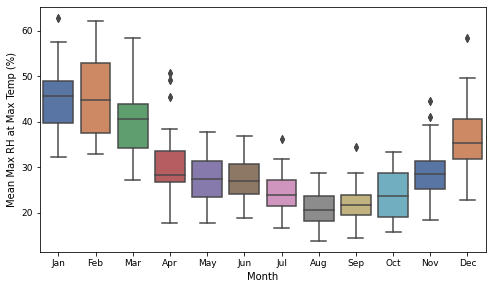

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0003_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0004.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0004_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

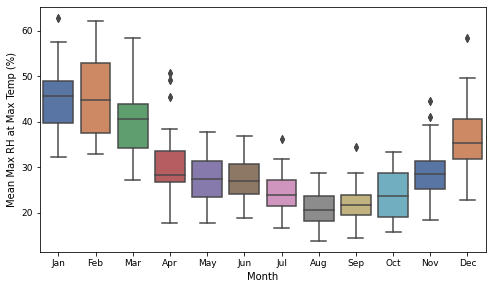

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0004_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0005.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0005_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

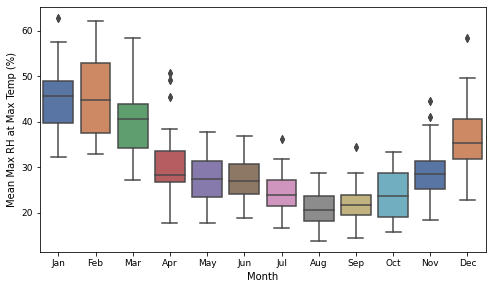

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0005_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0006.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0006_2012_1ha_rh_tmax_mean_box.jpg


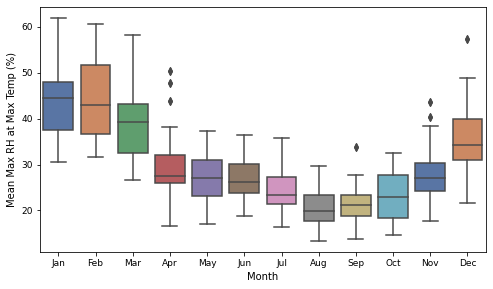

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0006_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0007.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0007_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

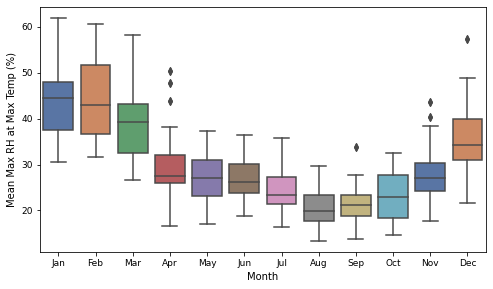

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0007_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0008.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0008_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

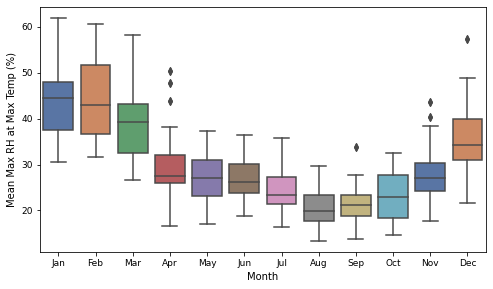

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0008_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0009.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0009_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

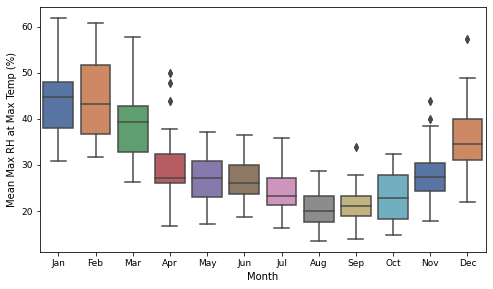

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0009_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0010.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0010_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

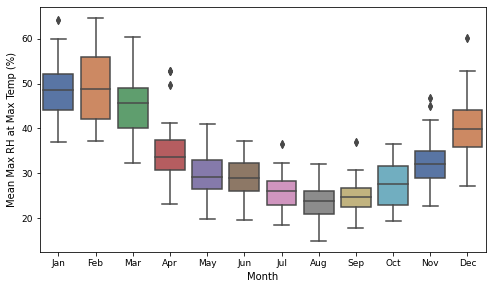

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0010_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0011.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0011_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

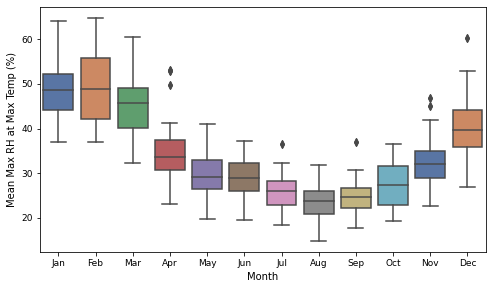

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0011_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0012.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0012_2012_1ha_rh_tmax_mean_box.jpg


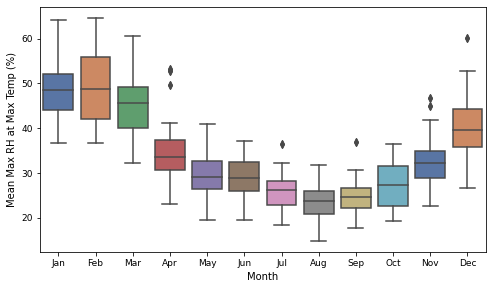

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0012_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0013.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0013_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

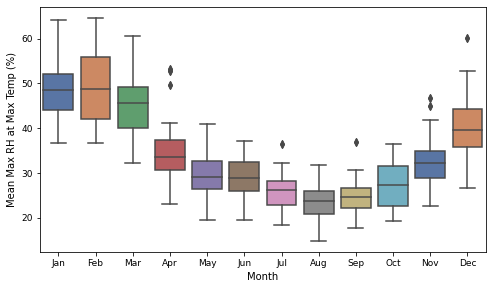

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0013_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0014.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0014_2012_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

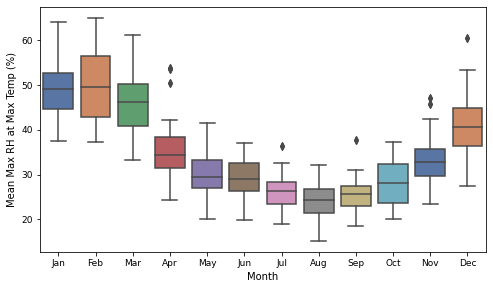

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0014_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0015.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0015_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

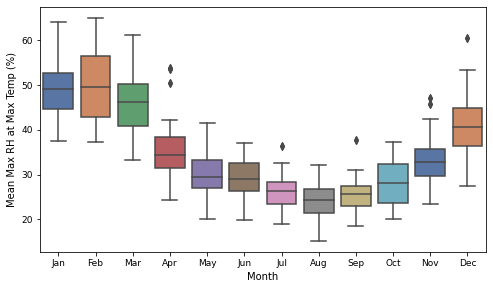

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0015_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0016.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0016_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

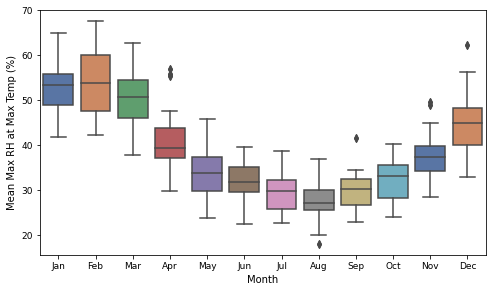

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0016_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0017.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0017_2012_1ha_rh_tmax_mean_box.jpg


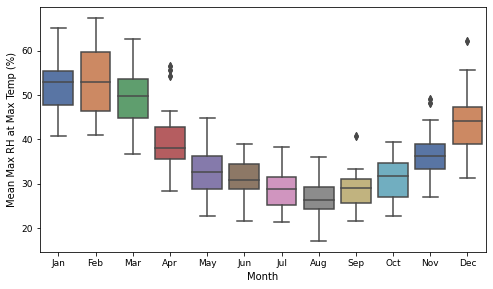

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0017_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0018.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0018_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

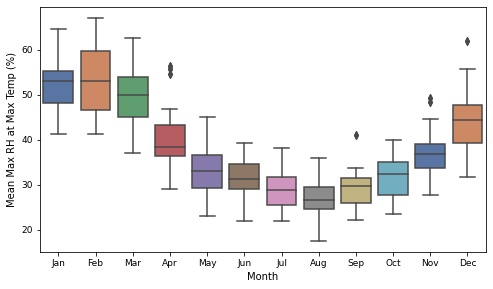

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0018_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0019.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0019_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

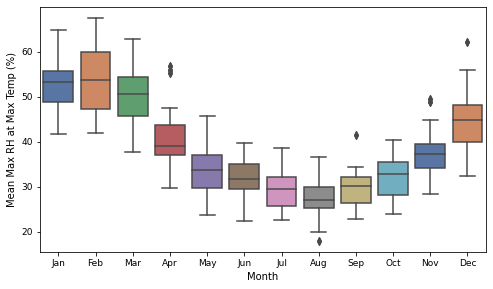

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0019_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0020.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0020_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

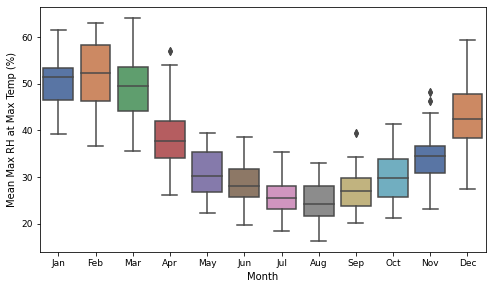

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0020_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0021.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0021_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

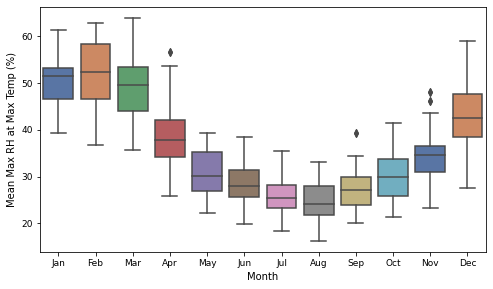

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0021_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0022.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0022_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

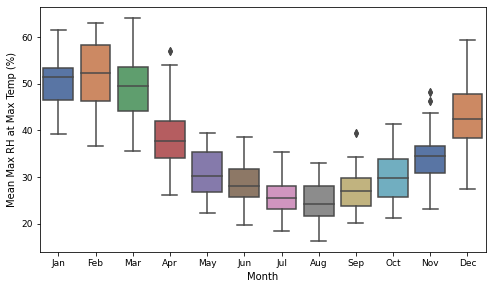

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0022_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0023.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0023_2012_1ha_rh_tmax_mean_box.jpg


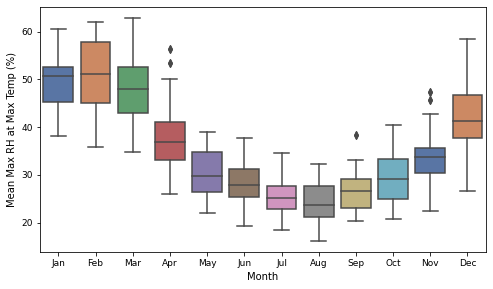

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0023_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0024.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0024_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

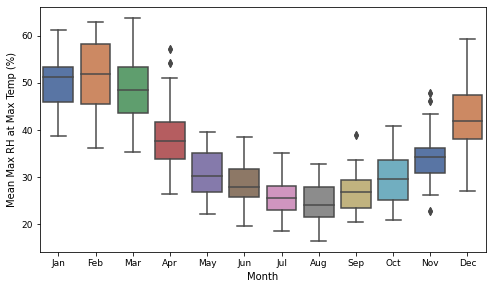

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0024_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0025.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0025_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

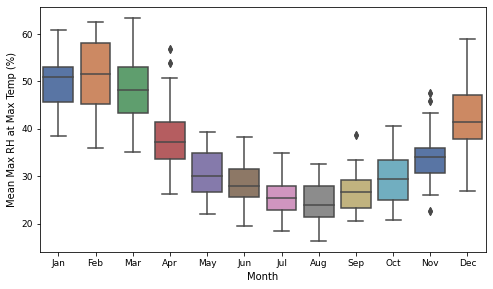

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0025_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0026.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0026_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

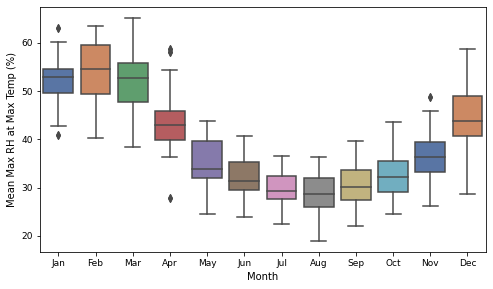

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0026_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0027.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0027_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

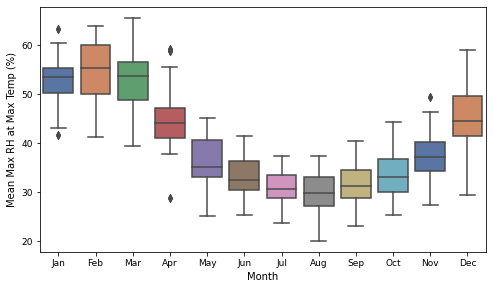

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0027_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0028.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0028_2012_1ha_rh_tmax_mean_box.jpg


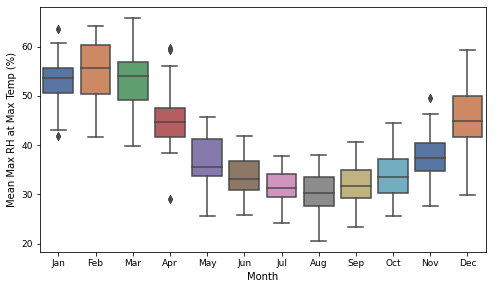

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0028_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0029.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0029_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

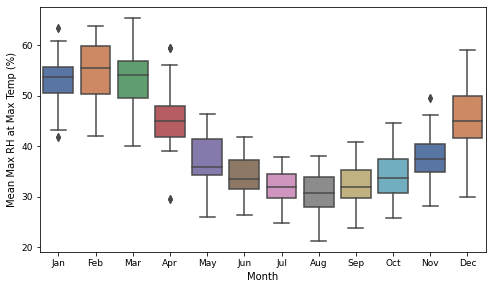

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0029_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0030.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0030_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

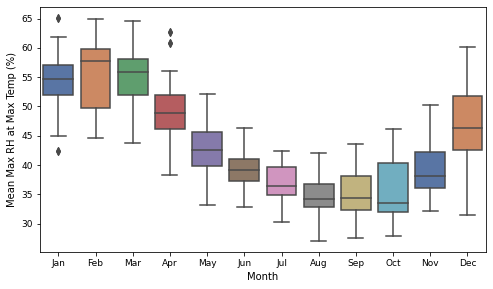

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0030_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0031.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0031_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

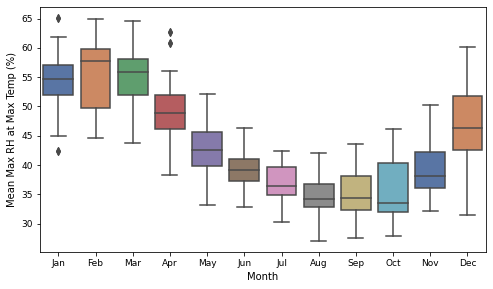

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0031_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0032.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0032_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

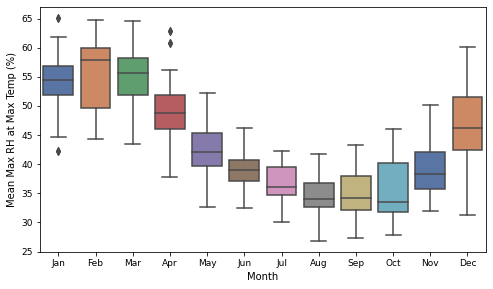

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0032_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0033.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0033_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

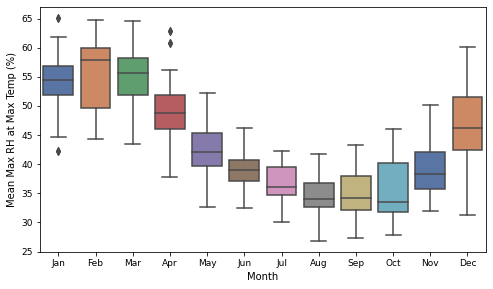

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0033_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0034.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0034_2012_1ha_rh_tmax_mean_box.jpg


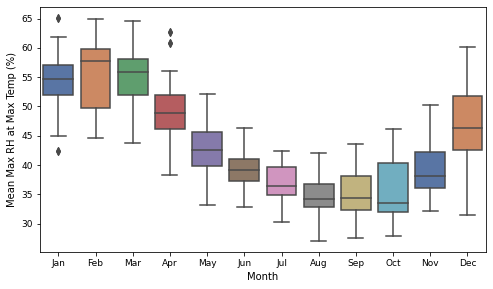

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0034_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0035.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0035_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

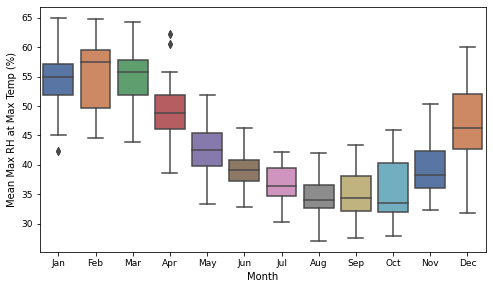

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0035_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0036.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0036_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

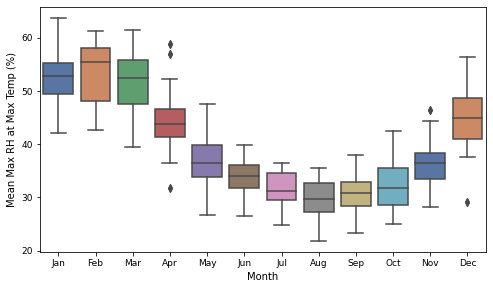

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0036_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0037.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0037_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

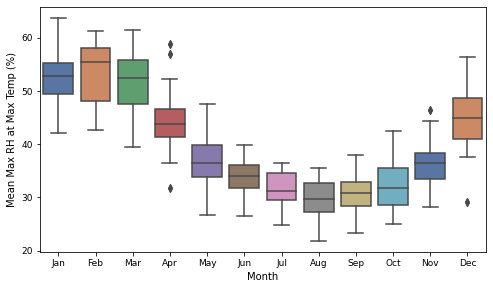

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0037_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0038.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0038_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

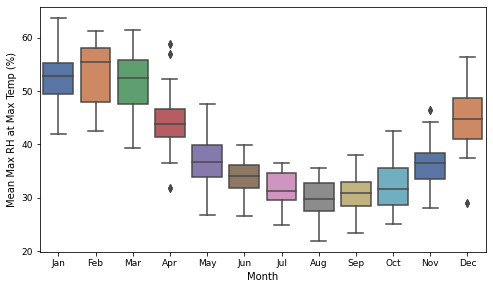

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0038_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0039.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0039_2012_1ha_rh_tmax_mean_box.jpg


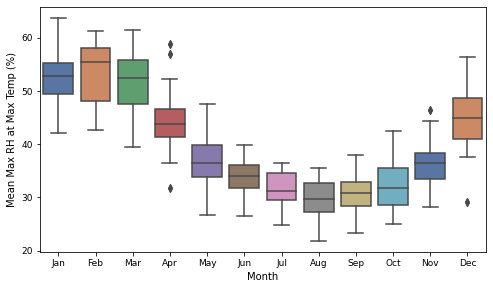

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0039_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0040.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0040_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

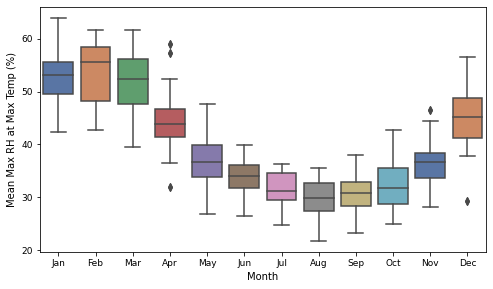

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0040_2012_1ha_rh_tmax_mean_box.jpg
ntagfu0041.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0041_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

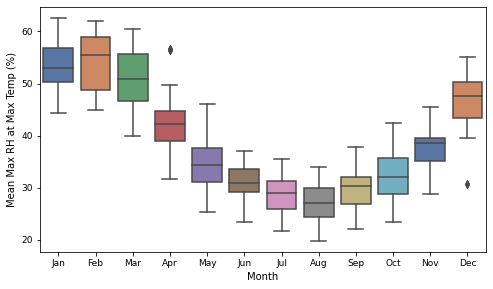

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntagfu0041_2016_1ha_rh_tmax_mean_box.jpg
ntamgd0001.2014_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0001_2014_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

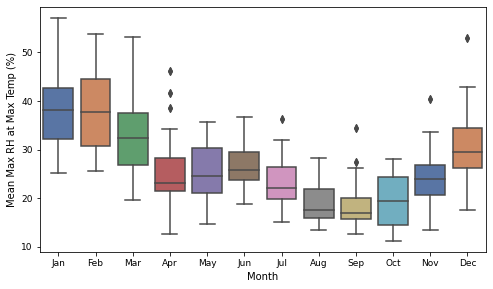

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0001_2014_1ha_rh_tmax_mean_box.jpg
ntamgd0002.2014_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0002_2014_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

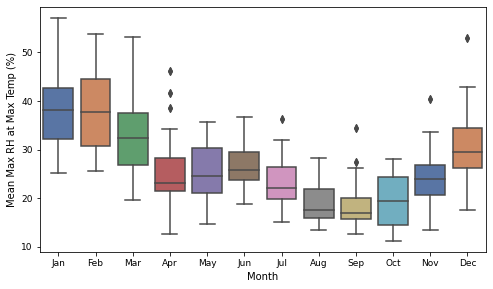

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0002_2014_1ha_rh_tmax_mean_box.jpg
ntamgd0003.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0003_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

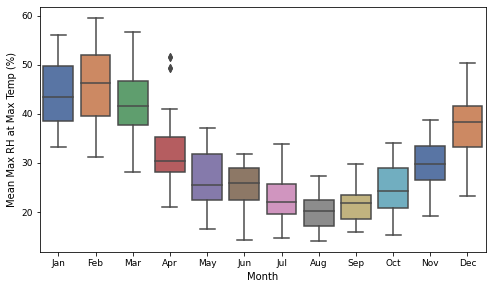

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0003_2016_1ha_rh_tmax_mean_box.jpg
ntamgd0004.2016_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0004_2016_1ha_rh_tmax_mean_box.jpg


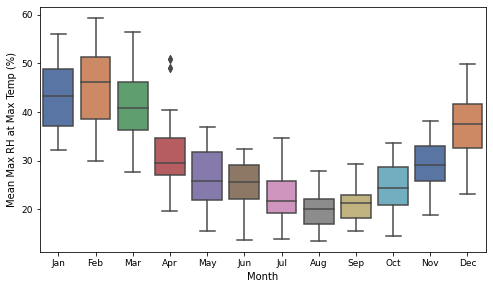

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0004_2016_1ha_rh_tmax_mean_box.jpg
ntamgd0005.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0005_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

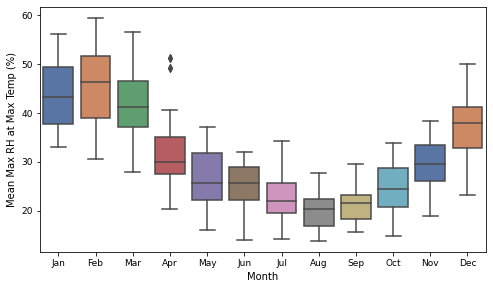

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntamgd0005_2016_1ha_rh_tmax_mean_box.jpg
ntapck0001.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntapck0001_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

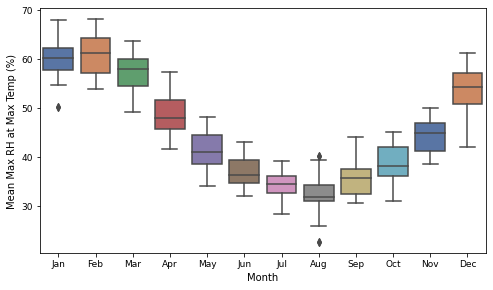

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntapck0001_2016_1ha_rh_tmax_mean_box.jpg
ntapck0002.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntapck0002_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

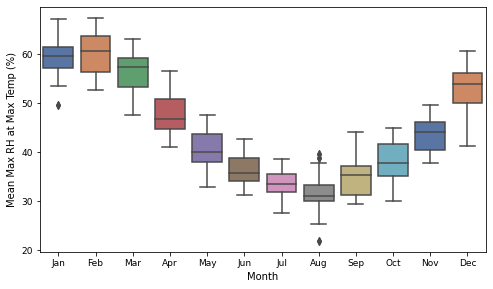

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntapck0002_2016_1ha_rh_tmax_mean_box.jpg
ntastu0001.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0001_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

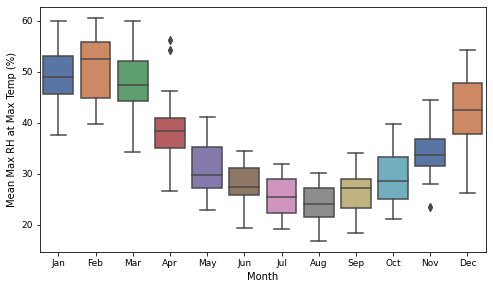

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0001_2016_1ha_rh_tmax_mean_box.jpg
ntastu0002.2016_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0002_2016_1ha_rh_tmax_mean_box.jpg


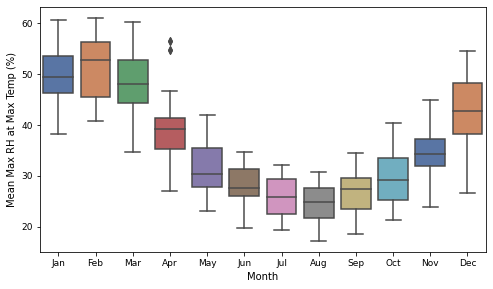

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0002_2016_1ha_rh_tmax_mean_box.jpg
ntastu0003.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0003_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

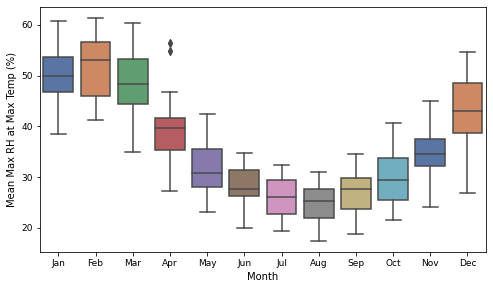

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0003_2016_1ha_rh_tmax_mean_box.jpg
ntastu0004.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0004_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

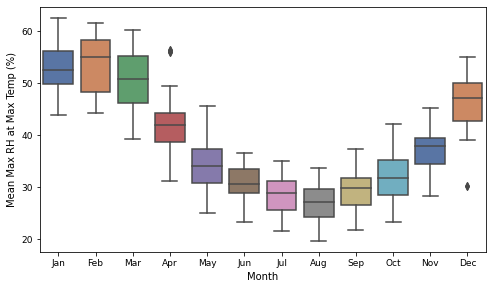

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0004_2016_1ha_rh_tmax_mean_box.jpg
ntastu0005.2016_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0005_2016_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

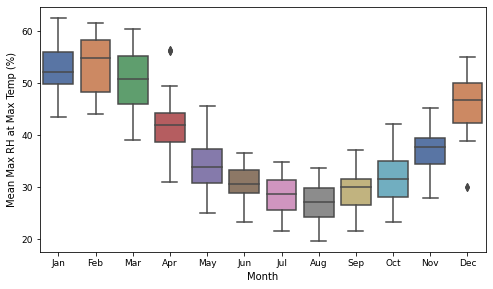

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\ntastu0005_2016_1ha_rh_tmax_mean_box.jpg
nttdab0001.2014_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttdab0001_2014_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

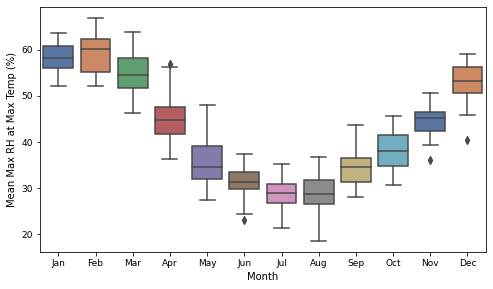

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttdab0001_2014_1ha_rh_tmax_mean_box.jpg
nttdac0001.2014_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttdac0001_2014_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

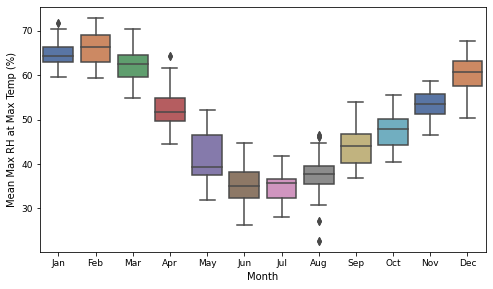

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttdac0001_2014_1ha_rh_tmax_mean_box.jpg
nttmgd0001.2014_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttmgd0001_2014_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

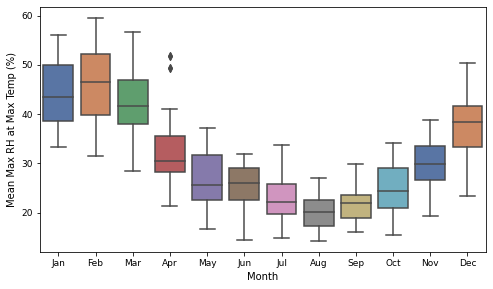

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttmgd0001_2014_1ha_rh_tmax_mean_box.jpg
nttpck0001.2014_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttpck0001_2014_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

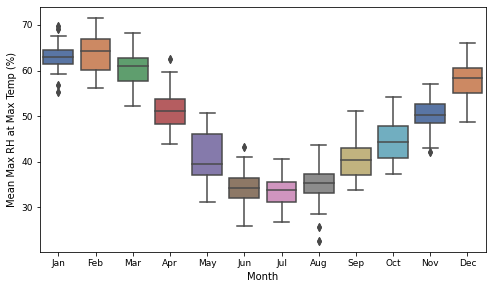

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttpck0001_2014_1ha_rh_tmax_mean_box.jpg
nttstu0001.2014_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttstu0001_2014_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

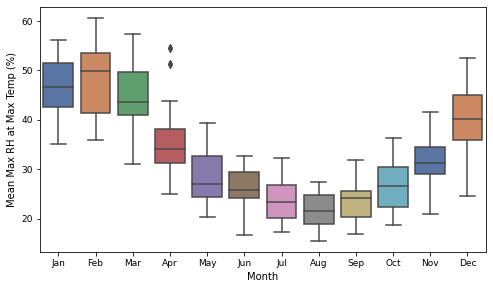

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\nttstu0001_2014_1ha_rh_tmax_mean_box.jpg
site01.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site01_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

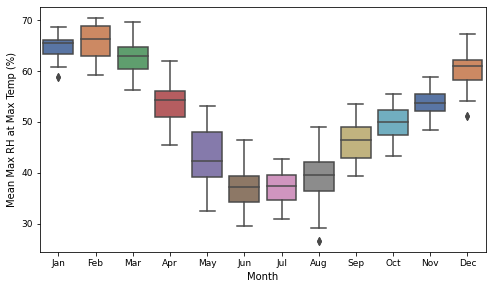

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site01_2023_1ha_rh_tmax_mean_box.jpg
site02.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site02_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

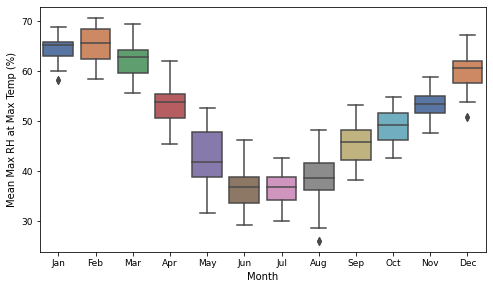

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site02_2023_1ha_rh_tmax_mean_box.jpg
site03.2023_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site03_2023_1ha_rh_tmax_mean_box.jpg


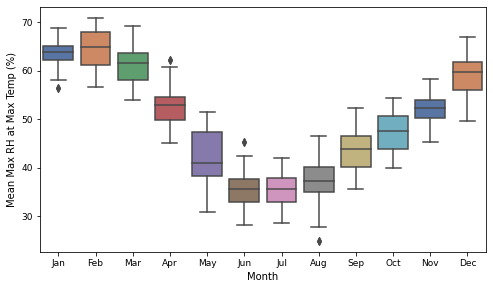

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site03_2023_1ha_rh_tmax_mean_box.jpg
site04.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site04_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

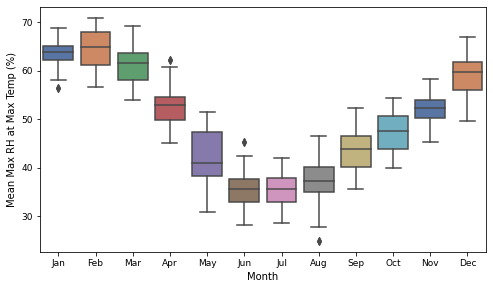

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site04_2023_1ha_rh_tmax_mean_box.jpg
site05.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site05_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

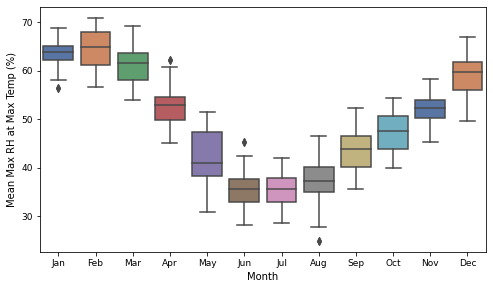

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site05_2023_1ha_rh_tmax_mean_box.jpg
site06.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site06_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

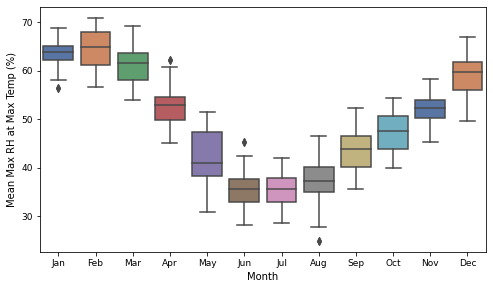

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site06_2023_1ha_rh_tmax_mean_box.jpg
site07.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site07_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

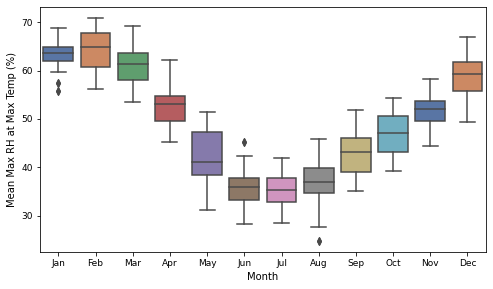

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site07_2023_1ha_rh_tmax_mean_box.jpg
site08.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site08_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

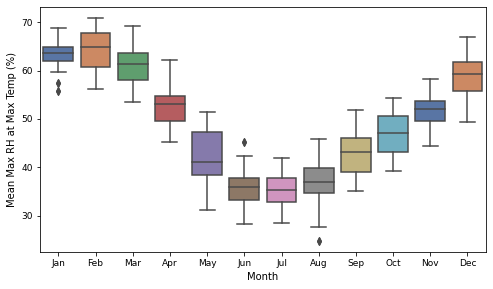

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site08_2023_1ha_rh_tmax_mean_box.jpg
site09.2023_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site09_2023_1ha_rh_tmax_mean_box.jpg


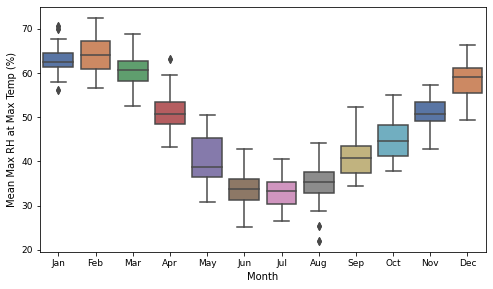

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site09_2023_1ha_rh_tmax_mean_box.jpg
site10.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site10_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

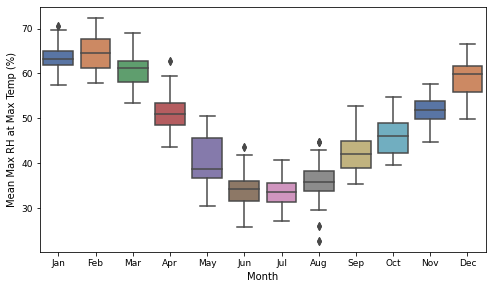

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site10_2023_1ha_rh_tmax_mean_box.jpg
site11.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site11_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

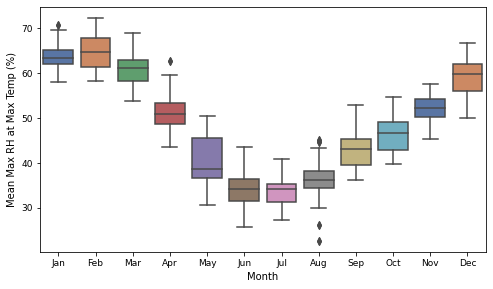

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site11_2023_1ha_rh_tmax_mean_box.jpg
site12.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site12_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

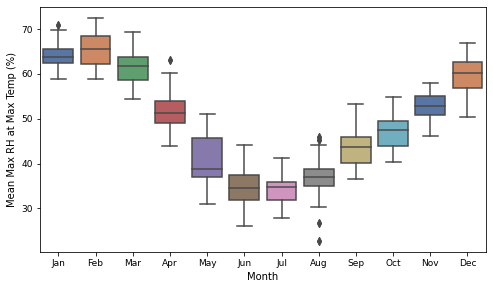

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site12_2023_1ha_rh_tmax_mean_box.jpg
site13.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site13_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

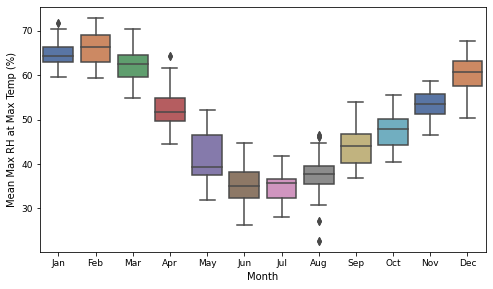

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site13_2023_1ha_rh_tmax_mean_box.jpg
site14.2023_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site14_2023_1ha_rh_tmax_mean_box.jpg


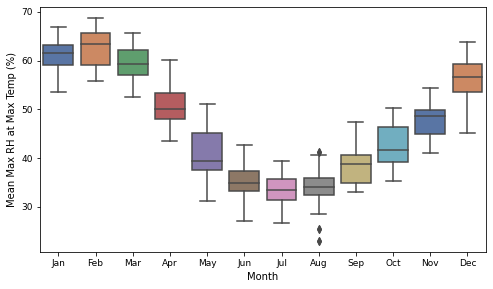

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site14_2023_1ha_rh_tmax_mean_box.jpg
site15.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site15_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

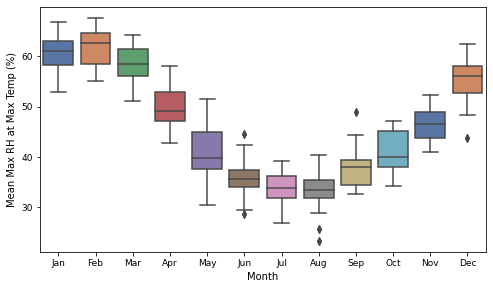

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site15_2023_1ha_rh_tmax_mean_box.jpg
site16.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site16_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

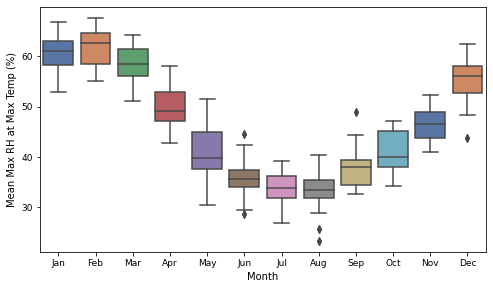

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site16_2023_1ha_rh_tmax_mean_box.jpg
site17.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site17_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

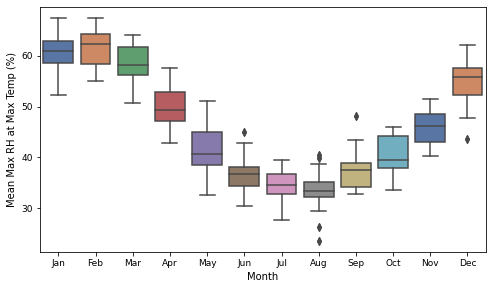

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site17_2023_1ha_rh_tmax_mean_box.jpg
site18.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site18_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

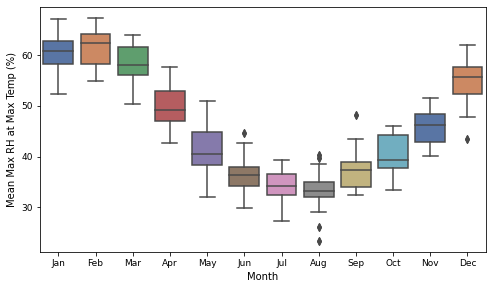

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site18_2023_1ha_rh_tmax_mean_box.jpg
site20.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site20_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

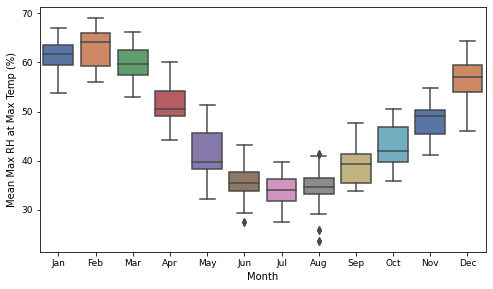

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site20_2023_1ha_rh_tmax_mean_box.jpg
site21.2023_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site21_2023_1ha_rh_tmax_mean_box.jpg


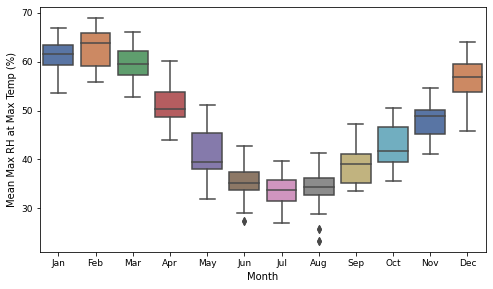

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site21_2023_1ha_rh_tmax_mean_box.jpg
site22.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site22_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

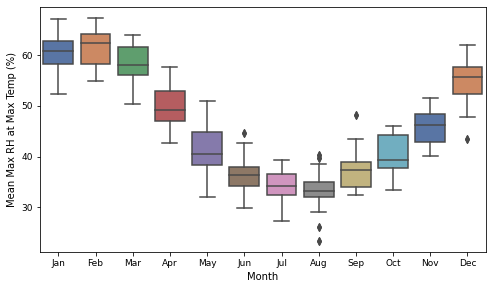

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site22_2023_1ha_rh_tmax_mean_box.jpg
site23.2023_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site23_2023_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

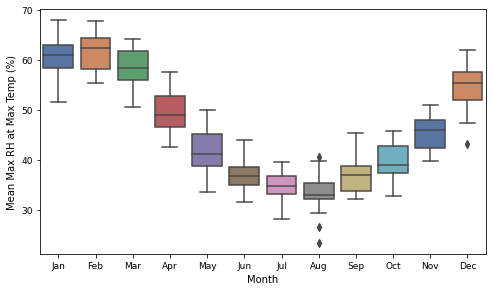

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\site23_2023_1ha_rh_tmax_mean_box.jpg
umb07.2013_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\umb07_2013_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

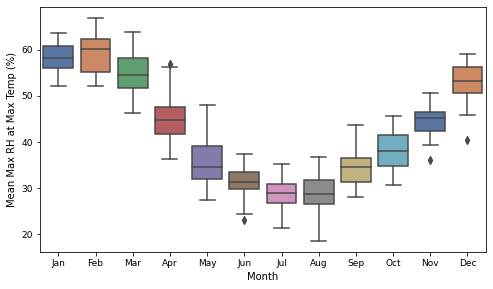

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\umb07_2013_1ha_rh_tmax_mean_box.jpg
vrd16.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd16_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

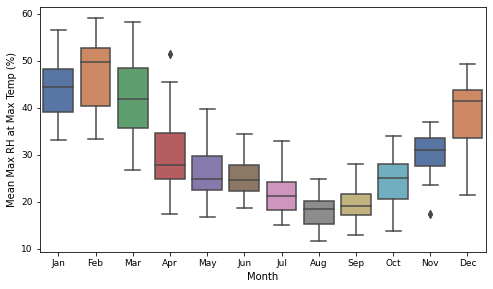

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd16_2012_1ha_rh_tmax_mean_box.jpg
vrd17.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd17_2012_1ha_rh_tmax_mean_box.jpg


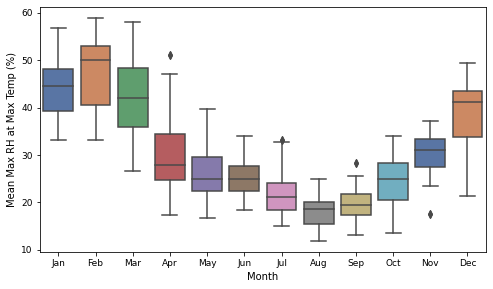

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd17_2012_1ha_rh_tmax_mean_box.jpg
vrd20.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd20_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

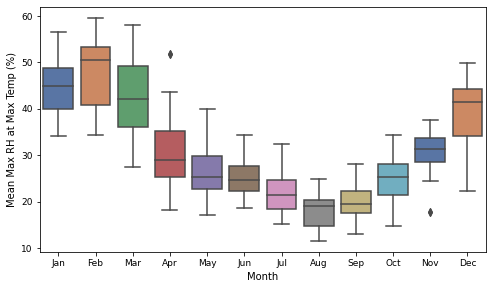

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd20_2012_1ha_rh_tmax_mean_box.jpg
vrd22.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd22_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

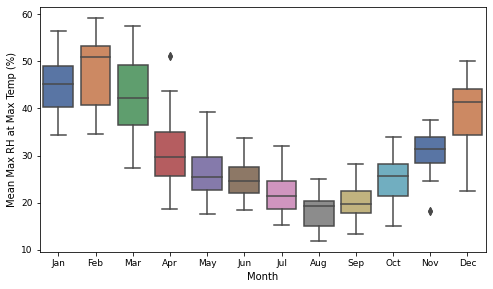

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd22_2012_1ha_rh_tmax_mean_box.jpg
vrd23.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd23_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

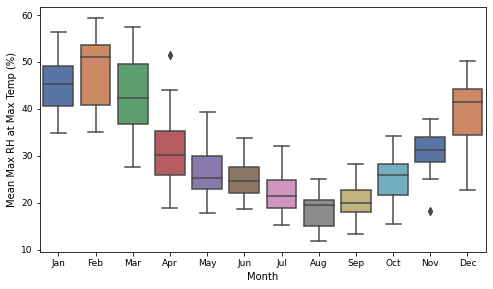

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd23_2012_1ha_rh_tmax_mean_box.jpg
vrd24.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd24_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

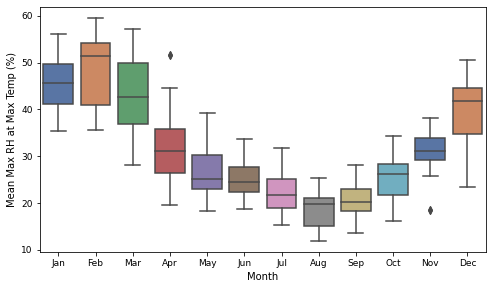

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd24_2012_1ha_rh_tmax_mean_box.jpg
vrd25.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd25_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

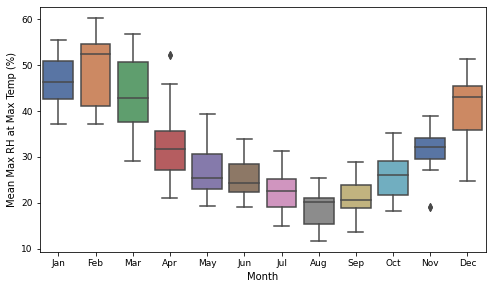

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd25_2012_1ha_rh_tmax_mean_box.jpg
vrd26.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd26_2012_1ha_rh_tmax_mean_box.jpg


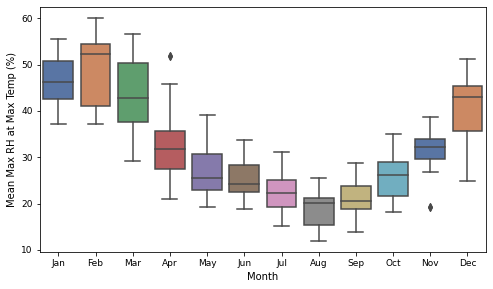

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd26_2012_1ha_rh_tmax_mean_box.jpg
vrd29.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd29_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

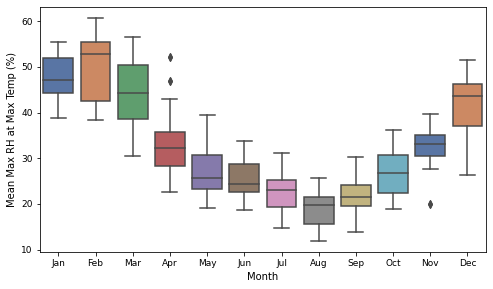

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd29_2012_1ha_rh_tmax_mean_box.jpg
vrd30.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd30_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

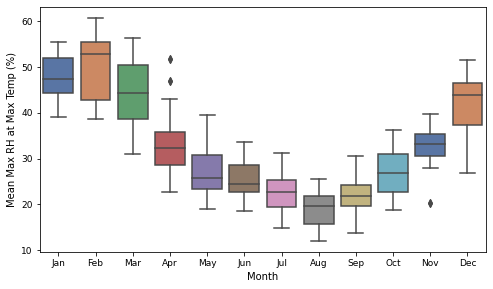

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd30_2012_1ha_rh_tmax_mean_box.jpg
vrd31.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd31_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

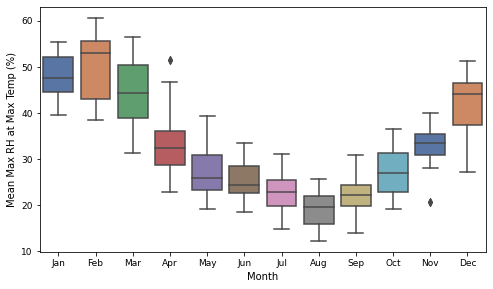

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd31_2012_1ha_rh_tmax_mean_box.jpg
vrd32.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd32_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

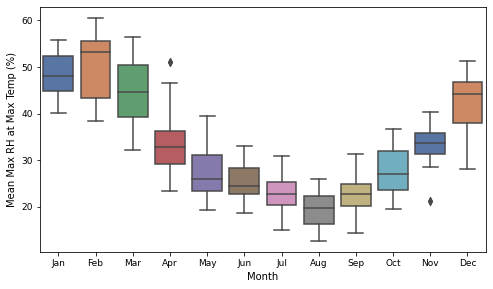

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd32_2012_1ha_rh_tmax_mean_box.jpg
vrd33.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd33_2012_1ha_rh_tmax_mean_box.jpg


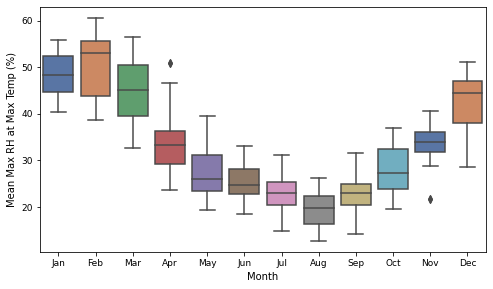

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd33_2012_1ha_rh_tmax_mean_box.jpg
vrd34.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd34_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

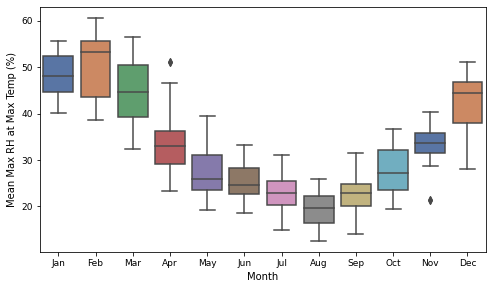

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd34_2012_1ha_rh_tmax_mean_box.jpg
vrd35.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd35_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

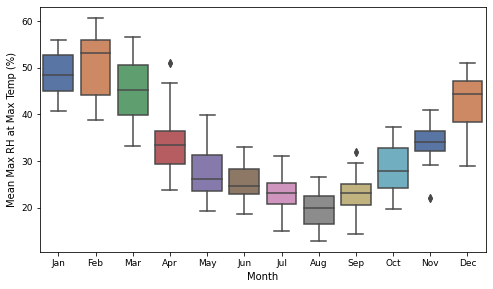

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd35_2012_1ha_rh_tmax_mean_box.jpg
vrd36.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd36_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

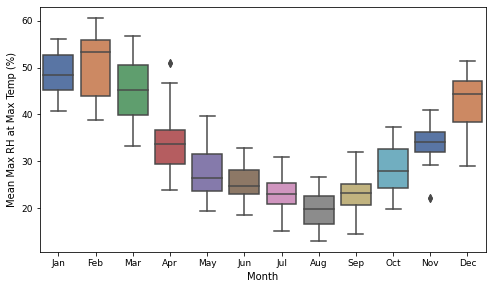

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd36_2012_1ha_rh_tmax_mean_box.jpg
vrd37.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd37_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

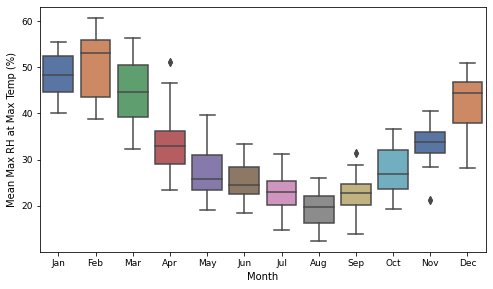

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\vrd37_2012_1ha_rh_tmax_mean_box.jpg
wedo01.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wedo01_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

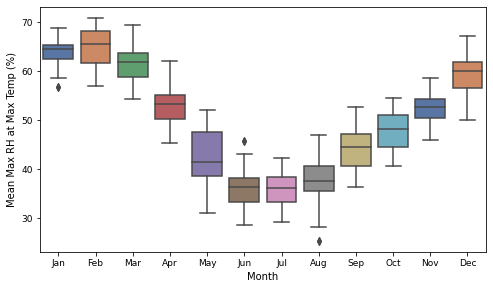

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wedo01_2012_1ha_rh_tmax_mean_box.jpg
wedo03.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wedo03_2012_1ha_rh_tmax_mean_box.jpg


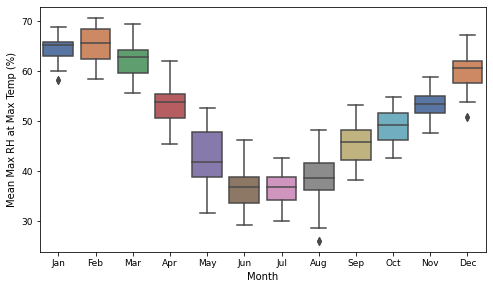

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wedo03_2012_1ha_rh_tmax_mean_box.jpg
wh02.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh02_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

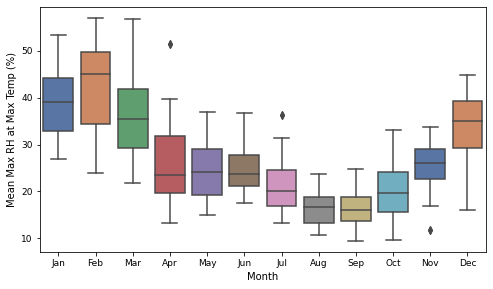

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh02_2012_1ha_rh_tmax_mean_box.jpg
wh03.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh03_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

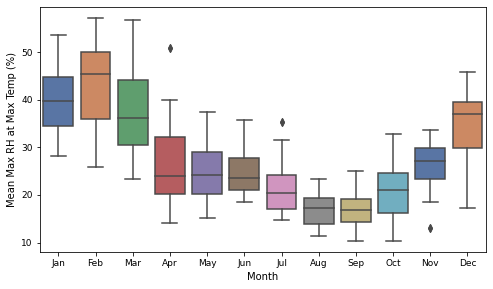

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh03_2012_1ha_rh_tmax_mean_box.jpg
wh04.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh04_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

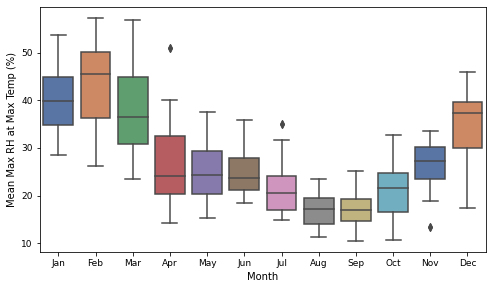

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh04_2012_1ha_rh_tmax_mean_box.jpg
wh05.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh05_2012_1ha_rh_tmax_mean_box.jpg

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

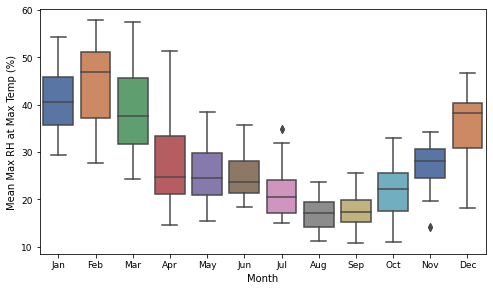

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh05_2012_1ha_rh_tmax_mean_box.jpg
wh06.2012_1ha


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh06_2012_1ha_rh_tmax_mean_box.jpg


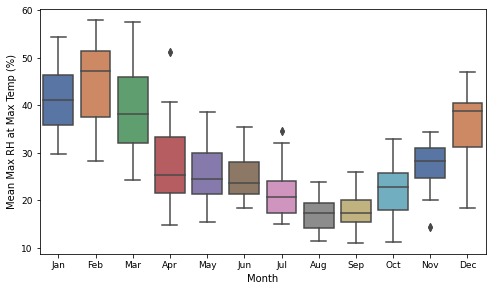

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh06_2012_1ha_rh_tmax_mean_box.jpg
wh07.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh07_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

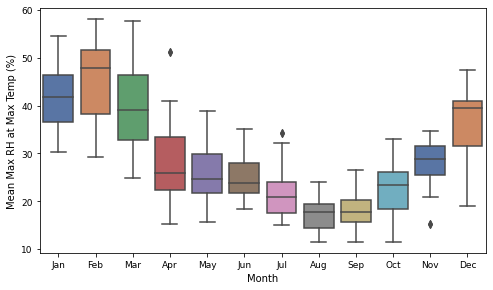

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh07_2012_1ha_rh_tmax_mean_box.jpg
wh08.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh08_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

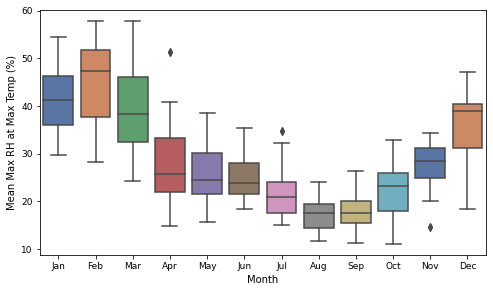

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh08_2012_1ha_rh_tmax_mean_box.jpg
wh09.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh09_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

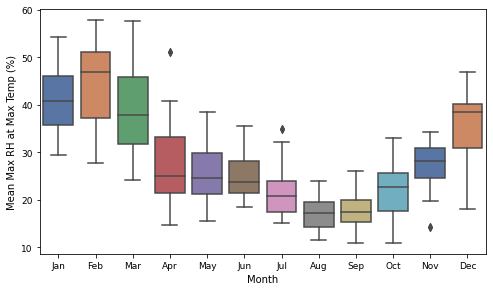

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh09_2012_1ha_rh_tmax_mean_box.jpg
wh13.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh13_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

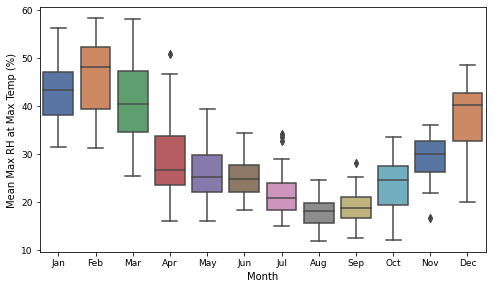

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh13_2012_1ha_rh_tmax_mean_box.jpg
wh15.2012_1ha
Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh15_2012_1ha_rh_tmax_mean_box.jpg


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

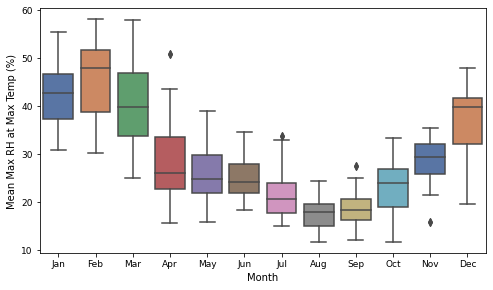

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\box_plots\mean\wh15_2012_1ha_rh_tmax_mean_box.jpg


In [34]:


# Function to change the day of the date
def change_day(date, new_day):
    # print("change day running: ")
    # print(date + pd.DateOffset(day=new_day))
    return date + pd.DateOffset(day=new_day)

# for f in glob(os.path.join(dir_, "*.csv")):
#     csv_file = f
#     print("-"*100)
#     print("working for: ", f)
    

# Combine lists of .csv files from both directories
all_files = []
for dir_path in [dir_, dir2_]:
    all_files.extend(glob(os.path.join(dir_path, "*.csv")))

# Collate all CSVs into one DataFrame
df_list = []
for csv_file in all_files:
    df = pd.read_csv(csv_file)
    df.dropna(inplace=True)
    df.drop_duplicates(inplace=True)
    df_list.append(df)

combined_df = pd.concat(df_list, ignore_index=True)
print(combined_df.head())

# Extract unique sites
unique_sites = combined_df['site'].unique()
print(unique_sites)

# Loop through unique sites for analysis and plotting
for site in unique_sites:
    site_df = combined_df[combined_df['site'] == site]
    print(site)
    site_name, field_year = site.split(".")
    # extract name and site year
    # _, f = os.path.split(csv_file)
    # flist = f.split("_")
    # print("flist: ", flist)
    # site_name, field_year = flist[0].split(".")
    # print(site_name, field_year)
    #todo may change to %Y%m%d
    site_df['date'] = pd.to_datetime(site_df['im_date'], format='%Y%m')
    site_df['day'] = 15

    # Apply the function to the DataFrame
    site_df['new_date'] = site_df.apply(lambda row: change_day(row['date'], row['day']), axis=1)
    # Extract month from new_date
    site_df['month'] = site_df['new_date'].dt.month
    site_df['year'] = site_df['new_date'].dt.year

    # Filter data to include at most 30 years
    start_year = site_df['year'].min()
    site_df = site_df[site_df['year'] <= start_year + 30]


#     # ------------------------------------------ Box Plot -----------------------------------------------

 # Mapping month numbers to month names
    month_map = {
        1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun',
        7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'
    }
    site_df['month_name'] = site_df['month'].map(month_map)

    # capitalize names
    cap_site_name = site_name.upper()
    capitalized_str_type = str_type.capitalize()


    # Count the number of unique years
    unique_years = site_df['year'].nunique()

    # Plotting
    # plt.figure(figsize=(10, 6))
    plt.figure(figsize=(8, 4.5))
    sns.boxplot(x='month_name', y='mean', data=site_df, order=list(month_map.values()), palette='deep')
    #plt.title(f'{cap_site_name} Mean Monthly {capitalized_str_type} (Data from {unique_years-1} Year{"s" if unique_years > 1 else ""})')
    plt.xlabel('Month')
    #capitalized_str_type = str_type.capitalize()
    #plt.ylabel(f'{capitalized_str_type} ({unit})')
    plt.ylabel(f'Mean {str_type} ({unit})')

    box_out = os.path.join(export_box, f"{site_name}_{field_year}_{d_type}_mean_box.jpg")
    plt.savefig(box_out)
    print(f"Exported to: {box_out}")
    plt.show()
    print(f"Exported to: {box_out}")
    plt.close()


# Time Trace

   ident            site  im_date       mean  \
0      1  agb02.2012_1ha   199301  65.670968   
1      1  agb02.2012_1ha   199302  69.400000   
2      1  agb02.2012_1ha   199303  62.777419   
3      1  agb02.2012_1ha   199304  50.676667   
4      1  agb02.2012_1ha   199305  47.316129   

                            im_name    d_type  
0  rhmax_nt_199301199301_mavga2.tif  mth_mavg  
1  rhmax_nt_199302199302_mavga2.tif  mth_mavg  
2  rhmax_nt_199303199303_mavga2.tif  mth_mavg  
3  rhmax_nt_199304199304_mavga2.tif  mth_mavg  
4  rhmax_nt_199305199305_mavga2.tif  mth_mavg  
['agb02.2012_1ha' 'amg01.2012_1ha' 'amg03.2012_1ha' 'amg05.2012_1ha'
 'amg06.2012_1ha' 'amg08.2012_1ha' 'amg10.2012_1ha' 'ant01.2012_1ha'
 'ant02.2012_1ha' 'ant03.2012_1ha' 'ant04.2012_1ha' 'ant06.2012_1ha'
 'ant07.2012_1ha' 'ant09.2012_1ha' 'antgr01.2012_1ha' 'auv01.2012_1ha'
 'auv02.2012_1ha' 'auv03.2012_1ha' 'auv05.2012_1ha' 'auv06.2012_1ha'
 'auv07.2012_1ha' 'auv08.2012_1ha' 'auv09.2012_1ha' 'barkely01.2011_1ha'
 'b

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

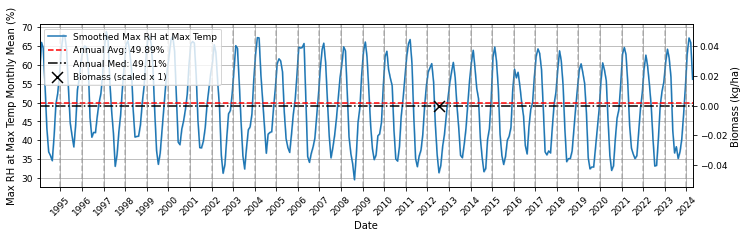

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\agb02_2012_1ha_rh_tmax_mean_line.jpg
amg01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: amg01
(1, 24)
Event dates: ['2012-06-19T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

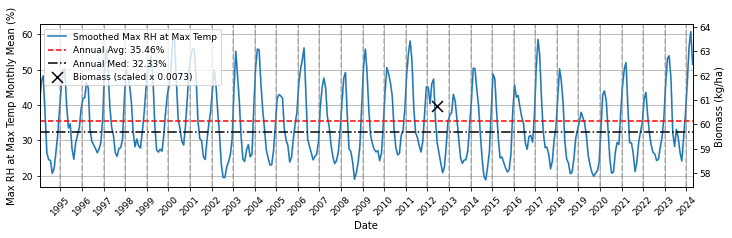

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\amg01_2012_1ha_rh_tmax_mean_line.jpg
amg03.2012_1ha
site_df shape:  (752, 6)
filtering biomass: amg03
(1, 24)
Event dates: ['2012-06-20T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

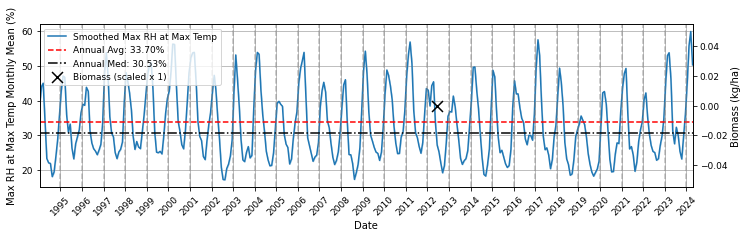

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\amg03_2012_1ha_rh_tmax_mean_line.jpg
amg05.2012_1ha
site_df shape:  (752, 6)
filtering biomass: amg05
(1, 24)
Event dates: ['2012-06-21T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

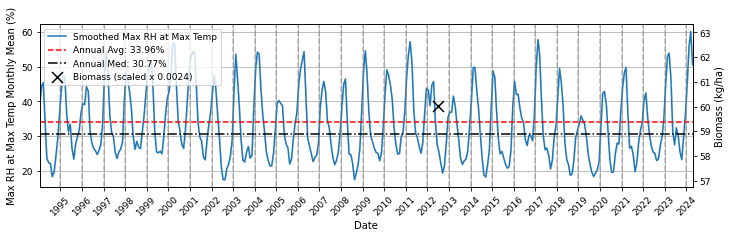

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\amg05_2012_1ha_rh_tmax_mean_line.jpg
amg06.2012_1ha
site_df shape:  (752, 6)
filtering biomass: amg06
(1, 24)
Event dates: ['2012-06-21T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

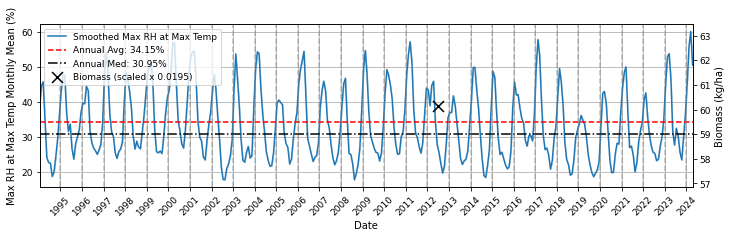

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\amg06_2012_1ha_rh_tmax_mean_line.jpg
amg08.2012_1ha
site_df shape:  (752, 6)
filtering biomass: amg08
(1, 24)
Event dates: ['2012-06-22T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

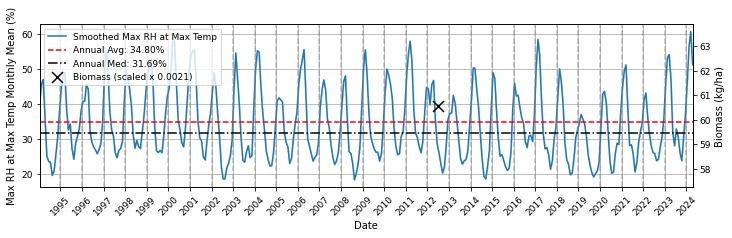

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\amg08_2012_1ha_rh_tmax_mean_line.jpg
amg10.2012_1ha
site_df shape:  (752, 6)
filtering biomass: amg10
(1, 24)
Event dates: ['2012-06-22T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

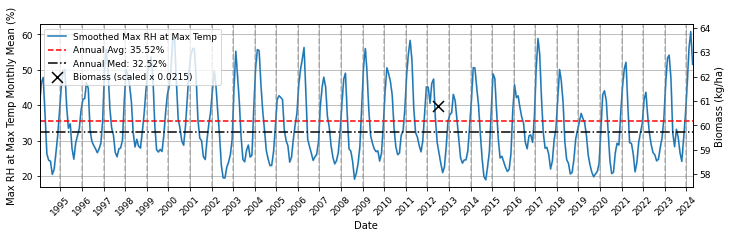

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\amg10_2012_1ha_rh_tmax_mean_line.jpg
ant01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ant01
(1, 24)
Event dates: ['2012-06-23T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

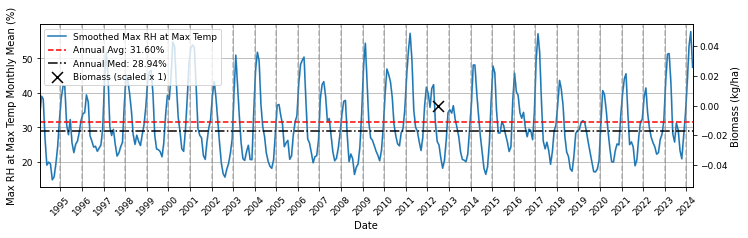

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ant01_2012_1ha_rh_tmax_mean_line.jpg
ant02.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ant02
(1, 24)
Event dates: ['2012-06-24T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

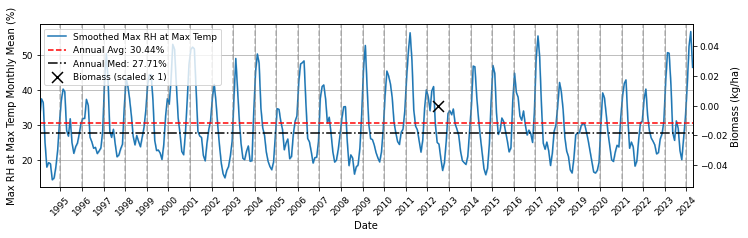

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ant02_2012_1ha_rh_tmax_mean_line.jpg
ant03.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ant03
(1, 24)
Event dates: ['2012-06-24T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

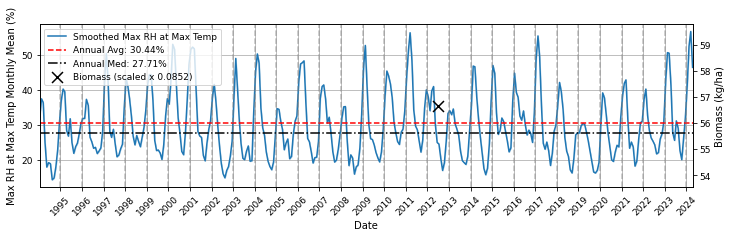

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ant03_2012_1ha_rh_tmax_mean_line.jpg
ant04.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ant04
(1, 24)
Event dates: ['2012-06-24T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

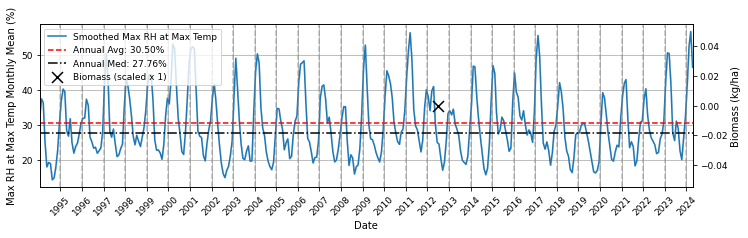

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ant04_2012_1ha_rh_tmax_mean_line.jpg
ant06.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ant06
(1, 24)
Event dates: ['2012-06-25T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

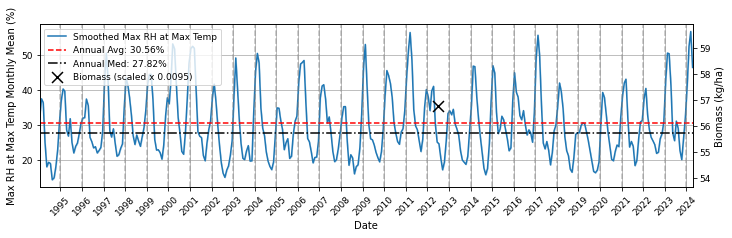

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ant06_2012_1ha_rh_tmax_mean_line.jpg
ant07.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ant07
(1, 24)
Event dates: ['2012-06-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

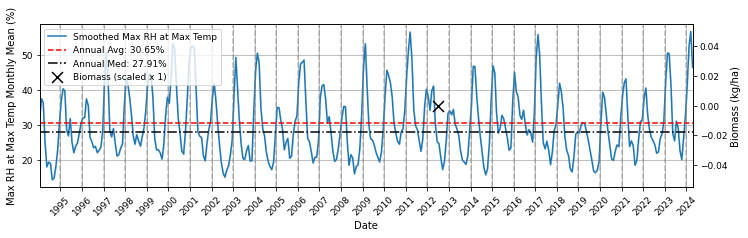

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ant07_2012_1ha_rh_tmax_mean_line.jpg
ant09.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ant09
(1, 24)
Event dates: ['2012-06-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

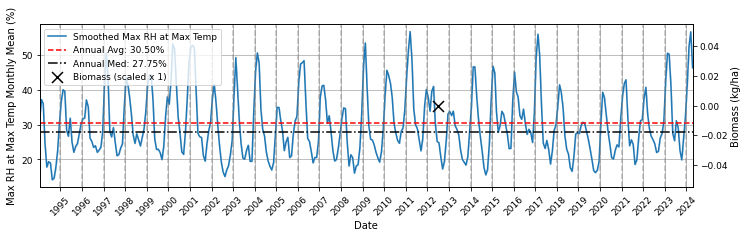

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ant09_2012_1ha_rh_tmax_mean_line.jpg
antgr01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: antgr01
(1, 24)
Event dates: ['2012-06-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

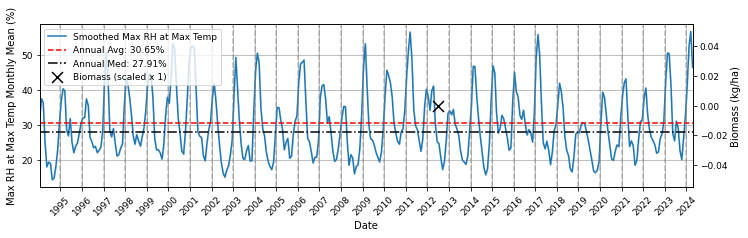

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\antgr01_2012_1ha_rh_tmax_mean_line.jpg
auv01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: auv01
(1, 24)
Event dates: ['2012-10-09T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

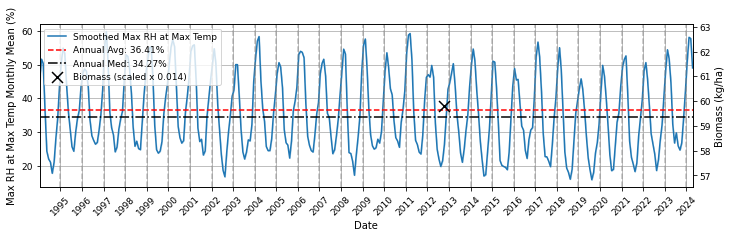

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\auv01_2012_1ha_rh_tmax_mean_line.jpg
auv02.2012_1ha
site_df shape:  (752, 6)
filtering biomass: auv02
(1, 24)
Event dates: ['2012-10-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

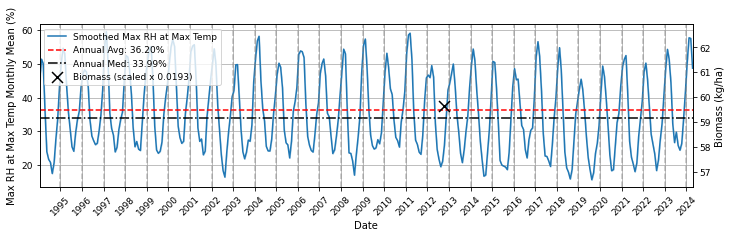

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\auv02_2012_1ha_rh_tmax_mean_line.jpg
auv03.2012_1ha
site_df shape:  (752, 6)
filtering biomass: auv03
(1, 24)
Event dates: ['2012-10-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

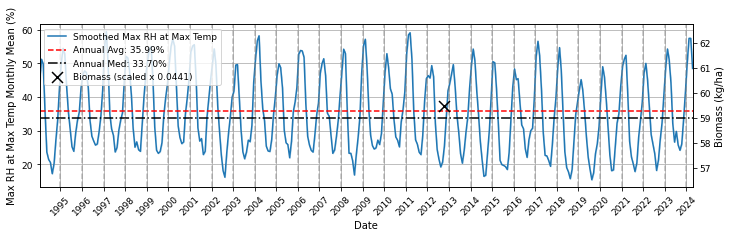

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\auv03_2012_1ha_rh_tmax_mean_line.jpg
auv05.2012_1ha
site_df shape:  (752, 6)
filtering biomass: auv05
(1, 24)
Event dates: ['2012-10-11T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

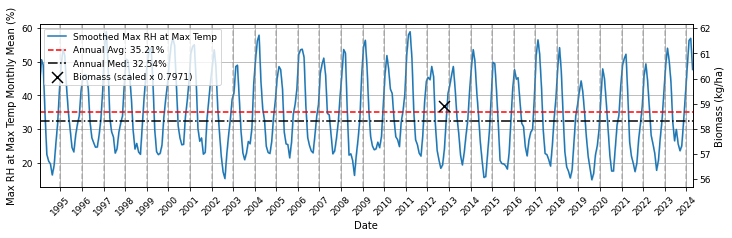

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\auv05_2012_1ha_rh_tmax_mean_line.jpg
auv06.2012_1ha
site_df shape:  (752, 6)
filtering biomass: auv06
(1, 24)
Event dates: ['2012-10-11T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

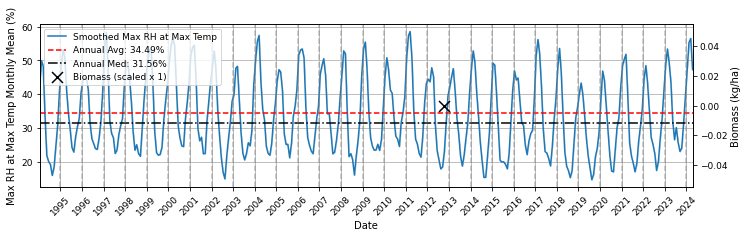

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\auv06_2012_1ha_rh_tmax_mean_line.jpg
auv07.2012_1ha
site_df shape:  (752, 6)
filtering biomass: auv07
(1, 24)
Event dates: ['2012-10-11T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

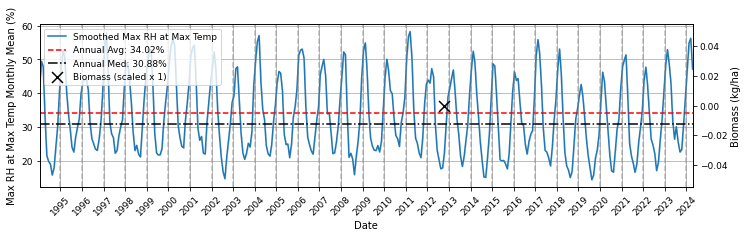

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\auv07_2012_1ha_rh_tmax_mean_line.jpg
auv08.2012_1ha
site_df shape:  (752, 6)
filtering biomass: auv08
(1, 24)
Event dates: ['2012-10-11T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

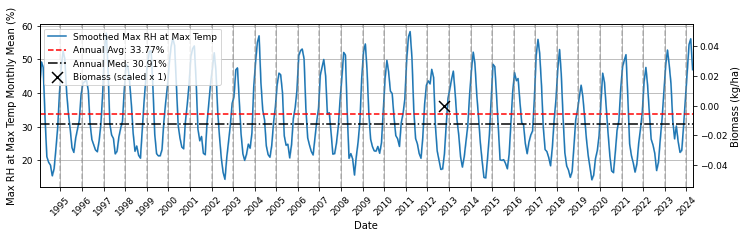

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\auv08_2012_1ha_rh_tmax_mean_line.jpg
auv09.2012_1ha
site_df shape:  (752, 6)
filtering biomass: auv09
(1, 24)
Event dates: ['2012-10-11T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

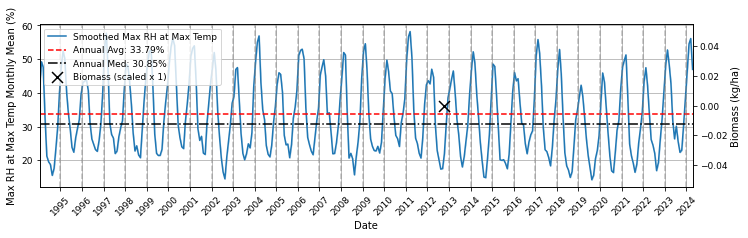

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\auv09_2012_1ha_rh_tmax_mean_line.jpg
barkely01.2011_1ha
site_df shape:  (752, 6)
filtering biomass: barkely01
(1, 24)
Event dates: ['2011-10-25T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

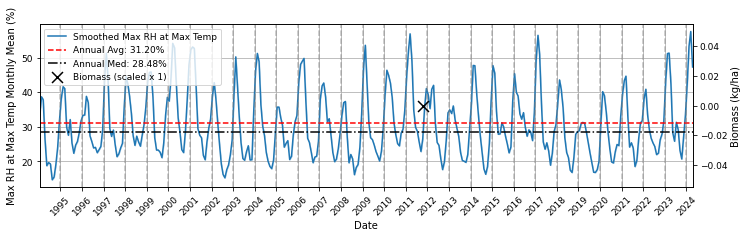

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\barkely01_2011_1ha_rh_tmax_mean_line.jpg
barkely02.2011_1ha
site_df shape:  (752, 6)
filtering biomass: barkely02
(1, 24)
Event dates: ['2011-10-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

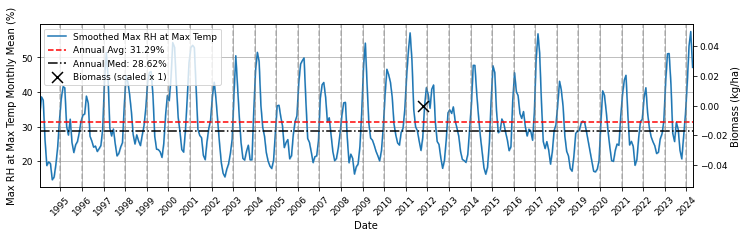

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\barkely02_2011_1ha_rh_tmax_mean_line.jpg
barkely03.2011_1ha
site_df shape:  (752, 6)
filtering biomass: barkely03
(1, 24)
Event dates: ['2011-10-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

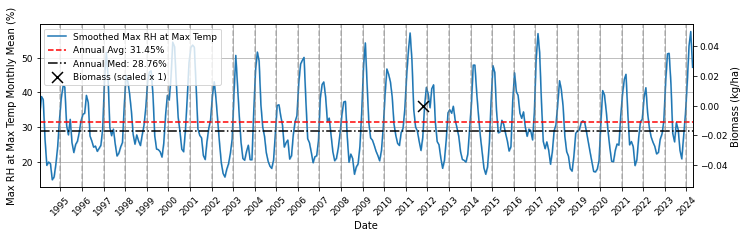

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\barkely03_2011_1ha_rh_tmax_mean_line.jpg
barkely04.2011_1ha
site_df shape:  (752, 6)
filtering biomass: barkely04
(1, 24)
Event dates: ['2011-10-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

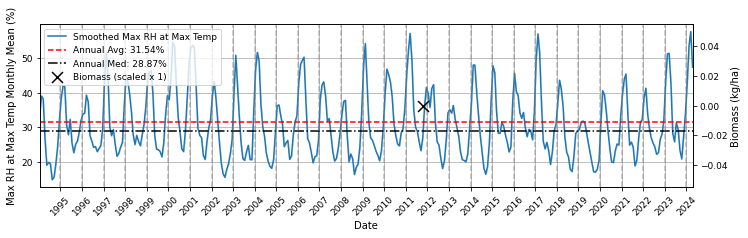

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\barkely04_2011_1ha_rh_tmax_mean_line.jpg
barkely05.2011_1ha
site_df shape:  (752, 6)
filtering biomass: barkely05
(1, 24)
Event dates: ['2011-10-27T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

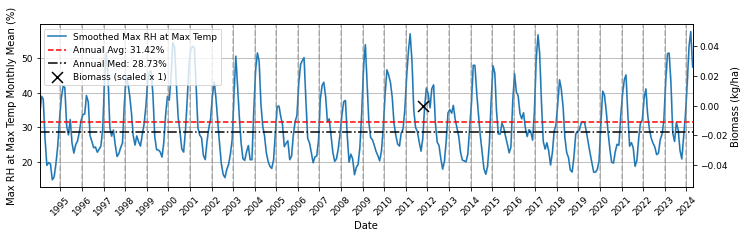

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\barkely05_2011_1ha_rh_tmax_mean_line.jpg
barkely06.2011_1ha
site_df shape:  (752, 6)
filtering biomass: barkely06
(1, 24)
Event dates: ['2011-10-27T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

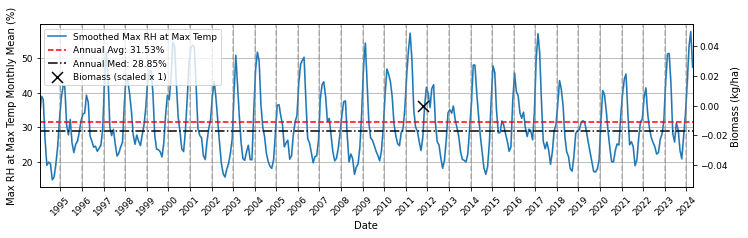

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\barkely06_2011_1ha_rh_tmax_mean_line.jpg
barkely07.2011_1ha
site_df shape:  (752, 6)
filtering biomass: barkely07
(1, 24)
Event dates: ['2011-10-27T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

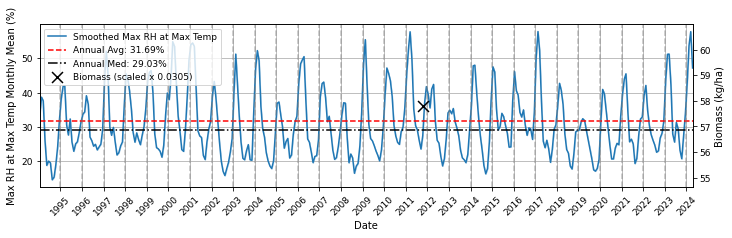

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\barkely07_2011_1ha_rh_tmax_mean_line.jpg
bc101.2024_1ha
site_df shape:  (752, 6)
filtering biomass: bc101
(1, 24)
Event dates: ['2024-05-24T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

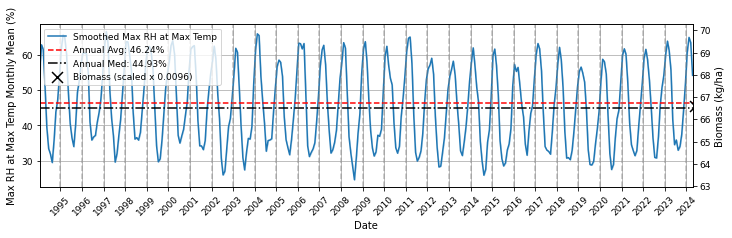

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\bc101_2024_1ha_rh_tmax_mean_line.jpg
buff01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: buff01
(1, 24)
Event dates: ['2012-07-13T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

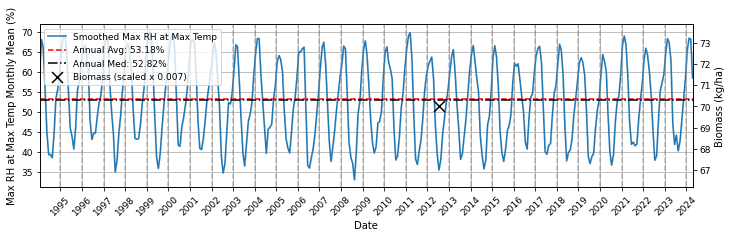

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\buff01_2012_1ha_rh_tmax_mean_line.jpg
centa13.2013_1ha
site_df shape:  (752, 6)
filtering biomass: centa13
(1, 24)
Event dates: ['2013-06-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

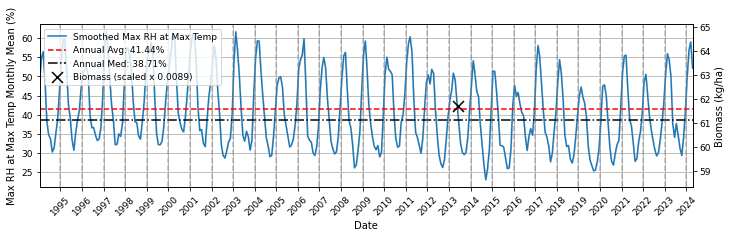

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\centa13_2013_1ha_rh_tmax_mean_line.jpg
centa14.2012_1ha
site_df shape:  (752, 6)
filtering biomass: centa14
(1, 24)
Event dates: ['2012-06-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

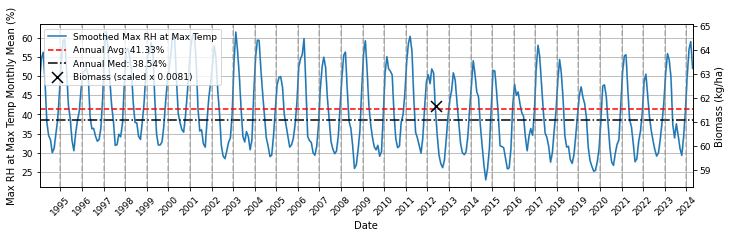

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\centa14_2012_1ha_rh_tmax_mean_line.jpg
cpr01.2024_1ha
site_df shape:  (752, 6)
filtering biomass: cpr01
(1, 24)
Event dates: ['2024-06-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

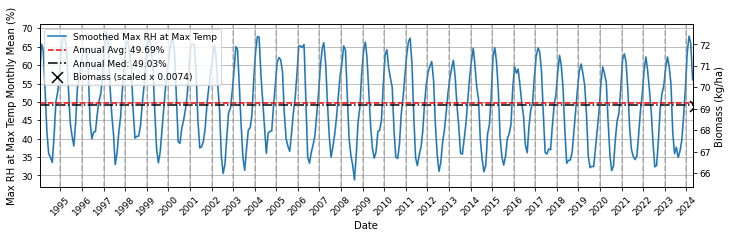

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\cpr01_2024_1ha_rh_tmax_mean_line.jpg
cpr02.2024_1ha
site_df shape:  (752, 6)
filtering biomass: cpr02
(1, 24)
Event dates: ['2024-06-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

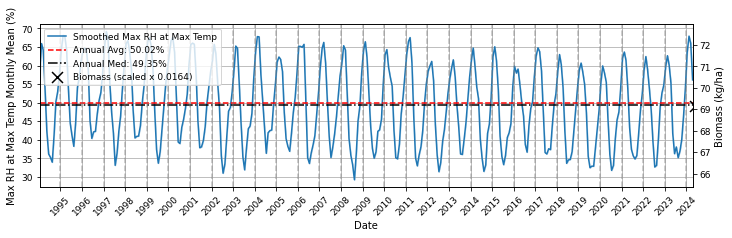

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\cpr02_2024_1ha_rh_tmax_mean_line.jpg
cpr03.2024_1ha
site_df shape:  (752, 6)
filtering biomass: cpr03
(1, 24)
Event dates: ['2024-06-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

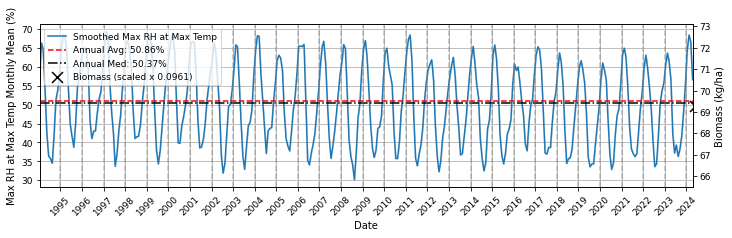

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\cpr03_2024_1ha_rh_tmax_mean_line.jpg
cpr04.2024_1ha
site_df shape:  (752, 6)
filtering biomass: cpr04
(1, 24)
Event dates: ['2024-06-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

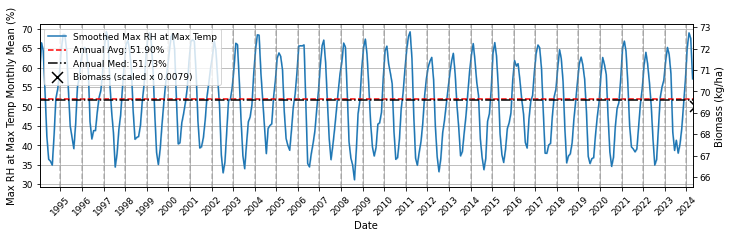

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\cpr04_2024_1ha_rh_tmax_mean_line.jpg
el01.2013_1ha
site_df shape:  (752, 6)
filtering biomass: el01
(1, 24)
Event dates: ['2013-04-13T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

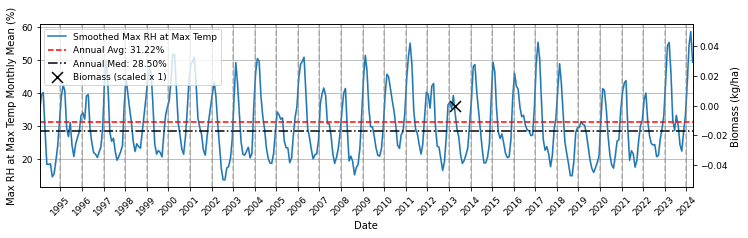

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\el01_2013_1ha_rh_tmax_mean_line.jpg
el02.2013_1ha
site_df shape:  (752, 6)
filtering biomass: el02
(1, 24)
Event dates: ['2013-04-14T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

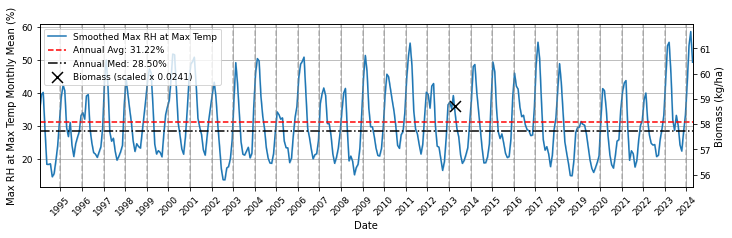

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\el02_2013_1ha_rh_tmax_mean_line.jpg
ep01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ep01
(1, 24)
Event dates: ['2012-07-13T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

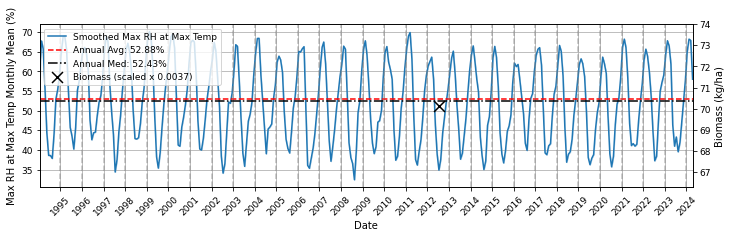

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ep01_2012_1ha_rh_tmax_mean_line.jpg
fin101.2024_1ha
site_df shape:  (752, 6)
filtering biomass: fin101
(1, 24)
Event dates: ['2024-05-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

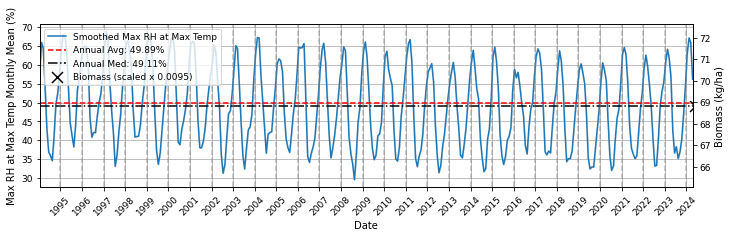

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\fin101_2024_1ha_rh_tmax_mean_line.jpg
fin102.2024_1ha
site_df shape:  (752, 6)
filtering biomass: fin102
(1, 24)
Event dates: ['2024-05-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

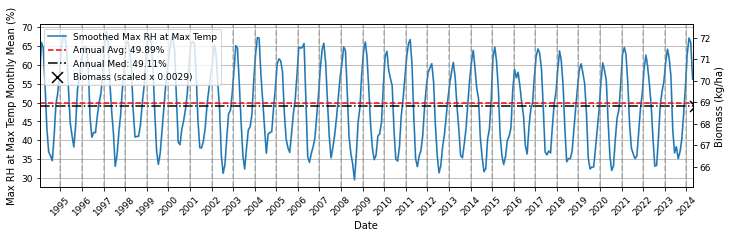

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\fin102_2024_1ha_rh_tmax_mean_line.jpg
girra01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: girra01
(1, 24)
Event dates: ['2012-06-05T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

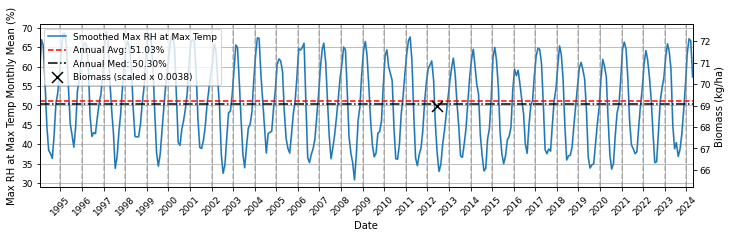

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\girra01_2012_1ha_rh_tmax_mean_line.jpg
girra02.2012_1ha
site_df shape:  (752, 6)
filtering biomass: girra02
(1, 24)
Event dates: ['2012-06-05T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

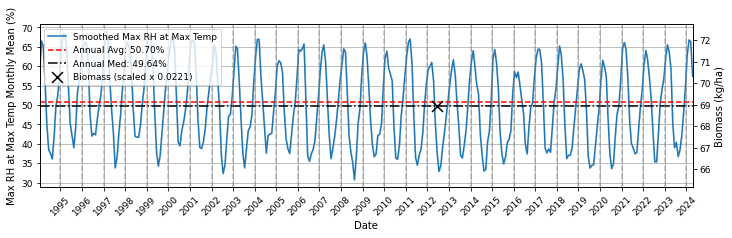

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\girra02_2012_1ha_rh_tmax_mean_line.jpg
gulf10.2013_1ha
site_df shape:  (752, 6)
filtering biomass: gulf10
(1, 24)
Event dates: ['2013-07-16T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

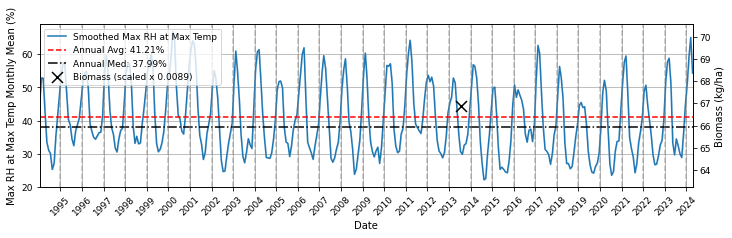

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\gulf10_2013_1ha_rh_tmax_mean_line.jpg
gulf11.2013_1ha
site_df shape:  (752, 6)
filtering biomass: gulf11
(1, 24)
Event dates: ['2013-07-16T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

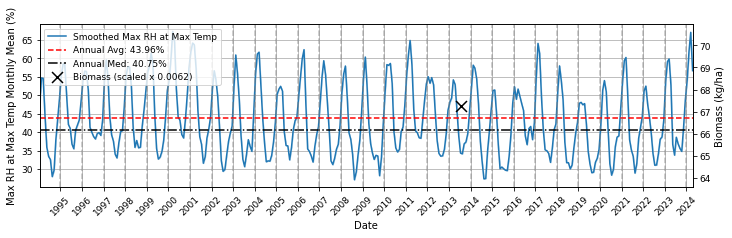

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\gulf11_2013_1ha_rh_tmax_mean_line.jpg
gulf12.2013_1ha
site_df shape:  (752, 6)
filtering biomass: gulf12
(1, 24)
Event dates: ['2013-07-16T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

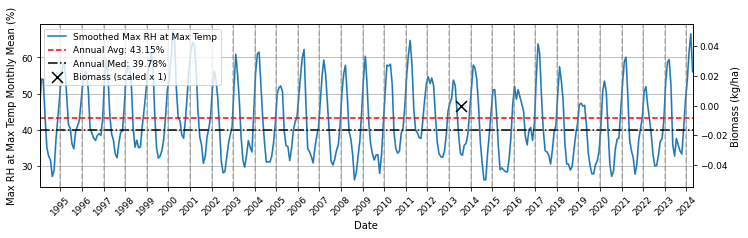

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\gulf12_2013_1ha_rh_tmax_mean_line.jpg
hsf01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: hsf01
(1, 24)
Event dates: ['2012-07-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

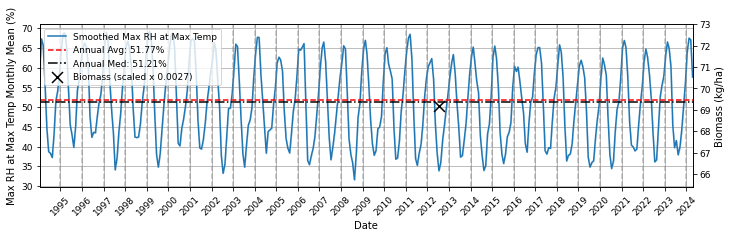

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\hsf01_2012_1ha_rh_tmax_mean_line.jpg
hsf02.2012_1ha
site_df shape:  (752, 6)
filtering biomass: hsf02
(1, 24)
Event dates: ['2012-07-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

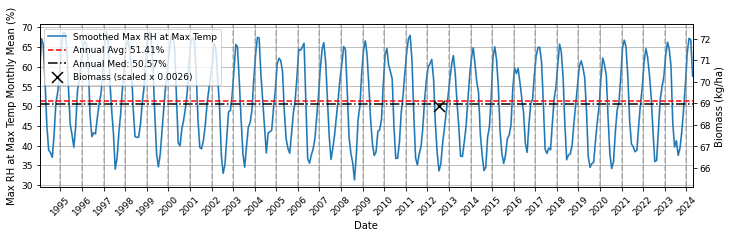

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\hsf02_2012_1ha_rh_tmax_mean_line.jpg
hshr01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: hshr01
(1, 24)
Event dates: ['2012-06-06T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

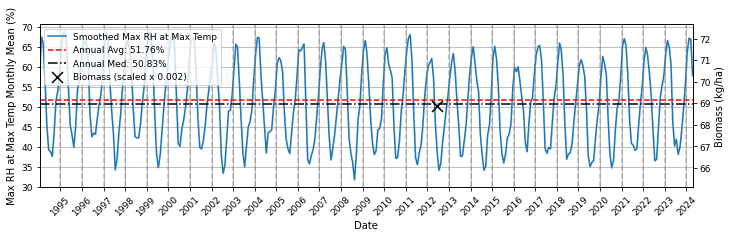

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\hshr01_2012_1ha_rh_tmax_mean_line.jpg
jdr01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: jdr01
(1, 24)
Event dates: ['2012-05-22T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

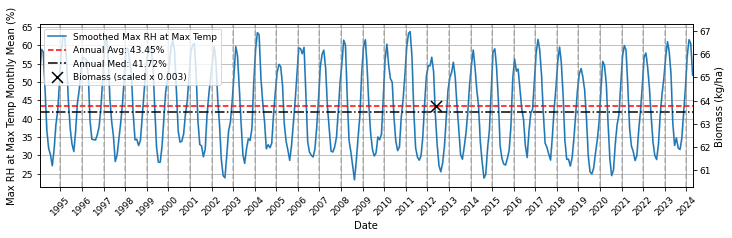

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\jdr01_2012_1ha_rh_tmax_mean_line.jpg
jdr02.2012_1ha
site_df shape:  (752, 6)
filtering biomass: jdr02
(1, 24)
Event dates: ['2012-05-23T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

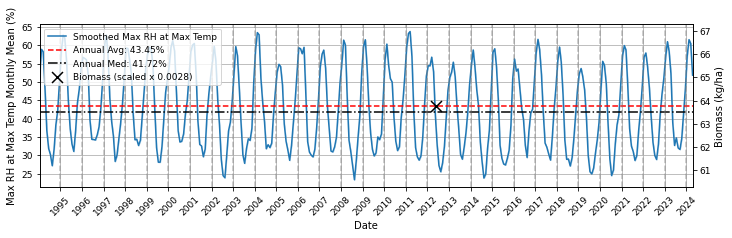

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\jdr02_2012_1ha_rh_tmax_mean_line.jpg
jdr03.2012_1ha
site_df shape:  (752, 6)
filtering biomass: jdr03
(1, 24)
Event dates: ['2012-05-23T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

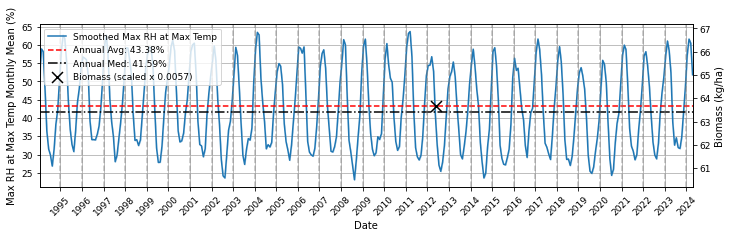

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\jdr03_2012_1ha_rh_tmax_mean_line.jpg
jdr04.2012_1ha
site_df shape:  (752, 6)
filtering biomass: jdr04
(1, 24)
Event dates: ['2012-05-23T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

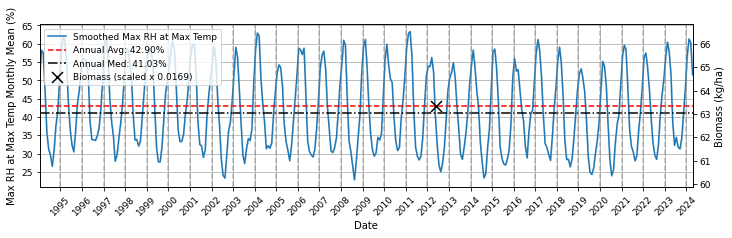

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\jdr04_2012_1ha_rh_tmax_mean_line.jpg
jdr05.2012_1ha
site_df shape:  (752, 6)
filtering biomass: jdr05
(1, 24)
Event dates: ['2012-05-24T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

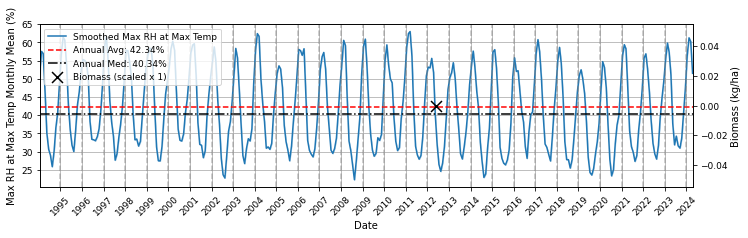

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\jdr05_2012_1ha_rh_tmax_mean_line.jpg
jnk101.2024_1ha
site_df shape:  (752, 6)
filtering biomass: jnk101
(1, 24)
Event dates: ['2024-05-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

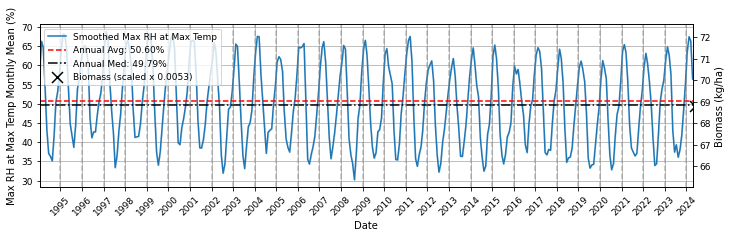

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\jnk101_2024_1ha_rh_tmax_mean_line.jpg
jnk102.2024_1ha
site_df shape:  (752, 6)
filtering biomass: jnk102
(1, 24)
Event dates: ['2024-05-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

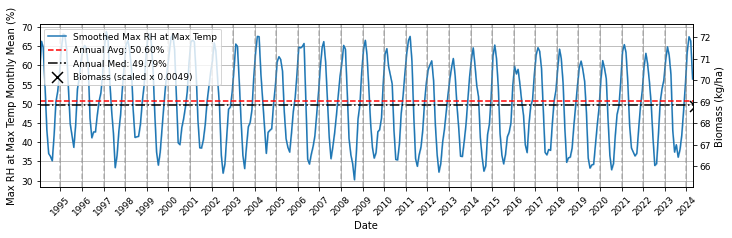

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\jnk102_2024_1ha_rh_tmax_mean_line.jpg
jnk103.2024_1ha
site_df shape:  (752, 6)
filtering biomass: jnk103
(1, 24)
Event dates: ['2024-05-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

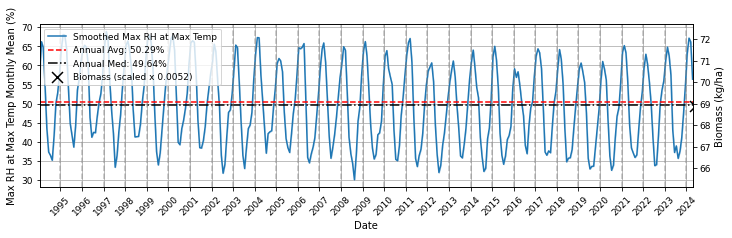

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\jnk103_2024_1ha_rh_tmax_mean_line.jpg
larr15.2013_1ha
site_df shape:  (752, 6)
filtering biomass: larr15
(1, 24)
Event dates: ['2013-05-31T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

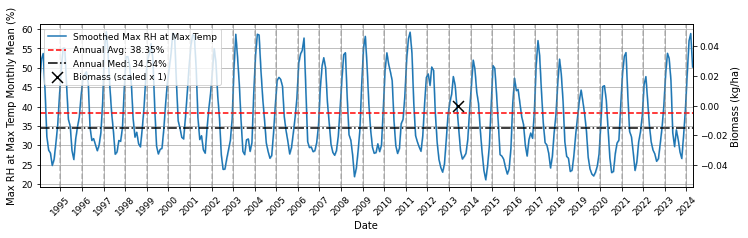

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\larr15_2013_1ha_rh_tmax_mean_line.jpg
legu01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: legu01
(1, 24)
Event dates: ['2012-10-05T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

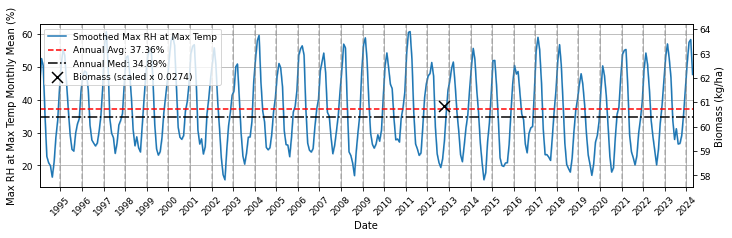

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\legu01_2012_1ha_rh_tmax_mean_line.jpg
legu02.2012_1ha
site_df shape:  (752, 6)
filtering biomass: legu02
(1, 24)
Event dates: ['2012-10-05T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

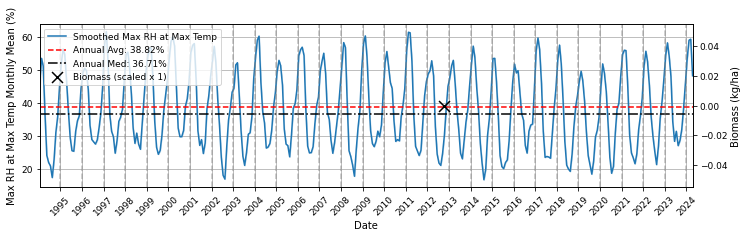

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\legu02_2012_1ha_rh_tmax_mean_line.jpg
legu03.2012_1ha
site_df shape:  (752, 6)
filtering biomass: legu03
(1, 24)
Event dates: ['2012-10-06T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

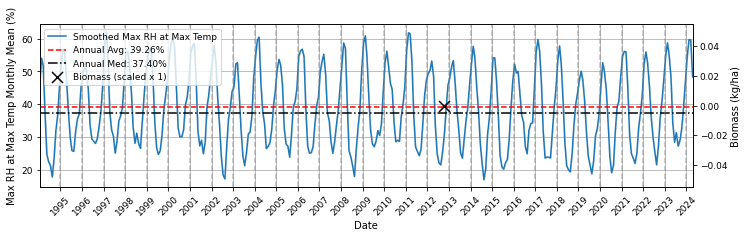

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\legu03_2012_1ha_rh_tmax_mean_line.jpg
legu04.2012_1ha
site_df shape:  (752, 6)
filtering biomass: legu04
(1, 24)
Event dates: ['2012-10-07T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

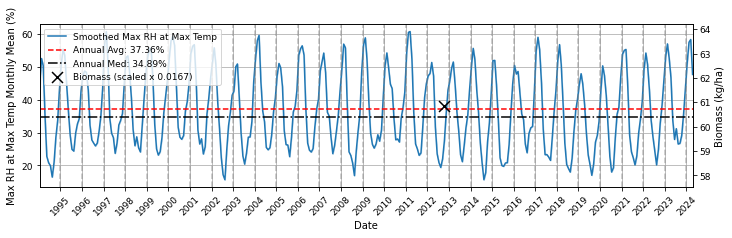

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\legu04_2012_1ha_rh_tmax_mean_line.jpg
legu05.2012_1ha
site_df shape:  (752, 6)
filtering biomass: legu05
(1, 24)
Event dates: ['2012-10-07T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

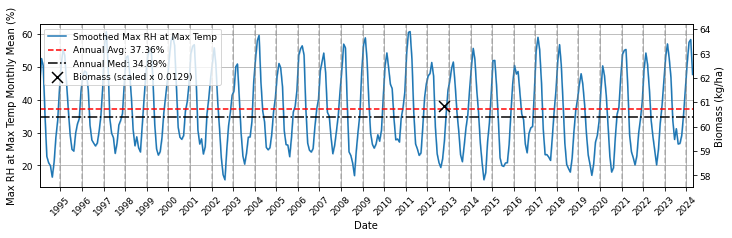

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\legu05_2012_1ha_rh_tmax_mean_line.jpg
legu06.2012_1ha
site_df shape:  (752, 6)
filtering biomass: legu06
(1, 24)
Event dates: ['2012-10-07T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

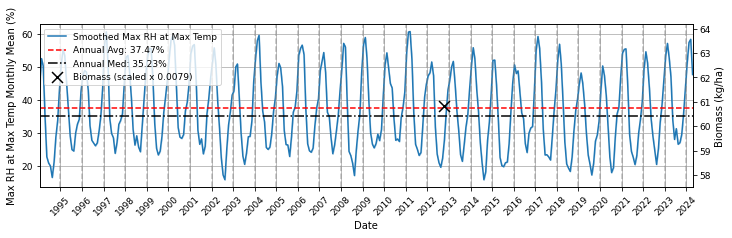

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\legu06_2012_1ha_rh_tmax_mean_line.jpg
legu07.2012_1ha
site_df shape:  (752, 6)
filtering biomass: legu07
(1, 24)
Event dates: ['2012-10-08T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

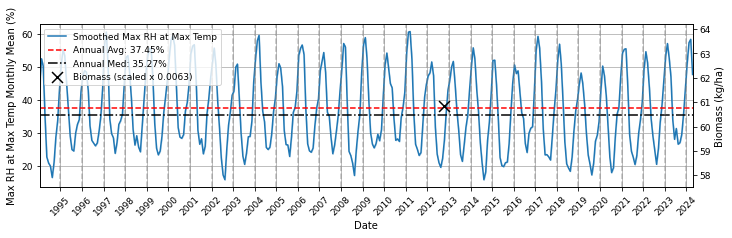

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\legu07_2012_1ha_rh_tmax_mean_line.jpg
legu08.2012_1ha
site_df shape:  (752, 6)
filtering biomass: legu08
(1, 24)
Event dates: ['2012-10-08T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

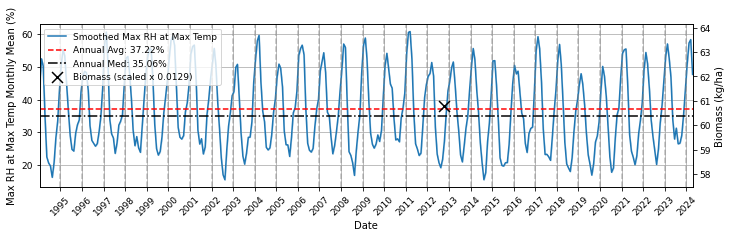

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\legu08_2012_1ha_rh_tmax_mean_line.jpg
lfr101.2024_1ha
site_df shape:  (752, 6)
filtering biomass: lfr101
(1, 24)
Event dates: ['2024-05-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

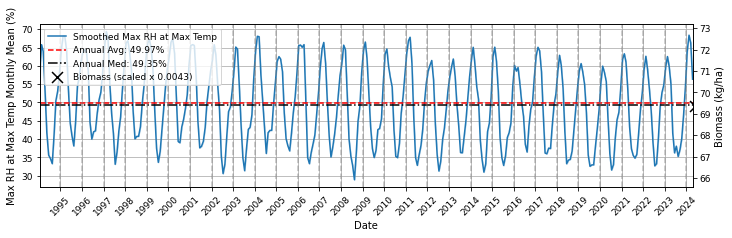

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lfr101_2024_1ha_rh_tmax_mean_line.jpg
lfr102.2024_1ha
site_df shape:  (752, 6)
filtering biomass: lfr102
(1, 24)
Event dates: ['2024-05-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

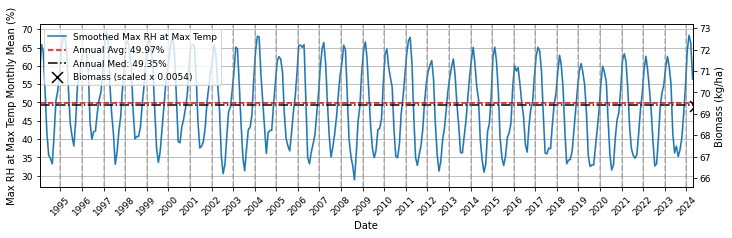

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lfr102_2024_1ha_rh_tmax_mean_line.jpg
lim01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: lim01
(1, 24)
Event dates: ['2012-05-29T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

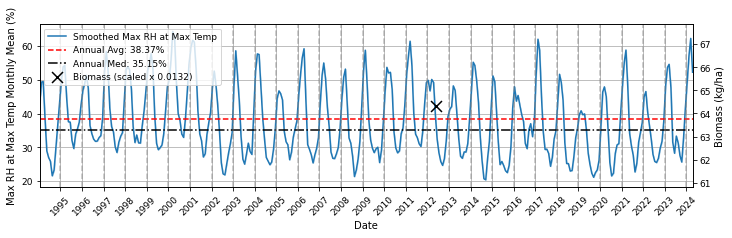

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lim01_2012_1ha_rh_tmax_mean_line.jpg
lim03.2012_1ha
site_df shape:  (752, 6)
filtering biomass: lim03
(1, 24)
Event dates: ['2012-05-30T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

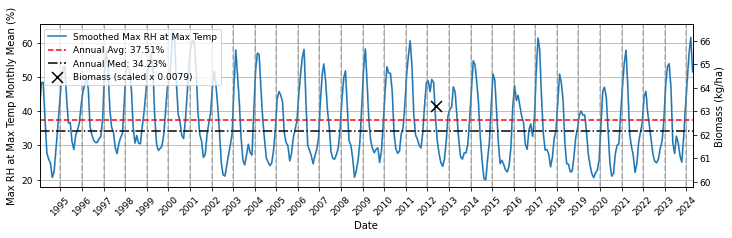

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lim03_2012_1ha_rh_tmax_mean_line.jpg
lim04.2012_1ha
site_df shape:  (752, 6)
filtering biomass: lim04
(1, 24)
Event dates: ['2012-05-30T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

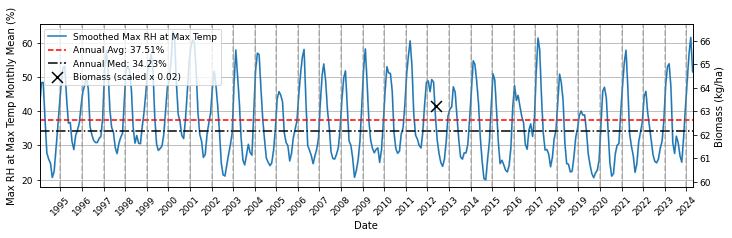

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lim04_2012_1ha_rh_tmax_mean_line.jpg
lim06.2012_1ha
site_df shape:  (752, 6)
filtering biomass: lim06
(1, 24)
Event dates: ['2012-05-30T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

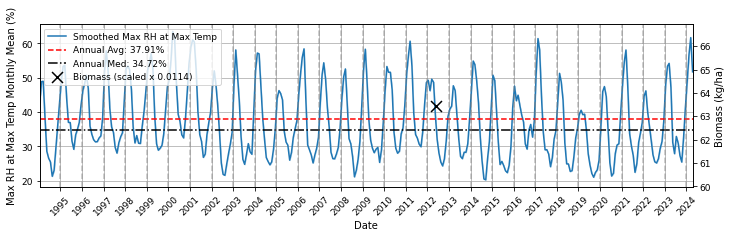

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lim06_2012_1ha_rh_tmax_mean_line.jpg
lim08.2013_1ha
site_df shape:  (752, 6)
filtering biomass: lim08
(1, 24)
Event dates: ['2013-06-01T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

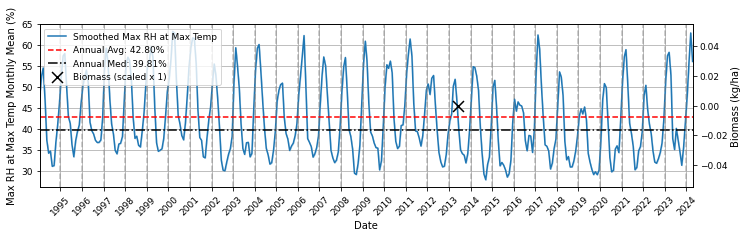

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lim08_2013_1ha_rh_tmax_mean_line.jpg
lim09.2013_1ha
site_df shape:  (752, 6)
filtering biomass: lim09
(1, 24)
Event dates: ['2013-06-01T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

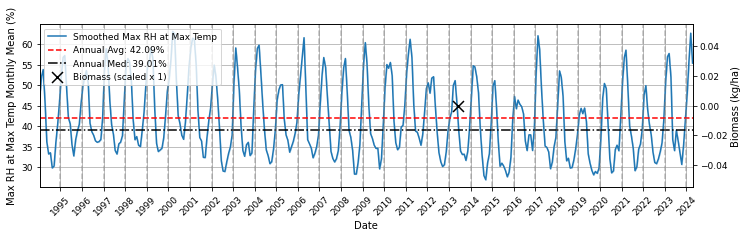

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lim09_2013_1ha_rh_tmax_mean_line.jpg
lit01.2013_1ha
site_df shape:  (752, 6)
filtering biomass: lit01
(1, 24)
Event dates: ['2013-04-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

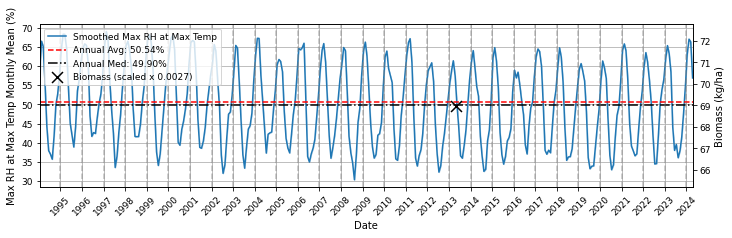

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lit01_2013_1ha_rh_tmax_mean_line.jpg
lto04.2013_1ha
site_df shape:  (752, 6)
filtering biomass: lto04
(1, 24)
Event dates: ['2013-05-28T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

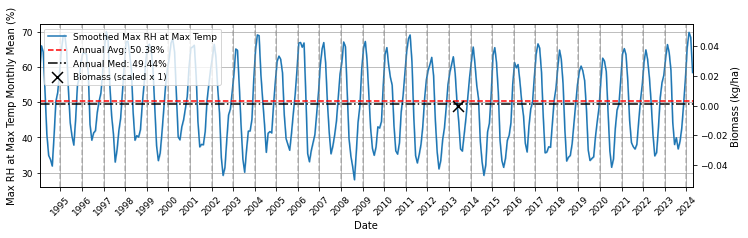

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lto04_2013_1ha_rh_tmax_mean_line.jpg
lto05.2013_1ha
site_df shape:  (752, 6)
filtering biomass: lto05
(1, 24)
Event dates: ['2013-05-28T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

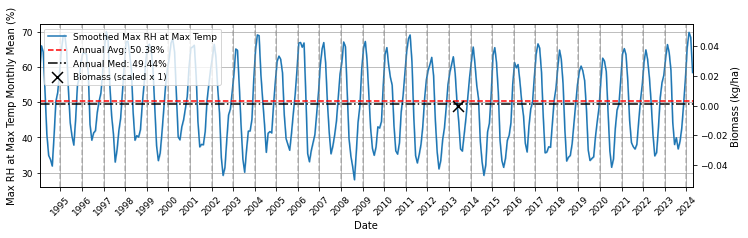

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\lto05_2013_1ha_rh_tmax_mean_line.jpg
nc02.2013_1ha
site_df shape:  (752, 6)
filtering biomass: nc02
(1, 24)
Event dates: ['2013-04-14T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

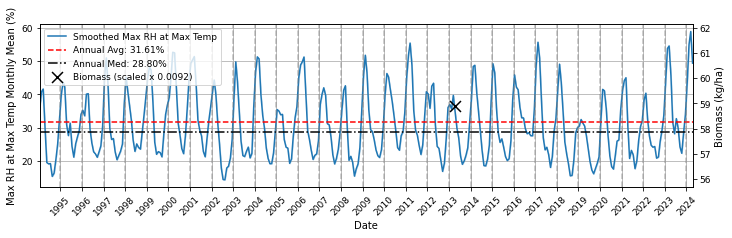

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nc02_2013_1ha_rh_tmax_mean_line.jpg
nc03.2013_1ha
site_df shape:  (752, 6)
filtering biomass: nc03
(1, 24)
Event dates: ['2013-04-14T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

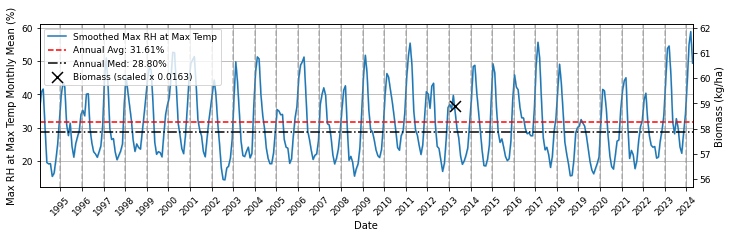

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nc03_2013_1ha_rh_tmax_mean_line.jpg
nt001.2011_1ha
site_df shape:  (752, 6)
filtering biomass: nt001
(1, 24)
Event dates: ['2011-05-23T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

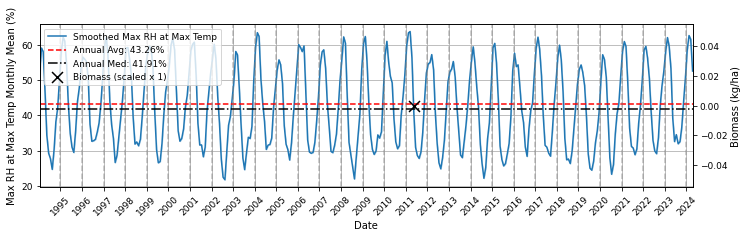

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nt001_2011_1ha_rh_tmax_mean_line.jpg
nt002.2012_1ha
site_df shape:  (752, 6)
filtering biomass: nt002
(1, 24)
Event dates: ['2012-05-23T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

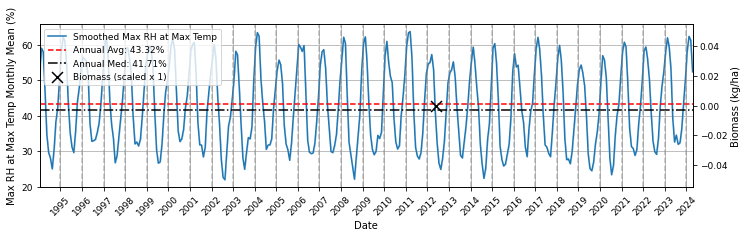

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nt002_2012_1ha_rh_tmax_mean_line.jpg
nt003.2012_1ha
site_df shape:  (752, 6)
filtering biomass: nt003
(1, 24)
Event dates: ['2012-05-23T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

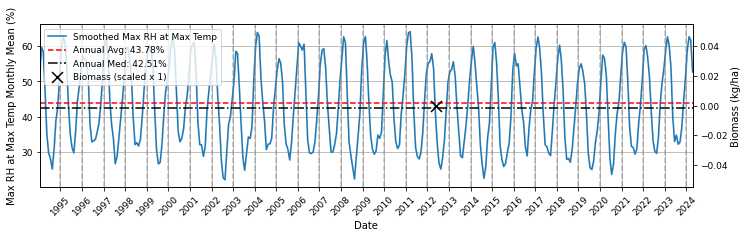

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nt003_2012_1ha_rh_tmax_mean_line.jpg
nt004.2012_1ha
site_df shape:  (752, 6)
filtering biomass: nt004
(1, 24)
Event dates: ['2012-05-24T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

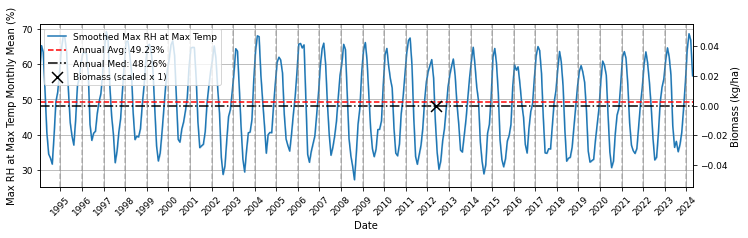

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nt004_2012_1ha_rh_tmax_mean_line.jpg
ntaarp0001.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntaarp0001
(1, 24)
Event dates: ['2016-06-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

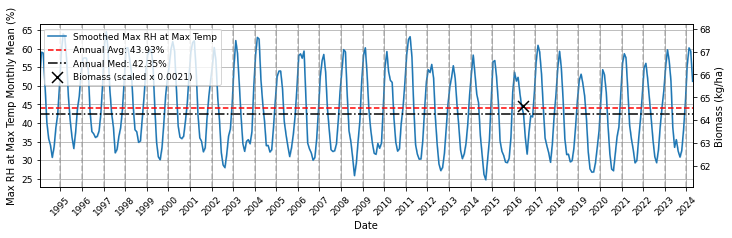

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntaarp0001_2016_1ha_rh_tmax_mean_line.jpg
ntaarp0002.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntaarp0002
(1, 24)
Event dates: ['2016-06-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

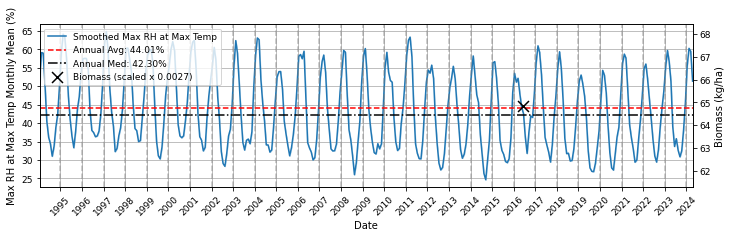

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntaarp0002_2016_1ha_rh_tmax_mean_line.jpg
ntaarp0003.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntaarp0003
(1, 24)
Event dates: ['2016-06-03T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

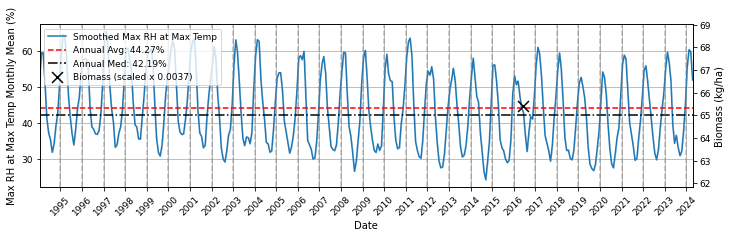

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntaarp0003_2016_1ha_rh_tmax_mean_line.jpg
ntadac0001.2013_1ha
site_df shape:  (752, 6)
filtering biomass: ntadac0001
(1, 24)
Event dates: ['2013-05-28T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

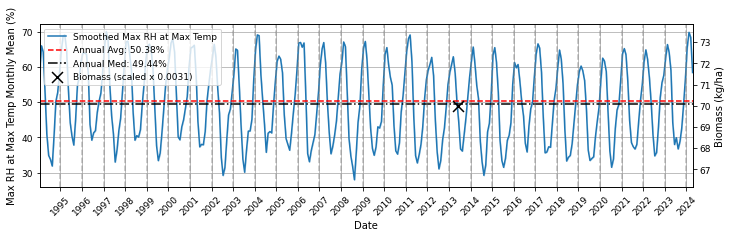

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntadac0001_2013_1ha_rh_tmax_mean_line.jpg
ntadac0002.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntadac0002
(1, 24)
Event dates: ['2016-05-06T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

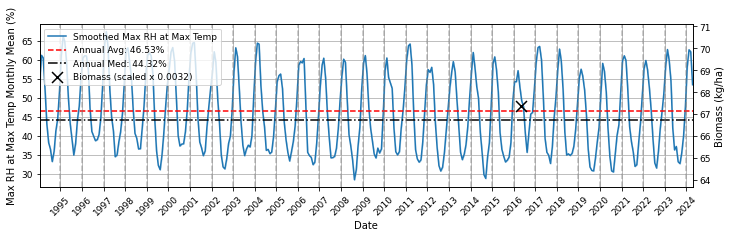

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntadac0002_2016_1ha_rh_tmax_mean_line.jpg
ntagfu0001.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0001
(1, 24)
Event dates: ['2012-04-12T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

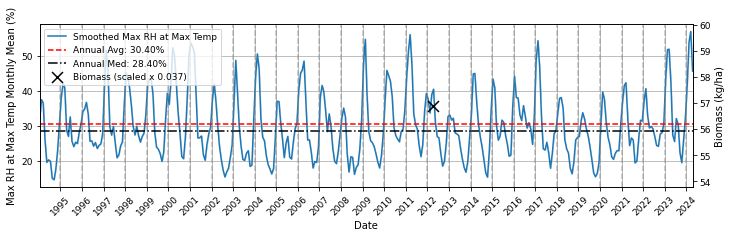

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0001_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0002.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0002
(1, 24)
Event dates: ['2012-04-13T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

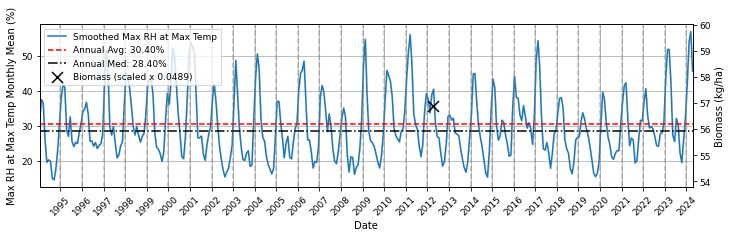

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0002_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0003.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0003
(1, 24)
Event dates: ['2012-04-14T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

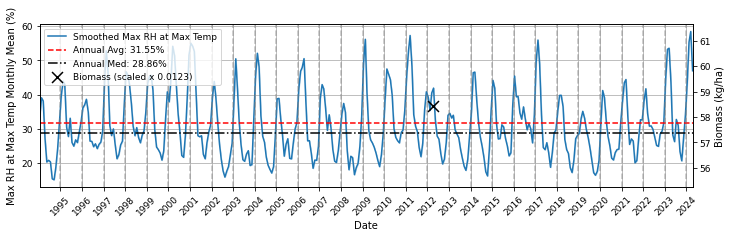

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0003_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0004.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0004
(1, 24)
Event dates: ['2012-04-15T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

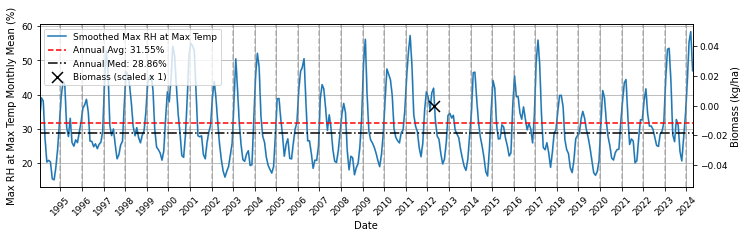

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0004_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0005.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0005
(1, 24)
Event dates: ['2012-04-16T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

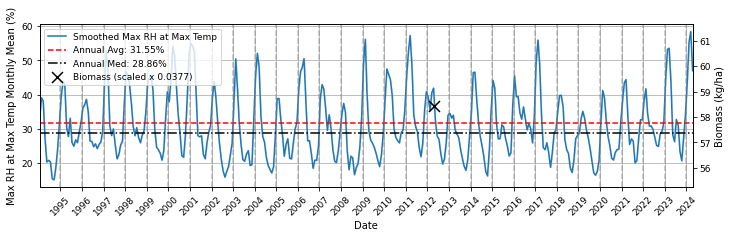

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0005_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0006.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0006
(1, 24)
Event dates: ['2012-04-18T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

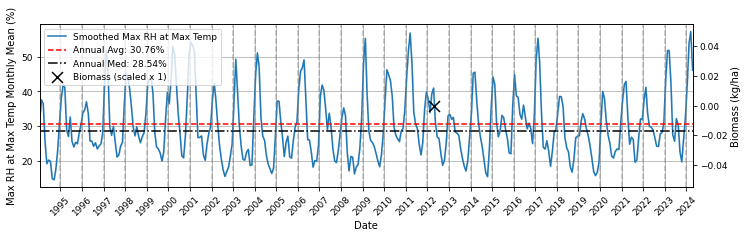

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0006_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0007.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0007
(1, 24)
Event dates: ['2012-04-19T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

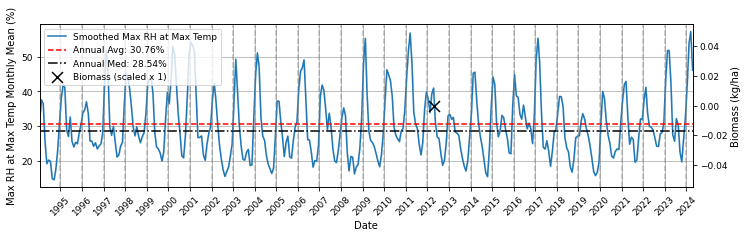

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0007_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0008.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0008
(1, 24)
Event dates: ['2012-04-20T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

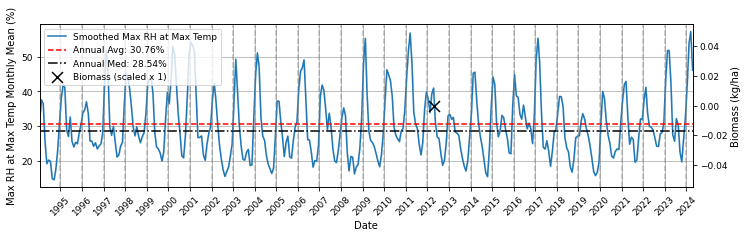

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0008_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0009.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0009
(1, 24)
Event dates: ['2012-04-21T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

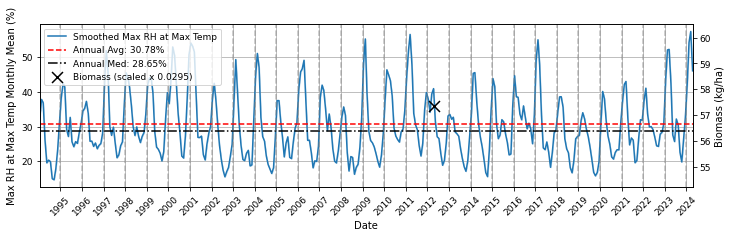

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0009_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0010.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0010
(1, 24)
Event dates: ['2012-05-09T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

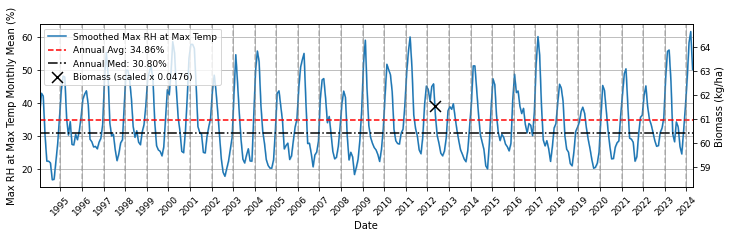

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0010_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0011.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0011
(1, 24)
Event dates: ['2012-05-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

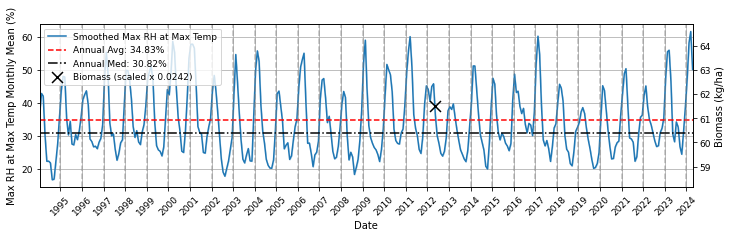

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0011_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0012.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0012
(1, 24)
Event dates: ['2012-05-11T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

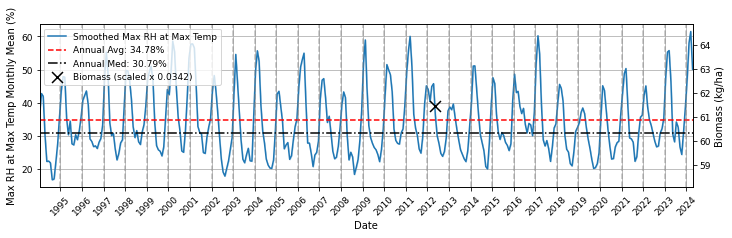

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0012_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0013.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0013
(1, 24)
Event dates: ['2012-05-12T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

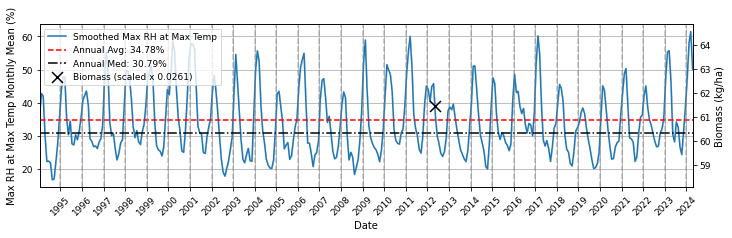

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0013_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0014.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0014
(1, 24)
Event dates: ['2012-05-14T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

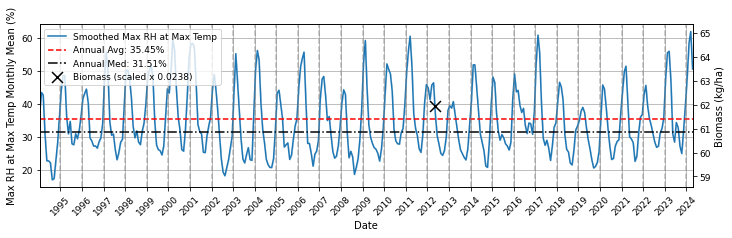

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0014_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0015.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0015
(1, 24)
Event dates: ['2012-05-14T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

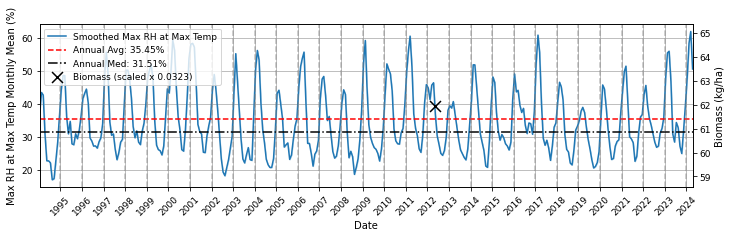

C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0015_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0016.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0016
(1, 24)
Event dates: ['2012-05-16T00:00:00.000000000']


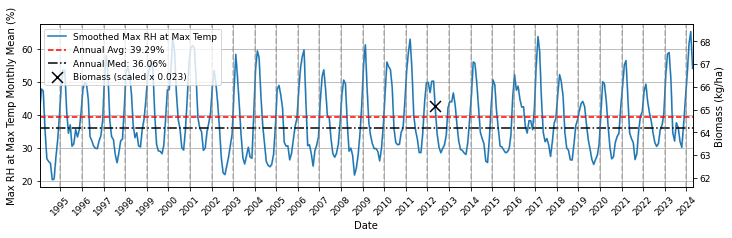

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0016_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0017.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0017
(1, 24)
Event dates: ['2012-05-17T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

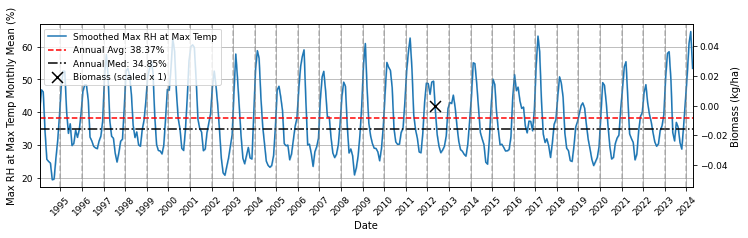

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0017_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0018.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0018
(1, 24)
Event dates: ['2012-05-18T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

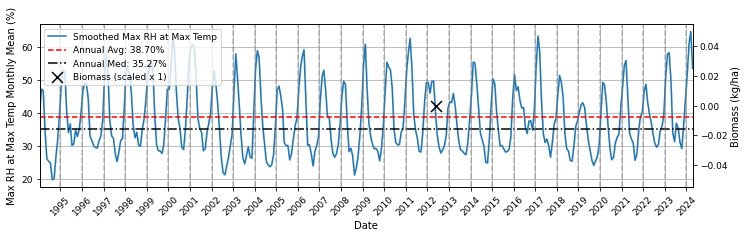

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0018_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0019.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0019
(1, 24)
Event dates: ['2012-05-18T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

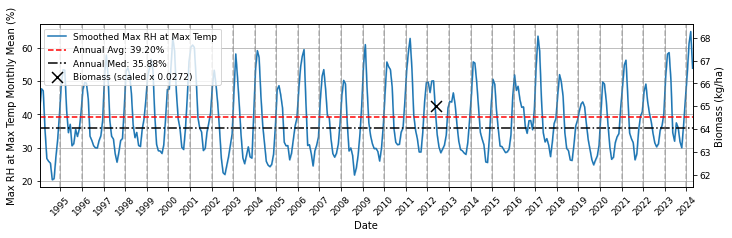

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0019_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0020.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0020
(1, 24)
Event dates: ['2012-06-05T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

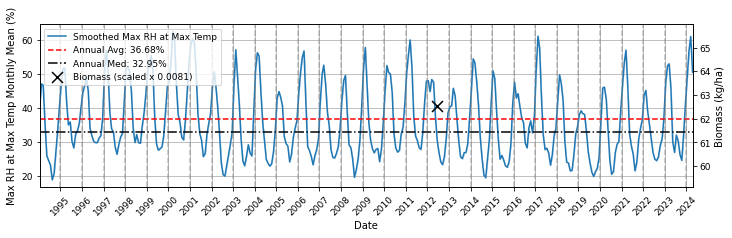

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0020_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0021.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0021
(1, 24)
Event dates: ['2012-06-06T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

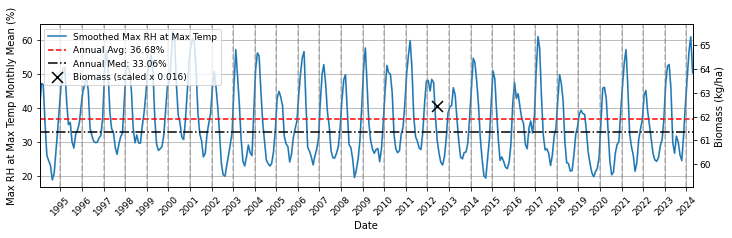

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0021_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0022.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0022
(1, 24)
Event dates: ['2012-06-07T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

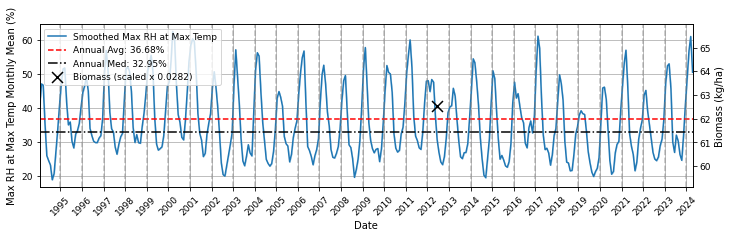

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0022_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0023.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0023
(1, 24)
Event dates: ['2012-06-09T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

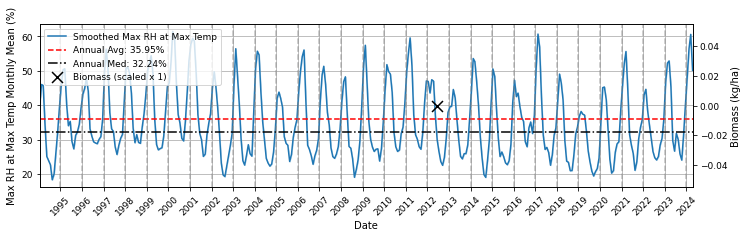

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0023_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0024.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0024
(1, 24)
Event dates: ['2012-06-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

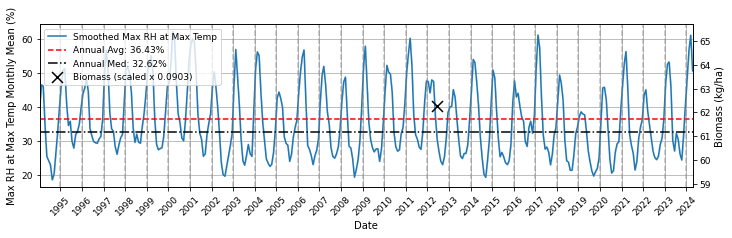

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0024_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0025.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0025
(1, 24)
Event dates: ['2012-06-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

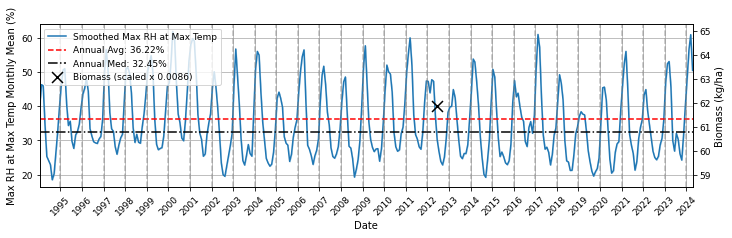

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0025_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0026.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0026
(1, 24)
Event dates: ['2012-06-12T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

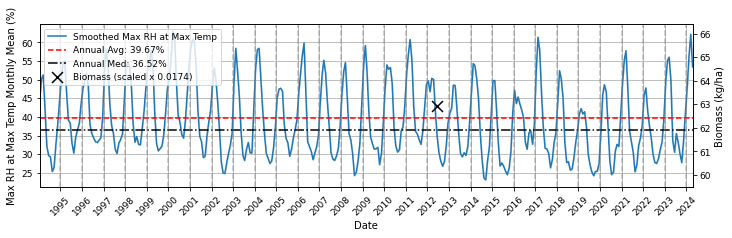

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0026_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0027.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0027
(1, 24)
Event dates: ['2012-06-13T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

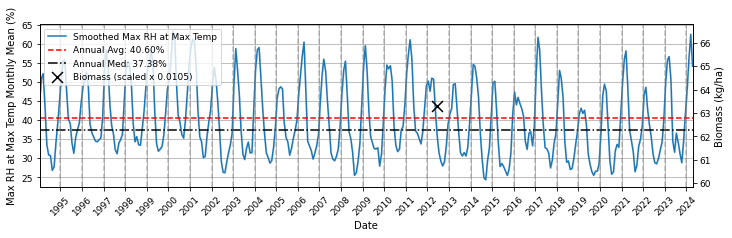

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0027_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0028.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0028
(1, 24)
Event dates: ['2012-06-14T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

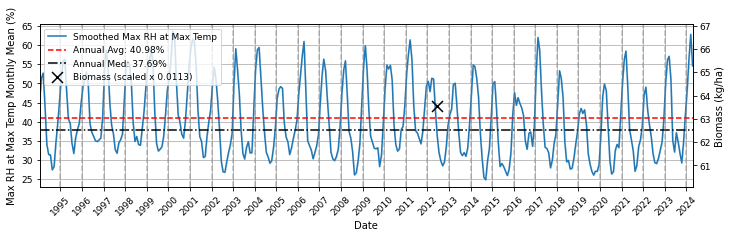

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0028_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0029.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0029
(1, 24)
Event dates: ['2012-06-15T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

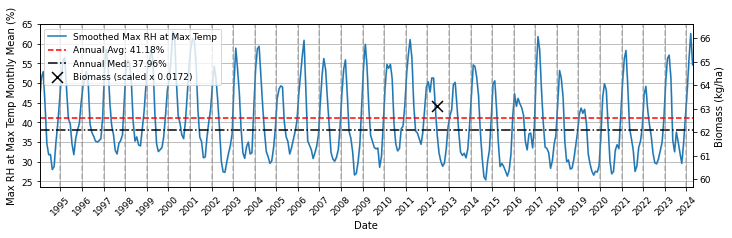

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0029_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0030.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0030
(1, 24)
Event dates: ['2012-07-05T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

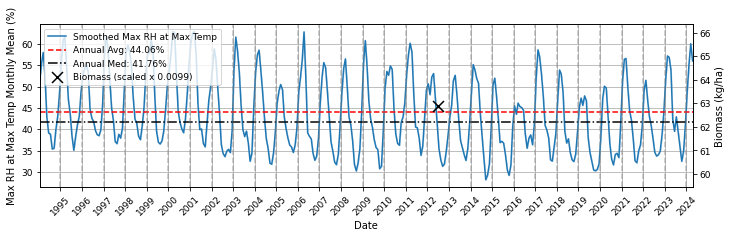

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0030_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0031.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0031
(1, 24)
Event dates: ['2012-07-06T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

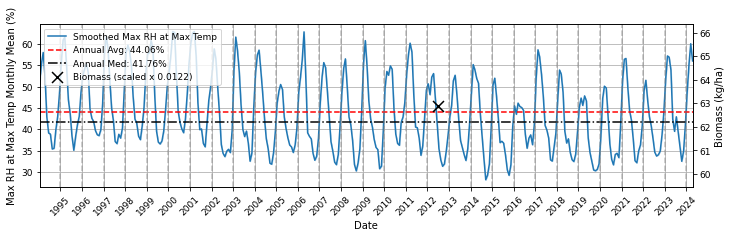

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0031_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0032.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0032
(1, 24)
Event dates: ['2012-07-07T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

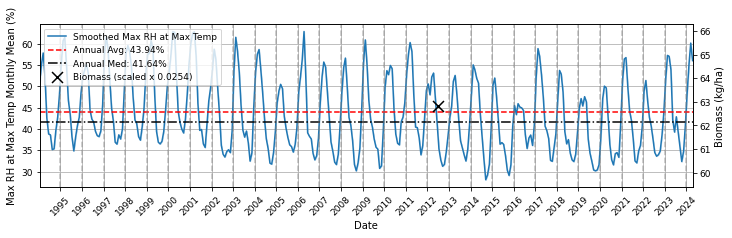

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0032_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0033.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0033
(1, 24)
Event dates: ['2012-07-08T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

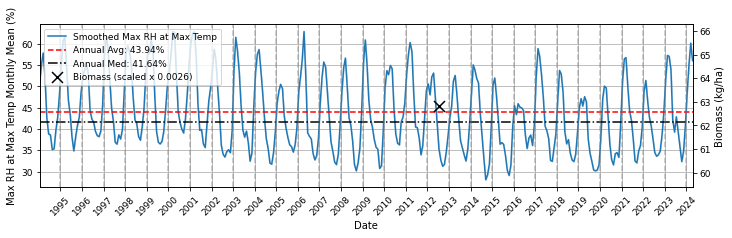

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0033_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0034.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0034
(1, 24)
Event dates: ['2012-07-09T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

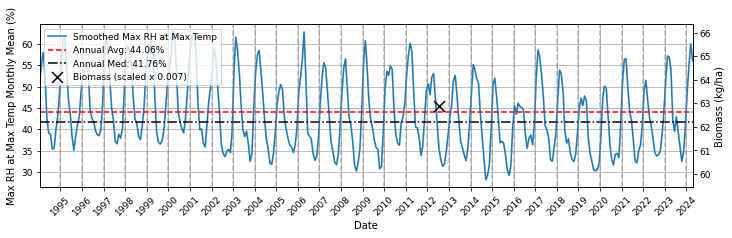

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0034_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0035.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0035
(1, 24)
Event dates: ['2012-07-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

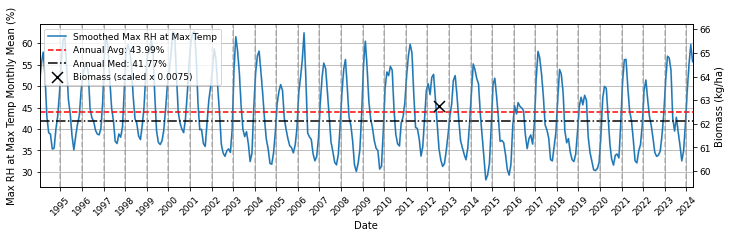

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0035_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0036.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0036
(1, 24)
Event dates: ['2012-07-11T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

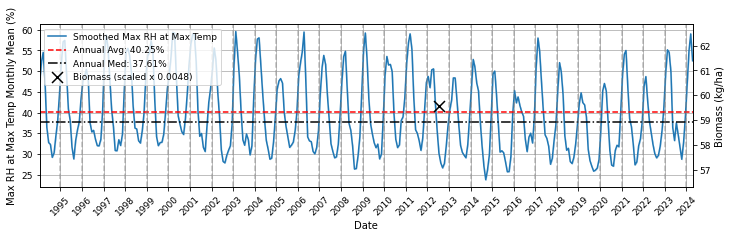

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0036_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0037.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0037
(1, 24)
Event dates: ['2012-07-12T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

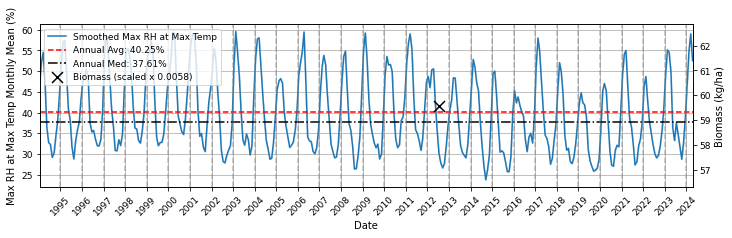

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0037_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0038.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0038
(1, 24)
Event dates: ['2012-07-12T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

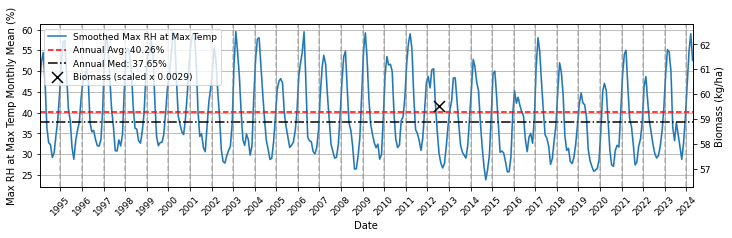

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0038_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0039.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0039
(1, 24)
Event dates: ['2012-07-14T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

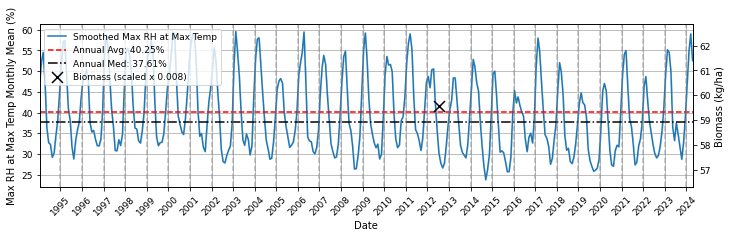

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0039_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0040.2012_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0040
(1, 24)
Event dates: ['2012-07-15T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

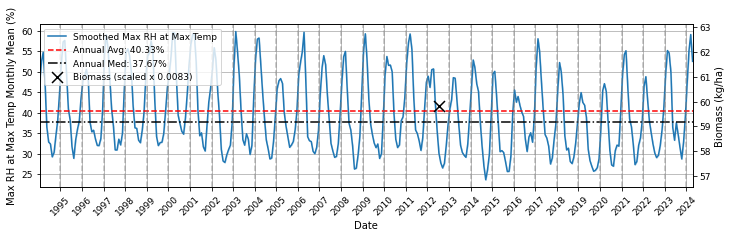

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0040_2012_1ha_rh_tmax_mean_line.jpg
ntagfu0041.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntagfu0041
(1, 24)
Event dates: ['2016-05-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

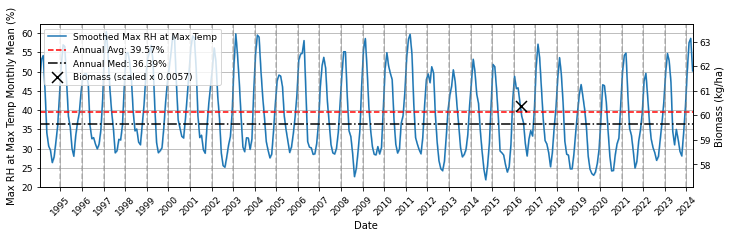

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntagfu0041_2016_1ha_rh_tmax_mean_line.jpg
ntamgd0001.2014_1ha
site_df shape:  (752, 6)
filtering biomass: ntamgd0001
(1, 24)
Event dates: ['2014-03-13T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

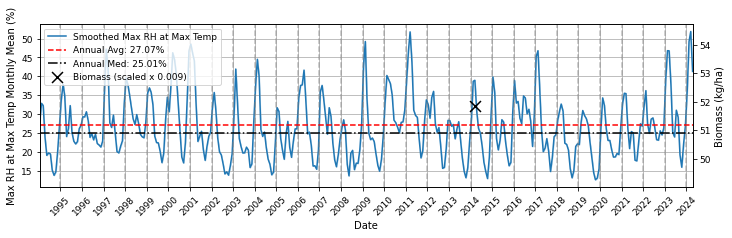

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntamgd0001_2014_1ha_rh_tmax_mean_line.jpg
ntamgd0002.2014_1ha
site_df shape:  (752, 6)
filtering biomass: ntamgd0002
(1, 24)
Event dates: ['2014-03-12T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

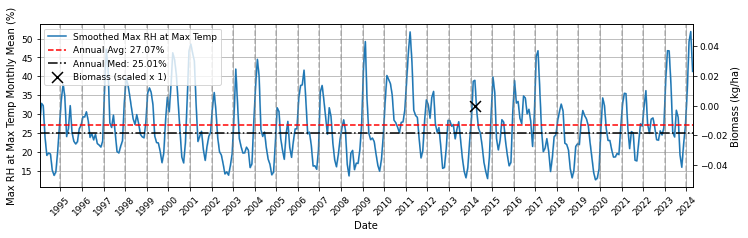

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntamgd0002_2014_1ha_rh_tmax_mean_line.jpg
ntamgd0003.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntamgd0003
(1, 24)
Event dates: ['2016-04-28T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

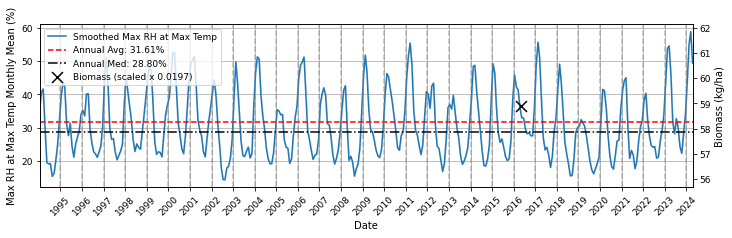

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntamgd0003_2016_1ha_rh_tmax_mean_line.jpg
ntamgd0004.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntamgd0004
(1, 24)
Event dates: ['2016-04-29T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

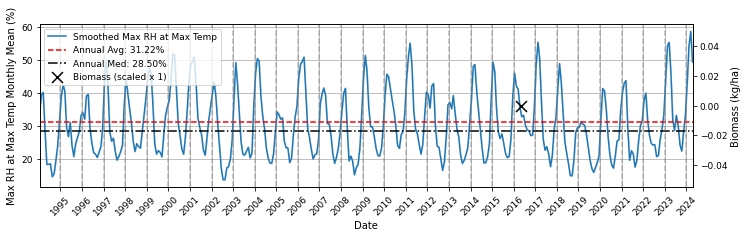

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntamgd0004_2016_1ha_rh_tmax_mean_line.jpg
ntamgd0005.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntamgd0005
(1, 24)
Event dates: ['2016-04-29T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

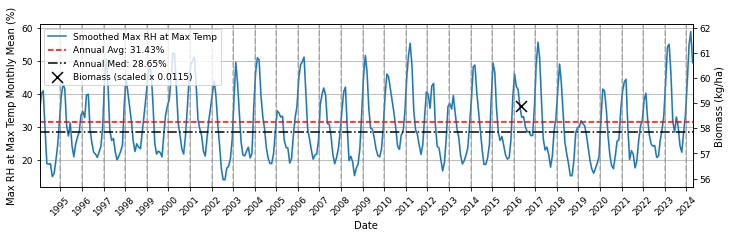

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntamgd0005_2016_1ha_rh_tmax_mean_line.jpg
ntapck0001.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntapck0001
(1, 24)
Event dates: ['2016-05-04T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

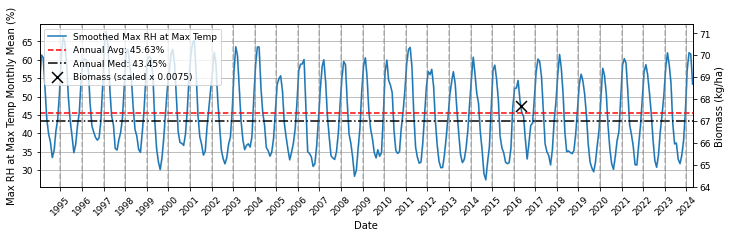

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntapck0001_2016_1ha_rh_tmax_mean_line.jpg
ntapck0002.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntapck0002
(1, 24)
Event dates: ['2016-05-05T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

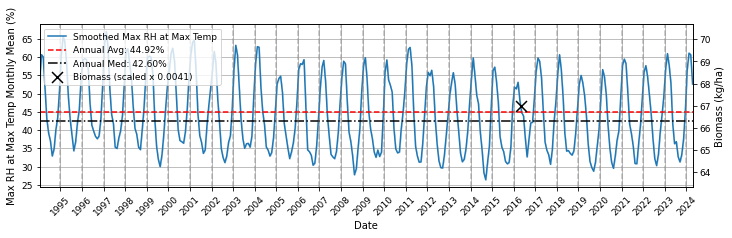

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntapck0002_2016_1ha_rh_tmax_mean_line.jpg
ntastu0001.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntastu0001
(1, 24)
Event dates: ['2016-04-30T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

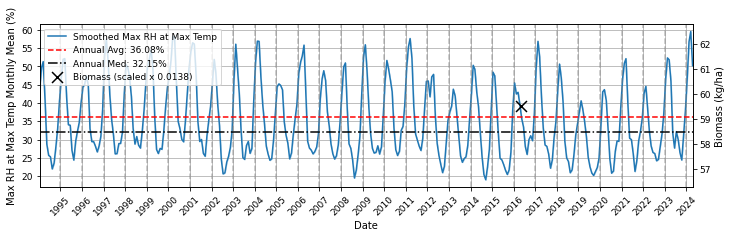

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntastu0001_2016_1ha_rh_tmax_mean_line.jpg
ntastu0002.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntastu0002
(1, 24)
Event dates: ['2016-05-01T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

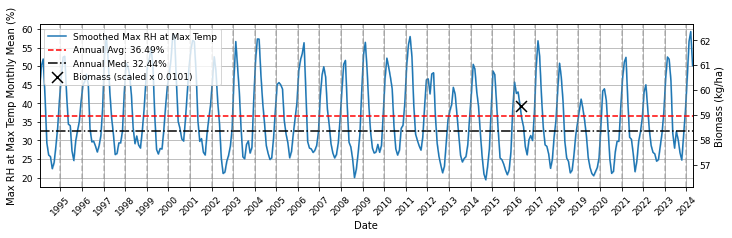

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntastu0002_2016_1ha_rh_tmax_mean_line.jpg
ntastu0003.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntastu0003
(1, 24)
Event dates: ['2016-05-01T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

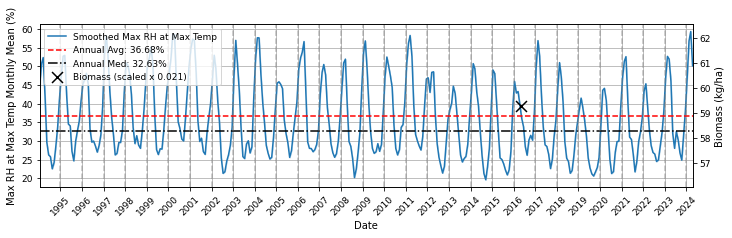

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntastu0003_2016_1ha_rh_tmax_mean_line.jpg
ntastu0004.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntastu0004
(1, 24)
Event dates: ['2016-05-03T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

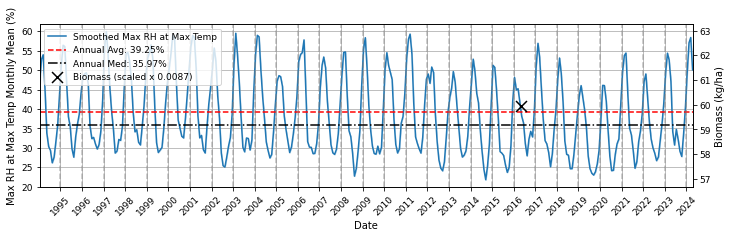

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntastu0004_2016_1ha_rh_tmax_mean_line.jpg
ntastu0005.2016_1ha
site_df shape:  (752, 6)
filtering biomass: ntastu0005
(1, 24)
Event dates: ['2016-05-03T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

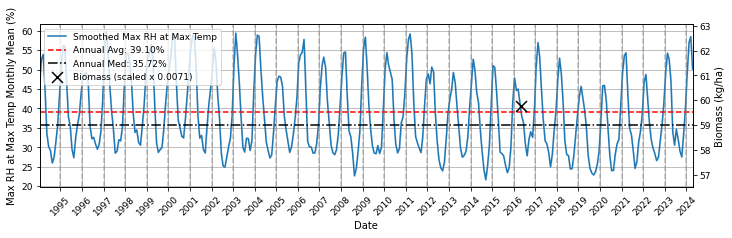

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\ntastu0005_2016_1ha_rh_tmax_mean_line.jpg
nttdab0001.2014_1ha
site_df shape:  (752, 6)
filtering biomass: nttdab0001
(1, 24)
Event dates: ['2014-03-17T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

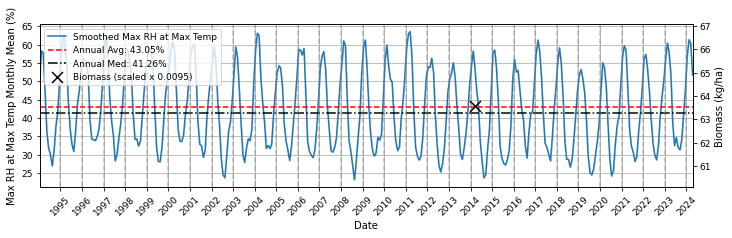

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nttdab0001_2014_1ha_rh_tmax_mean_line.jpg
nttdac0001.2014_1ha
site_df shape:  (752, 6)
filtering biomass: nttdac0001
(1, 24)
Event dates: ['2014-03-18T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

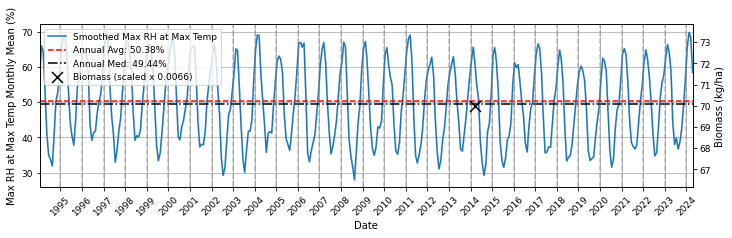

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nttdac0001_2014_1ha_rh_tmax_mean_line.jpg
nttmgd0001.2014_1ha
site_df shape:  (752, 6)
filtering biomass: nttmgd0001
(1, 24)
Event dates: ['2014-03-15T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

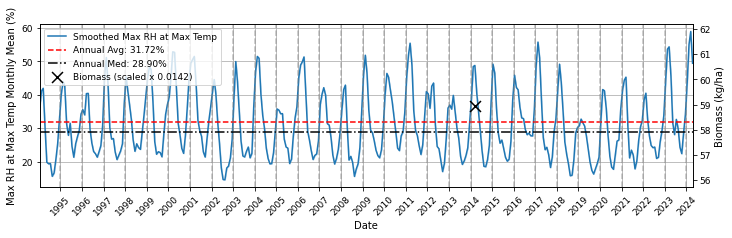

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nttmgd0001_2014_1ha_rh_tmax_mean_line.jpg
nttpck0001.2014_1ha
site_df shape:  (752, 6)
filtering biomass: nttpck0001
(1, 24)
Event dates: ['2014-03-19T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

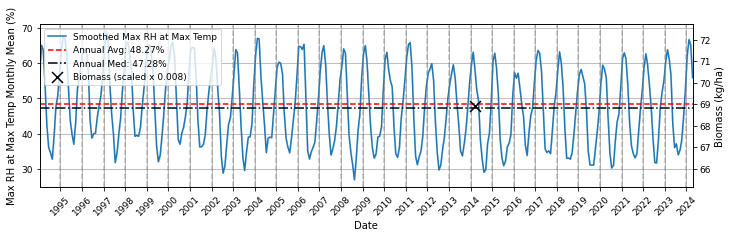

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nttpck0001_2014_1ha_rh_tmax_mean_line.jpg
nttstu0001.2014_1ha
site_df shape:  (752, 6)
filtering biomass: nttstu0001
(1, 24)
Event dates: ['2014-03-15T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

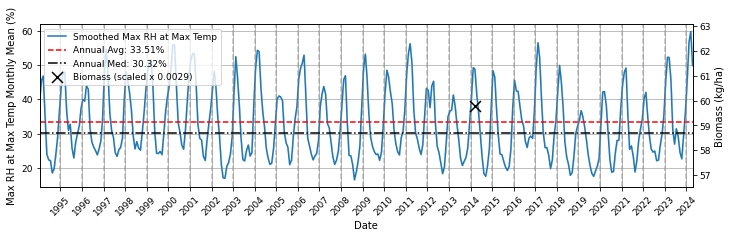

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\nttstu0001_2014_1ha_rh_tmax_mean_line.jpg
site01.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site01
(1, 24)
Event dates: ['2023-09-07T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

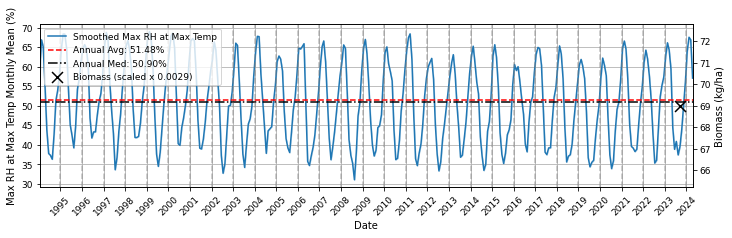

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site01_2023_1ha_rh_tmax_mean_line.jpg
site02.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site02
(1, 24)
Event dates: ['2023-09-07T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

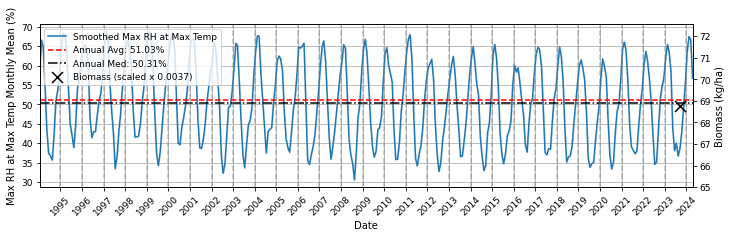

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site02_2023_1ha_rh_tmax_mean_line.jpg
site03.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site03
(1, 24)
Event dates: ['2023-09-07T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

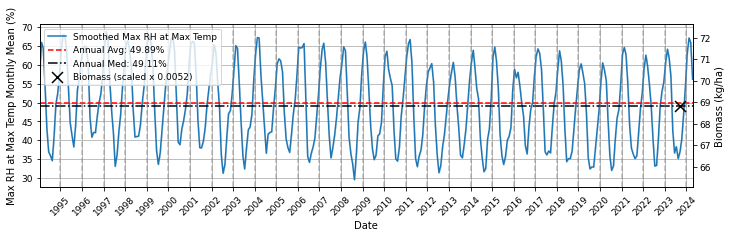

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site03_2023_1ha_rh_tmax_mean_line.jpg
site04.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site04
(1, 24)
Event dates: ['2023-09-07T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

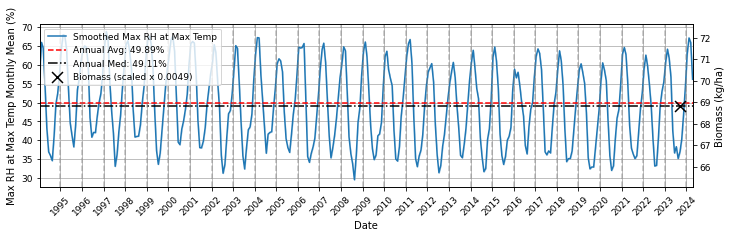

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site04_2023_1ha_rh_tmax_mean_line.jpg
site05.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site05
(1, 24)
Event dates: ['2023-09-08T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

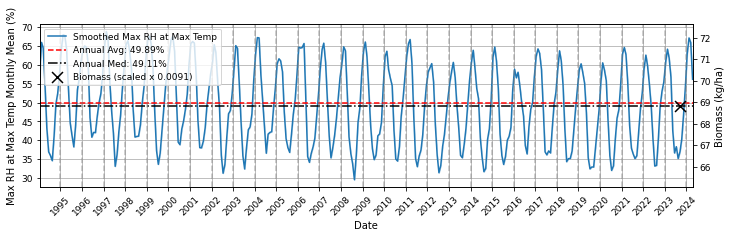

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site05_2023_1ha_rh_tmax_mean_line.jpg
site06.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site06
(1, 24)
Event dates: ['2023-09-08T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

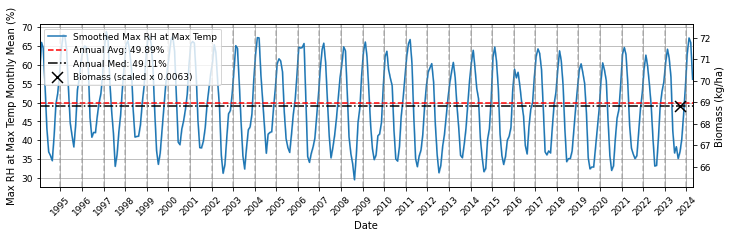

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site06_2023_1ha_rh_tmax_mean_line.jpg
site07.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site07
(1, 24)
Event dates: ['2023-09-09T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

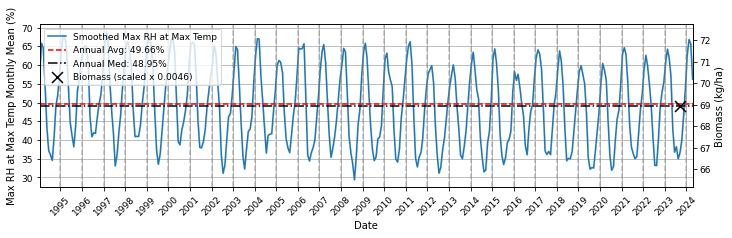

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site07_2023_1ha_rh_tmax_mean_line.jpg
site08.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site08
(1, 24)
Event dates: ['2023-09-09T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

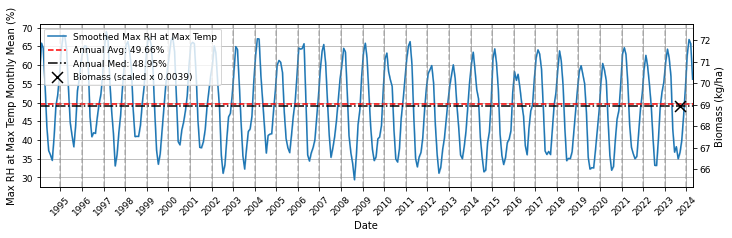

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site08_2023_1ha_rh_tmax_mean_line.jpg
site09.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site09
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

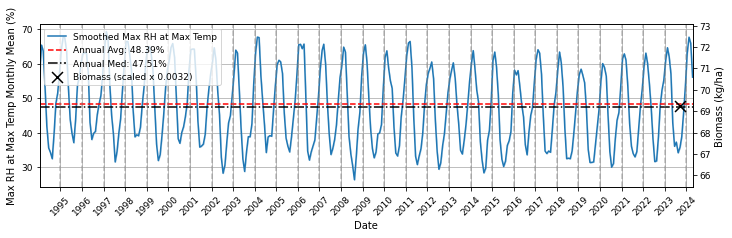

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site09_2023_1ha_rh_tmax_mean_line.jpg
site10.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site10
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

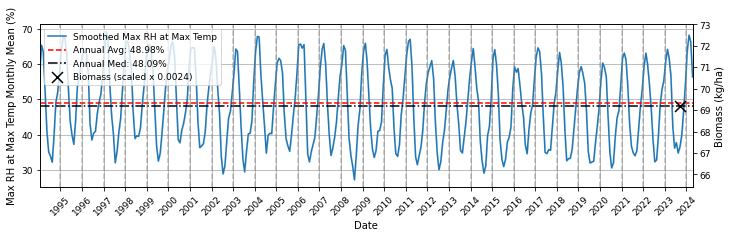

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site10_2023_1ha_rh_tmax_mean_line.jpg
site11.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site11
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

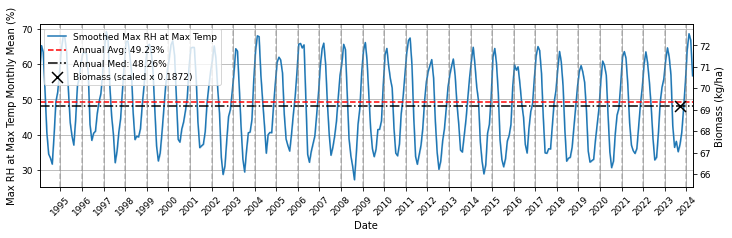

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site11_2023_1ha_rh_tmax_mean_line.jpg
site12.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site12
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

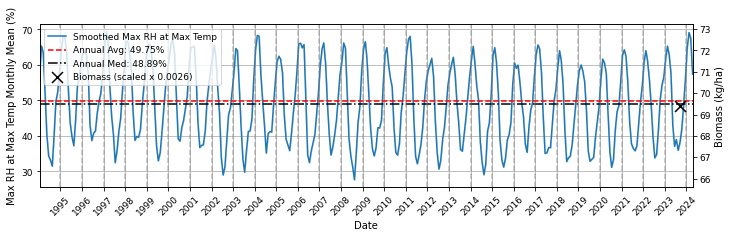

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site12_2023_1ha_rh_tmax_mean_line.jpg
site13.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site13
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

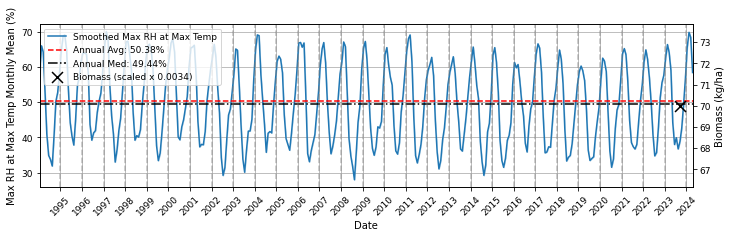

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site13_2023_1ha_rh_tmax_mean_line.jpg
site14.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site14
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

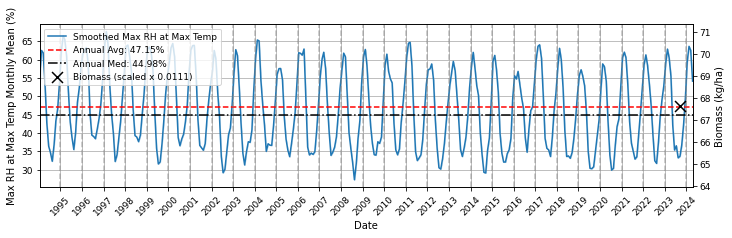

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site14_2023_1ha_rh_tmax_mean_line.jpg
site15.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site15
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

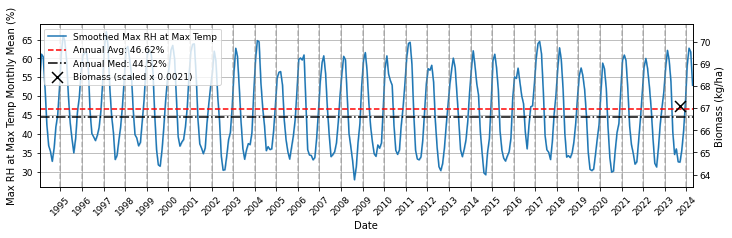

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site15_2023_1ha_rh_tmax_mean_line.jpg
site16.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site16
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

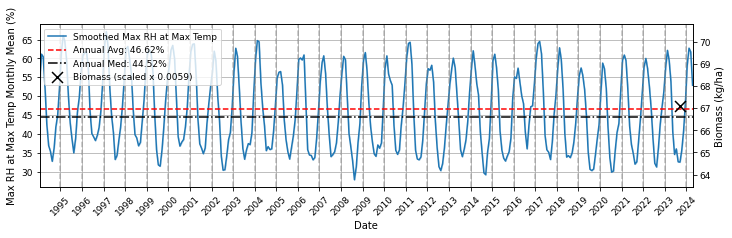

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site16_2023_1ha_rh_tmax_mean_line.jpg
site17.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site17
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

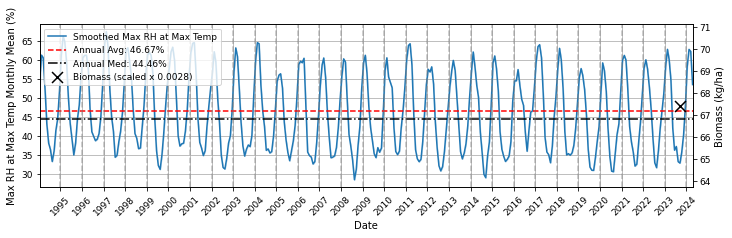

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site17_2023_1ha_rh_tmax_mean_line.jpg
site18.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site18
(1, 24)
Event dates: ['2023-09-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

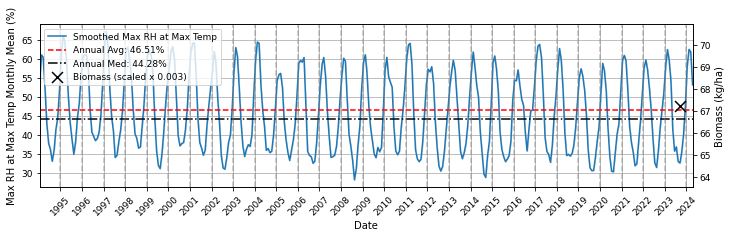

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site18_2023_1ha_rh_tmax_mean_line.jpg
site20.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site20
(1, 24)
Event dates: ['2023-09-16T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

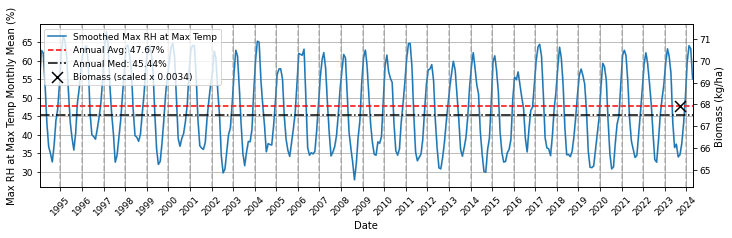

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site20_2023_1ha_rh_tmax_mean_line.jpg
site21.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site21
(1, 24)
Event dates: ['2023-09-16T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

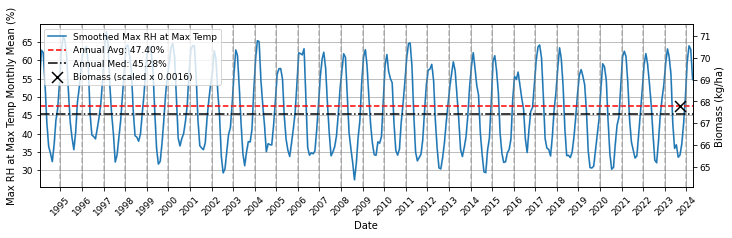

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site21_2023_1ha_rh_tmax_mean_line.jpg
site22.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site22
(1, 24)
Event dates: ['2023-09-16T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

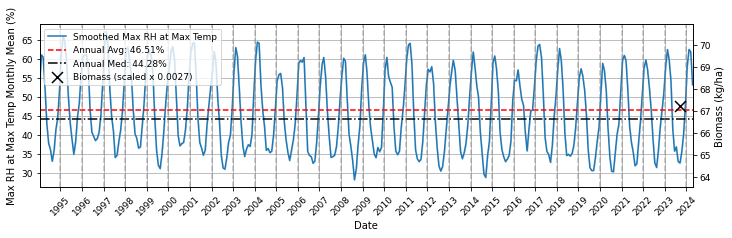

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site22_2023_1ha_rh_tmax_mean_line.jpg
site23.2023_1ha
site_df shape:  (752, 6)
filtering biomass: site23
(1, 24)
Event dates: ['2023-09-16T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

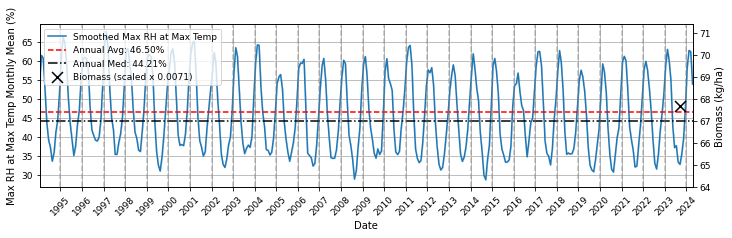

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\site23_2023_1ha_rh_tmax_mean_line.jpg
umb07.2013_1ha
site_df shape:  (752, 6)
filtering biomass: umb07
(1, 24)
Event dates: ['2013-06-03T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

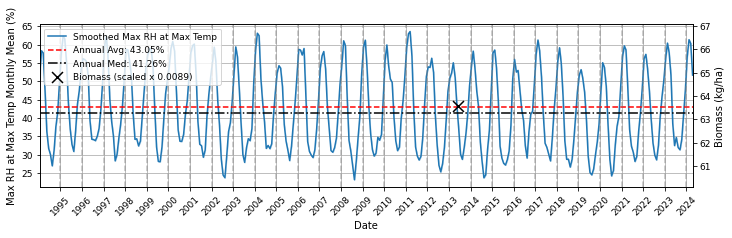

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\umb07_2013_1ha_rh_tmax_mean_line.jpg
vrd16.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd16
(1, 24)
Event dates: ['2012-07-27T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

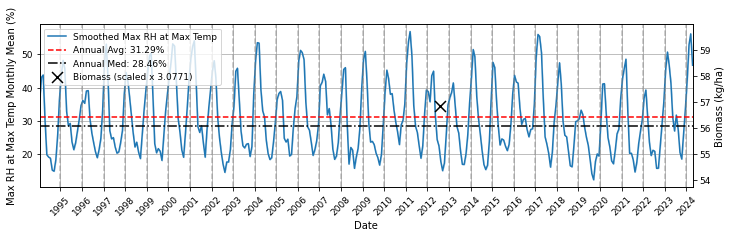

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd16_2012_1ha_rh_tmax_mean_line.jpg
vrd17.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd17
(1, 24)
Event dates: ['2012-07-27T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

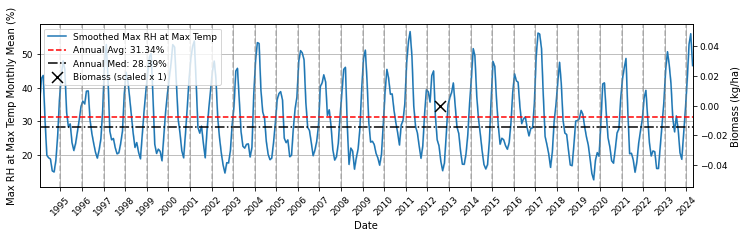

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd17_2012_1ha_rh_tmax_mean_line.jpg
vrd20.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd20
(1, 24)
Event dates: ['2012-07-28T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

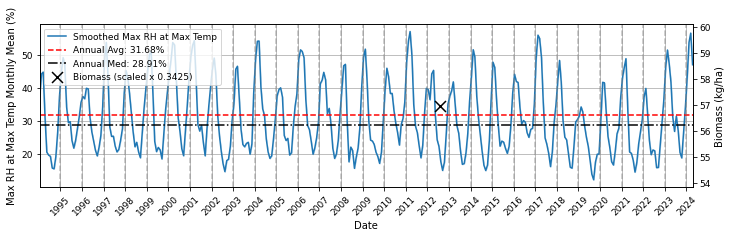

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd20_2012_1ha_rh_tmax_mean_line.jpg
vrd22.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd22
(1, 24)
Event dates: ['2012-07-28T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

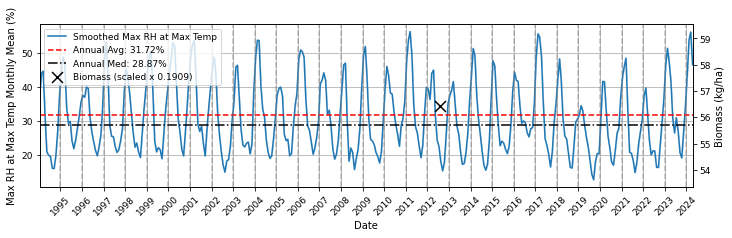

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd22_2012_1ha_rh_tmax_mean_line.jpg
vrd23.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd23
(1, 24)
Event dates: ['2012-07-29T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

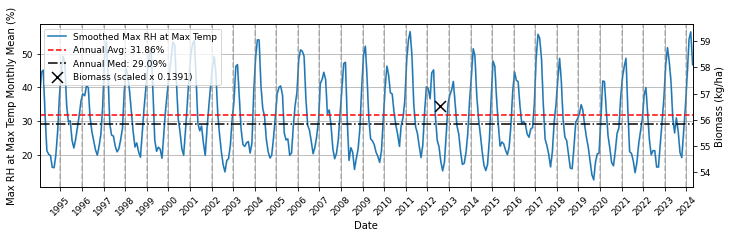

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd23_2012_1ha_rh_tmax_mean_line.jpg
vrd24.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd24
(1, 24)
Event dates: ['2012-07-29T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

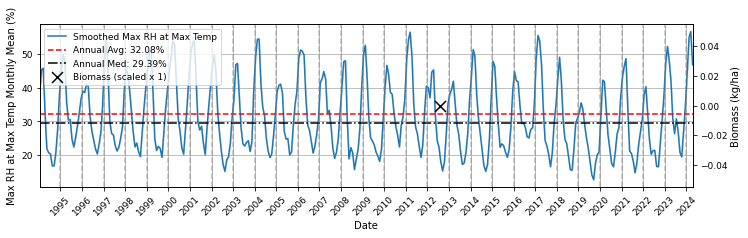

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd24_2012_1ha_rh_tmax_mean_line.jpg
vrd25.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd25
(1, 24)
Event dates: ['2012-07-30T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

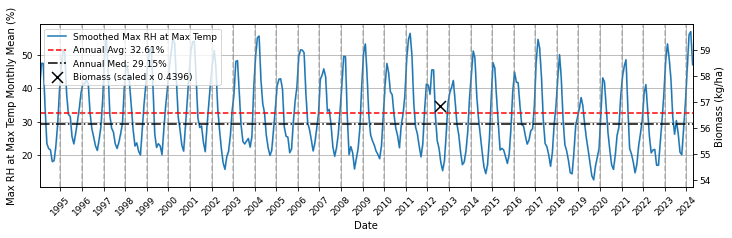

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd25_2012_1ha_rh_tmax_mean_line.jpg
vrd26.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd26
(1, 24)
Event dates: ['2012-07-30T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

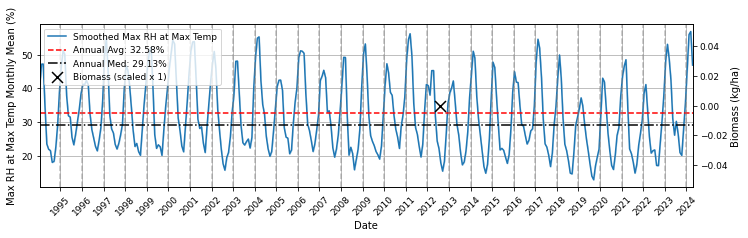

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd26_2012_1ha_rh_tmax_mean_line.jpg
vrd29.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd29
(1, 24)
Event dates: ['2012-07-31T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

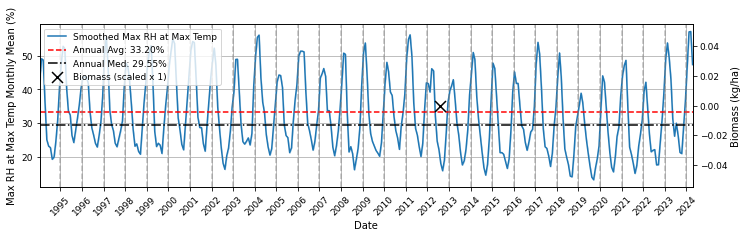

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd29_2012_1ha_rh_tmax_mean_line.jpg
vrd30.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd30
(1, 24)
Event dates: ['2012-07-31T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

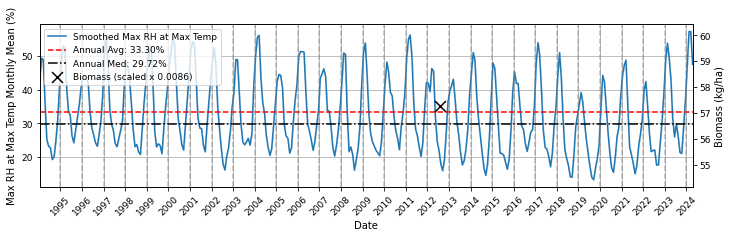

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd30_2012_1ha_rh_tmax_mean_line.jpg
vrd31.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd31
(1, 24)
Event dates: ['2012-08-01T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

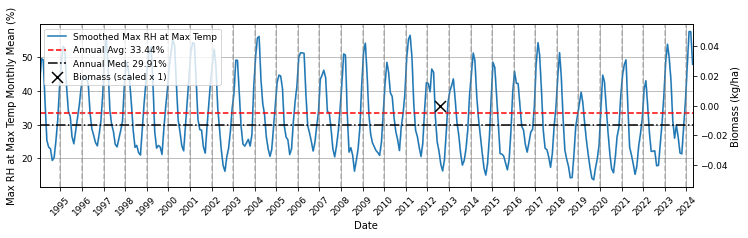

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd31_2012_1ha_rh_tmax_mean_line.jpg
vrd32.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd32
(1, 24)
Event dates: ['2012-08-01T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

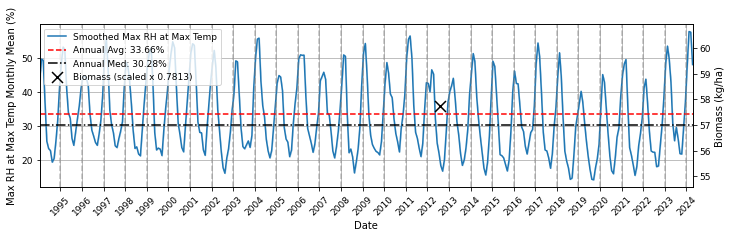

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd32_2012_1ha_rh_tmax_mean_line.jpg
vrd33.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd33
(1, 24)
Event dates: ['2012-08-01T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

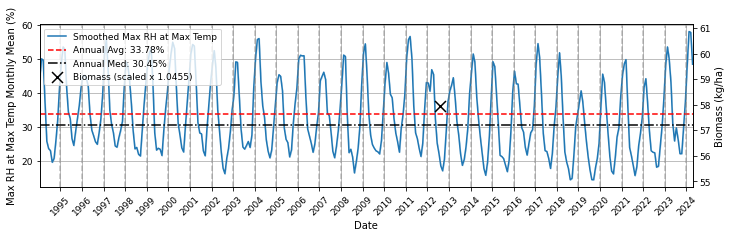

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd33_2012_1ha_rh_tmax_mean_line.jpg
vrd34.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd34
(1, 24)
Event dates: ['2012-08-01T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

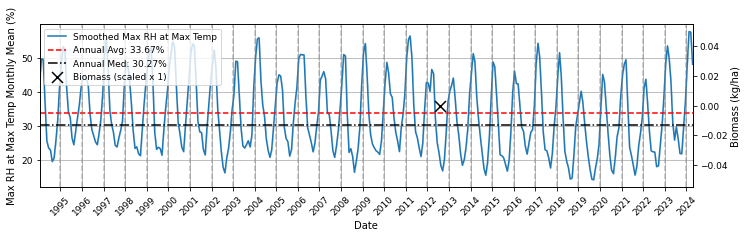

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd34_2012_1ha_rh_tmax_mean_line.jpg
vrd35.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd35
(1, 24)
Event dates: ['2012-08-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

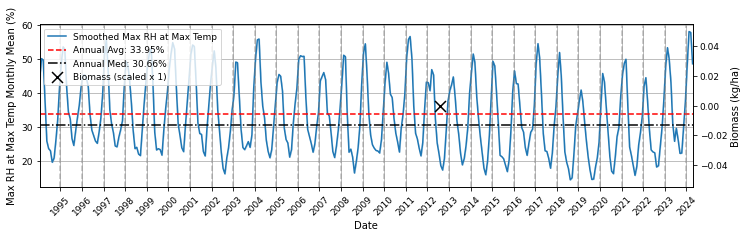

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd35_2012_1ha_rh_tmax_mean_line.jpg
vrd36.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd36
(1, 24)
Event dates: ['2012-08-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

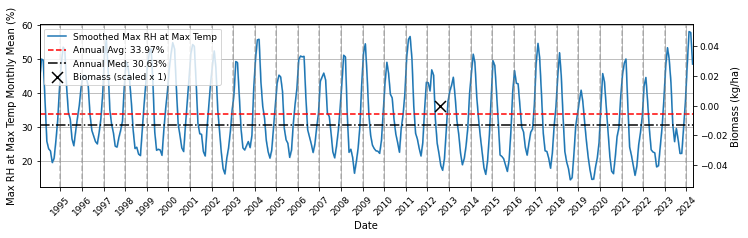

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd36_2012_1ha_rh_tmax_mean_line.jpg
vrd37.2012_1ha
site_df shape:  (752, 6)
filtering biomass: vrd37
(1, 24)
Event dates: ['2012-08-02T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

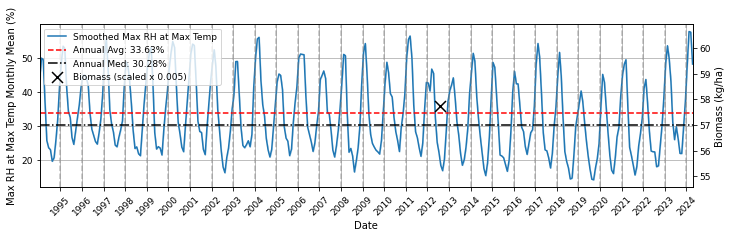

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\vrd37_2012_1ha_rh_tmax_mean_line.jpg
wedo01.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wedo01
(1, 24)
Event dates: ['2012-06-06T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

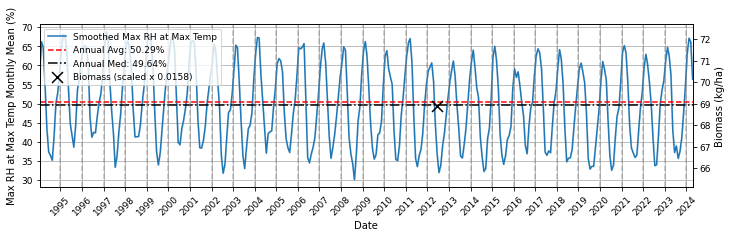

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wedo01_2012_1ha_rh_tmax_mean_line.jpg
wedo03.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wedo03
(1, 24)
Event dates: ['2012-07-10T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

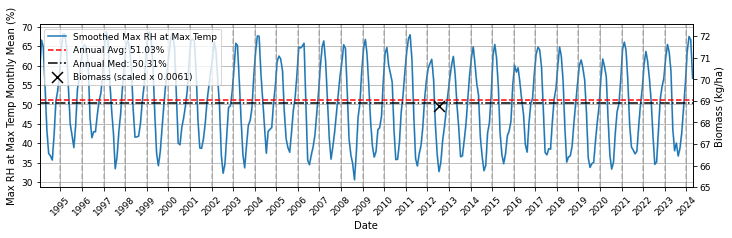

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wedo03_2012_1ha_rh_tmax_mean_line.jpg
wh02.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh02
(1, 24)
Event dates: ['2012-07-24T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

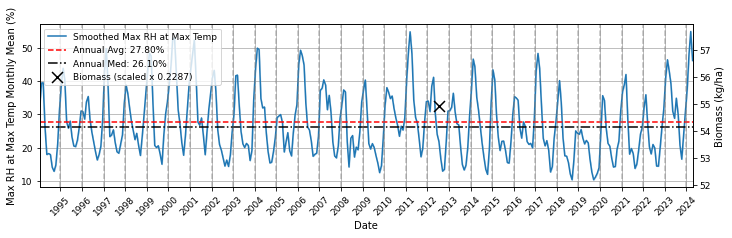

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh02_2012_1ha_rh_tmax_mean_line.jpg
wh03.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh03
(1, 24)
Event dates: ['2012-07-24T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

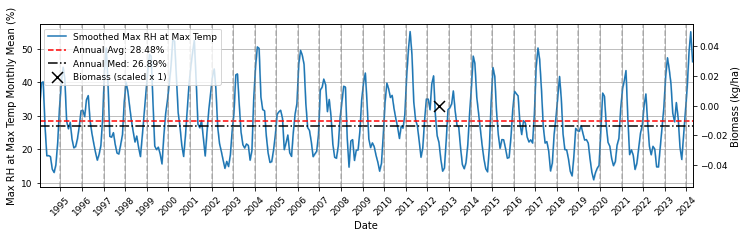

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh03_2012_1ha_rh_tmax_mean_line.jpg
wh04.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh04
(1, 24)
Event dates: ['2012-07-24T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

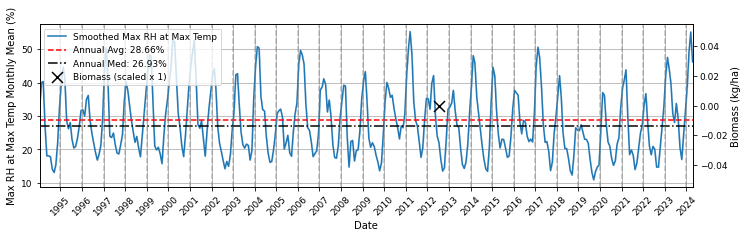

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh04_2012_1ha_rh_tmax_mean_line.jpg
wh05.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh05
(1, 24)
Event dates: ['2012-07-25T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

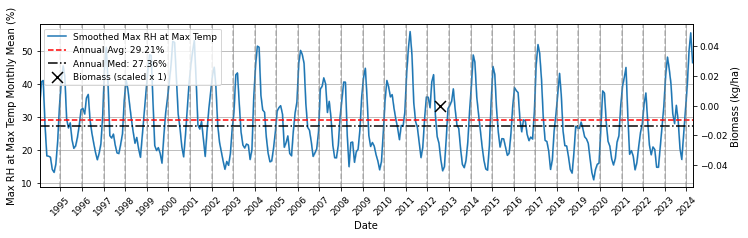

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh05_2012_1ha_rh_tmax_mean_line.jpg
wh06.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh06
(1, 24)
Event dates: ['2012-07-25T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

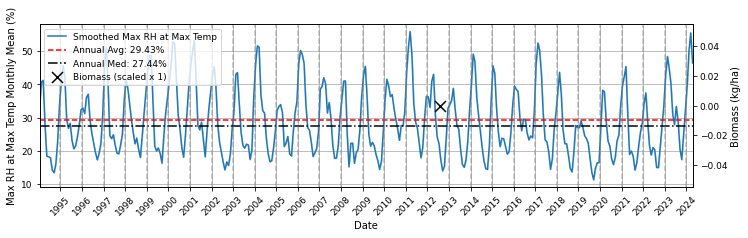

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh06_2012_1ha_rh_tmax_mean_line.jpg
wh07.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh07
(1, 24)
Event dates: ['2012-07-25T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

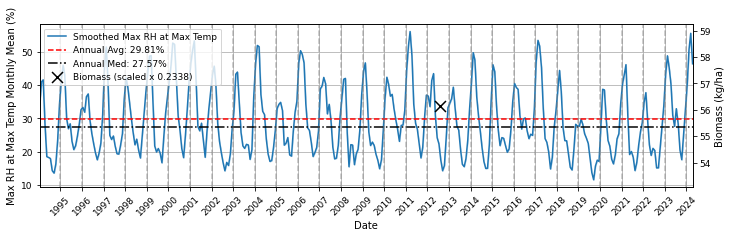

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh07_2012_1ha_rh_tmax_mean_line.jpg
wh08.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh08
(1, 24)
Event dates: ['2012-07-25T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

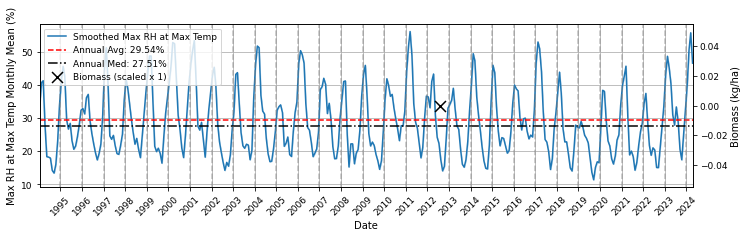

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh08_2012_1ha_rh_tmax_mean_line.jpg
wh09.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh09
(1, 24)
Event dates: ['2012-07-25T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

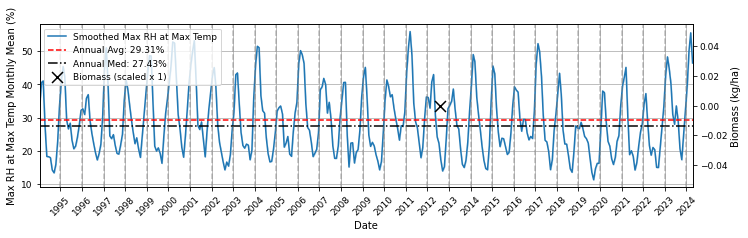

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh09_2012_1ha_rh_tmax_mean_line.jpg
wh13.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh13
(1, 24)
Event dates: ['2012-07-26T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

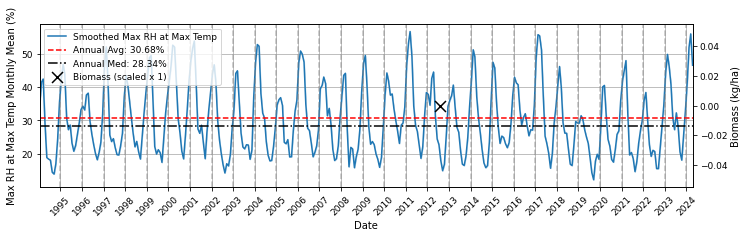

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh13_2012_1ha_rh_tmax_mean_line.jpg
wh15.2012_1ha
site_df shape:  (752, 6)
filtering biomass: wh15
(1, 24)
Event dates: ['2012-07-27T00:00:00.000000000']


C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\robot\anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

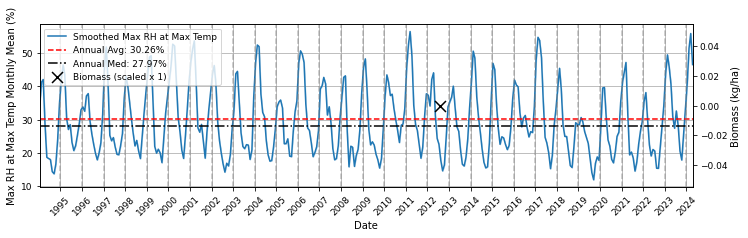

Exported to: C:\Users\robot\projects\biomass\plots\rh_tmax\timeseries\mean\wh15_2012_1ha_rh_tmax_mean_line.jpg


In [35]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
from glob import glob
from matplotlib.dates import DateFormatter

# Load biomass data
biomass = pd.read_csv(r"C:\Users\robot\projects\biomass\collated_agb\20240707\slats_tern_biomass.csv")
biomass['event_date'] = pd.to_datetime(biomass['date'], format='%Y%m%d')

# Function to change the day of the date
def change_day(date, new_day):
    return date.replace(day=new_day)

# Directory containing the CSV files
#dir_ = r"C:\Users\robot\projects\biomass\zonal_stats_raw\met_clean\daily_rain\mth_msum"

# Combine lists of .csv files from both directories
all_files = []
for dir_path in [dir_, dir2_]:
    all_files.extend(glob(os.path.join(dir_path, "*.csv")))

# Collate all CSVs into one DataFrame
df_list = []
for csv_file in all_files:
    df = pd.read_csv(csv_file)
    df.dropna(inplace=True)
    df.drop_duplicates(inplace=True)
    df_list.append(df)

combined_df = pd.concat(df_list, ignore_index=True)
print(combined_df.head())

# Extract unique sites
unique_sites = combined_df['site'].unique()
print(unique_sites)

# Loop through unique sites for analysis and plotting
for site in unique_sites:
    site_df = combined_df[combined_df['site'] == site]
    print(site)
    print("site_df shape: ", site_df.shape)
    site_name, field_year = site.split(".")

        # # Extract site name and year from the filename
        # _, filename = os.path.split(f)
        # site_name, field_year = filename.split("_")[0].split(".")
        # print(site_name, field_year)
        # # capitalize names
    cap_site_name = site_name.upper()
    capitalized_str_type = str_type.capitalize()

    # Convert date and add new day
    site_df['date'] = pd.to_datetime(site_df['im_date'], format='%Y%m')
    site_df['day'] = 15
    site_df['new_date'] = site_df.apply(lambda row: change_day(row['date'], row['day']), axis=1)
    site_df['month'] = site_df['new_date'].dt.month
    site_df['year'] = site_df['new_date'].dt.year

    # Filter biomass data for the site
    print(f"filtering biomass: {site_name}")
    site_biomass = biomass[biomass["site_name"].str.lower() == site_name.lower()]
    print(site_biomass.shape)
    # Check if site_biomass is empty
    if site_biomass.empty:
        print(f"No biomass data found for site: {site_name}. Stopping script.")
        raise SystemExit("Script terminated due to empty site_biomass DataFrame.")
    event_dates = site_biomass['event_date'].unique()
    bio_agb_kg1ha = site_biomass['bio_agb_kg1ha'].unique()

    print("Event dates:", event_dates)

#     # Filter data to include at most 30 years
#     start_year = site_df['year'].min()
#     site_df = site_df[site_df['year'] <= start_year + 30]

    # Get the maximum year (end_year)
    end_year = site_df['year'].max()

    # Filter data to include only the last 30 years from the end_year
    site_df = site_df[site_df['year'] >= end_year - 30]

    # Calculate rolling mean to smooth the data
    site_df['smoothed_value'] = site_df['mean'].rolling(window=2, min_periods=1).mean()
    mean_annual_value = site_df.groupby('year')['smoothed_value'].mean().mean()
    median_annual_value = site_df.groupby('year')['smoothed_value'].median().median()

    # Determine maximum values for normalization
    max_rainfall = site_df['smoothed_value'].max()
    max_biomass = max(bio_agb_kg1ha) if len(bio_agb_kg1ha) > 0 else 1
    biomass_factor = max_rainfall / max_biomass if max_biomass != 0 else 1

    # Create time trace plot with smoothed data
    fig, ax1 = plt.subplots(figsize=(11.7, 3))

    lowercase_str_type = str_type.lower()
    sns.lineplot(x='new_date', y='smoothed_value', data=site_df, ax=ax1, label=f'Smoothed {str_type}')
    #ax1.set_title(f'{cap_site_name} Mean Monthly {capitalized_str_type} Time Trace Plot with Smoothed Line (Data from {site_df["year"].nunique()-1} Year{"s" if site_df["year"].nunique() > 1 else ""})')
    ax1.set_xlabel('Date')
    #ax1.set_ylabel(f'{capitalized_str_type} ({unit})')
    ax1.set_ylabel(f'{str_type} Monthly Mean ({unit})')
    ax1.grid(True)

    # Adding horizontal lines for mean and median annual values
#     ax1.axhline(y=mean_annual_value, color='red', linestyle='--', label=f'Annual Median: {mean_annual_value:.2f}')
#     ax1.axhline(y=median_annual_value, color='black', linestyle='-.', label=f'Annual Median: {median_annual_value:.2f}')

    ax1.axhline(y=mean_annual_value, color='red', linestyle='--', label=f'Annual Avg: {mean_annual_value:.2f}{unit}')
    ax1.axhline(y=median_annual_value, color='black', linestyle='-.', label=f'Annual Med: {median_annual_value:.2f}{unit}')

    # Adding vertical lines and annotations for each year
    for year in site_df['year'].unique():
        ax1.axvline(pd.Timestamp(year=year, month=1, day=1), color='gray', linestyle='--', alpha=0.5)
#         ax1.text(pd.Timestamp(year=year, month=6, day=15), site_df['smoothed_value'].max(), str(year), 
#                  horizontalalignment='center', verticalalignment='center', color='gray', alpha=0.7, fontsize=10)

    # Create a secondary y-axis to plot biomass data
    ax2 = ax1.twinx()
    ax2.set_ylabel('Biomass (kg/ha)')

    # Adding biomass data points on the secondary y-axis with scaling
    for bio_date, bio_value in zip(event_dates, bio_agb_kg1ha):
        scaled_bio_value = bio_value * biomass_factor
        round_factor = round(biomass_factor, 4)
        ax2.scatter(bio_date, scaled_bio_value, color='black', zorder=5, marker = 'x',
                    label=f'Biomass (scaled x {round_factor})', s=120)
#         ax2.text(bio_date, scaled_bio_value, 'Normalised Biomass', 
#                  horizontalalignment='left', verticalalignment='bottom', color='black', zorder=5)


    # Ensuring only unique labels in the legend
    handles1, labels1 = ax1.get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    by_label = dict(zip(labels1 + labels2, handles1 + handles2))
    ax1.legend(by_label.values(), by_label.keys(), loc='upper left')

    # Aligning x-axis ticks and limits
    ax1.set_xlim(site_df['new_date'].min(), site_df['new_date'].max())
    ax1.set_xticks(pd.date_range(start=site_df['new_date'].min(), end=site_df['new_date'].max(), freq='YS'))
    ax1.set_xticklabels(pd.date_range(start=site_df['new_date'].min(), end=site_df['new_date'].max(), freq='YS').strftime('%Y-%m-%d'), rotation=45)
    ax1.xaxis.set_major_formatter(DateFormatter('%Y'))

#     # Setting y-axis ticks to start at 0 for both axes with an interval of 200
#     max_y = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
#     min_y = min(ax1.get_ylim()[0], ax2.get_ylim()[0])
#     ax1.set_ylim(min_y, max_y)
#     ax2.set_ylim(min_y, max_y)

#     y_ticks = np.arange(0, max_y + 200, 200)
#     ax1.set_yticks(y_ticks)
#     ax2.set_yticks(y_ticks)

    line_out = os.path.join(export_line, f"{site_name}_{field_year}_{d_type}_mean_line.jpg")
    plt.savefig(line_out, bbox_inches='tight', dpi=300,)
    plt.show()
    print(f"Exported to: {line_out}")
    plt.close()

In [29]:
    # Filter biomass data for the site
    print(f"filtering biomass: {site_name}")
    site_biomass = biomass[biomass["site_name"] == site_name]
    print(site_biomass.shape)
    event_dates = site_biomass['event_date'].unique()
    bio_agb_kg1ha = site_biomass['bio_agb_kg1ha'].unique()

filtering biomass: wh15
(1, 24)


In [12]:
filtered_df = biomass[biomass['site_name'].str.contains('ntt', case=False, na=False)]

In [13]:
filtered_df

,uid,site,site_name,date,lon_gda94,lat_gda94,bio_l_kg1ha,bio_t_kg1ha,bio_b_kg1ha,bio_w_kg1ha,...,c_l_kg1ha,c_t_kg1ha,c_b_kg1ha,c_w_kg1ha,c_br_kg1ha,c_s_kg1ha,c_r_kg1ha,c_agb_kg1ha,geometry,event_date
143,144,nttdab0001_2014,NTTDAB0001,20140317,131.6740,-13.96288,185.030312,200.853970,721.494709,4285.741048,...,393.681515,409.906061,1472.438182,8746.410303,3133.180000,10218.848485,2773.397576,13727.376667,POINT (131.674 -13.96288),2014-03-17
144,145,nttdac0001_2014,NTTDAC0001,20140318,130.7957,-13.13983,367.116478,398.419544,1127.638089,6481.816094,...,781.098889,813.101111,2301.302222,13228.196111,5310.219444,15529.498333,3661.812222,21519.594444,POINT (130.7957 -13.13983),2014-03-18
145,146,nttmgd0001_2014,NTTMGD0001,20140315,133.4239,-17.28297,139.958726,152.190306,594.640472,1934.542750,...,297.784524,310.592460,1213.551984,3948.046429,2993.855159,5161.598413,1735.475397,8453.238095,POINT (133.4239 -17.28297),2014-03-15
146,147,nttpck0001_2014,NTTPCK0001,20140319,131.1270,-12.87196,297.417940,322.857811,1017.275039,4993.764689,...,632.804127,658.893492,2076.071508,10191.356508,4754.273810,12267.428016,3300.995079,17606.505952,POINT (131.127 -12.87196),2014-03-19
147,148,nttstu0001_2014,NTTSTU0001,20140315,133.2712,-16.63024,697.113792,758.037486,2961.816569,9635.672375,...,1483.220833,1547.015278,6044.523611,19664.637500,14911.951389,25709.161111,8644.147222,42104.333333,POINT (133.2712 -16.63024),2014-03-15


# END

annual total = sum of the mean rainfall across all months in a year

month_avg = the sum of the mean monthly rainfall for each month across all years

# Plot all met variables

In [ ]:
# type of data
d_type = "daily_rain"
#d_type = "et_morton_actual"
#d_type = "max_temp"
#d_type = "min_temp"
#d_type = "rh_tmax"
#d_type = "rh_tmin"
# d_type = "vp"


if d_type == "daily_rain":
    str_type = "precipitation"
    y_lim = [-5, 25]
    
elif d_type == "et_morton_actual":
    str_type = "Morton's evapotranspiration"
    y_lim = [0, 10]

elif d_type == "max_temp":
    str_type = "maximum temperature"
    y_lim = [20, 45]

elif d_type == "min_temp":
    str_type = "minimum temperature"
    y_lim = [0, 40]

elif d_type == "rh_tmax":
    str_type = "maximum relative humidity"
    y_lim = [3200, 3400]
    
elif d_type == "rh_tmin":
    str_type = "minimum relative humidity"
    y_lim = [3200, 3400]

elif d_type == "vp":
    str_type = "vapour pressure"
    
elif d_type == "all":
    str_type = "meterological variables"
    
else:
    pass

# met data
#dir_ = r"X:\PGB\RSU\biomass\raw_zonal_stats\met\collation\slats_tern\{0}".format(d_type)
rain_dir_ = r"X:\PGB\RSU\biomass\zonal_stats_raw\met_clean\daily_rain"
et_dir_ = r"X:\PGB\RSU\biomass\zonal_stats_raw\met_clean\et_morton_actual"
max_tem_dir_ = r"X:\PGB\RSU\biomass\zonal_stats_raw\met_clean\max_temp"
rain_dir_ = r"X:\PGB\RSU\biomass\zonal_stats_raw\met_clean\daily_rain"
rain_dir_ = r"X:\PGB\RSU\biomass\zonal_stats_raw\met_clean\daily_rain"
rain_dir_ = r"X:\PGB\RSU\biomass\zonal_stats_raw\met_clean\daily_rain"

# plot directories
export_dir = r"X:\PGB\RSU\biomass\plots\slats_tern\{0}".format(d_type)
mk_dir_fn(export_dir)

export_box = os.path.join(export_dir, "box_plots")
mk_dir_fn(export_box)
export_line = os.path.join(export_dir, "line_plots")
mk_dir_fn(export_line)


csv_export = r"X:\PGB\RSU\biomass\met_zonal_stats_per_site\slats_tern\{0}".format(d_type)
mk_dir_fn(csv_export)

monthly_dir = os.path.join(csv_export, "mean_monthly_{0}".format(d_type))
mk_dir_fn(monthly_dir)

mean_monthly_dir = os.path.join(csv_export, "monthly_{0}".format(d_type))
mk_dir_fn(mean_monthly_dir)

seasonal_dir = os.path.join(csv_export, "seasonal_{0}".format(d_type))
mk_dir_fn(seasonal_dir)

si_dir = os.path.join(csv_export, "si_{0}".format(d_type))
mk_dir_fn(si_dir)

In [ ]:
for f in glob(os.path.join(dir_, "*.csv")):
    csv_file = f
    print("-"*100)
    print("working for: ", f)
    
    df = pd.read_csv(csv_file)
    df.dropna(inplace=True)
    df1 = pd.read_csv(csv_file)
    df1.dropna(inplace=True)
    
    # extract name and site year
    _, f = os.path.split(csv_file)
    flist = f.split("_")
    site_name, field_year = flist[0].split(".")
    print(site_name, field_year)
    
    # splitting date time to year month and day
    year = []
    month = []
    day = []

    for index, row in df.iterrows():
        #print(row["im_date"])
        date = str(row["im_date"])
        year.append(date[:4])
        month.append(date[4:6])
        day.append(date[6:])

    df["year"] = year
    df["month"] = month
    df["day"] = day
    
    # collate df
    year_list = []
    month_list = []

    mean_list = []
    
    #print(list(df.columns))

#     # ---------------- calulate montly mean met value across all data ---------------------------
    
    for y in df["year"].unique():
        #year_list.append(y)
        y_df = df[df["year"]== y]

        for m in y_df["month"].unique():
            my_df = y_df[y_df["month"]== m]
            
            col_list = my_df.columns.tolist()
            #print(col_list)
            matches = [match for match in col_list if "mean" in match]
            #print(matches[0])
            ym = my_df[matches[0]].tolist()
            year_list.append(y)
            month_list.append(m)
            mean_list.append(mean(ym))
            
            
    monthly_df = pd.DataFrame({"year": year_list,
                     "month": month_list,
                    "mean": mean_list})
    
    monthly_df.insert(0, "site", site_name)
    monthly_df.insert(1, "site_year", field_year)
    monthly_df.insert(2, "met", d_type)
    
    monthly_out = os.path.join(monthly_dir, f"{site_name}_monthly_{d_type}.csv")
    monthly_df.to_csv(monthly_out, index = False)
    
#     # ------------------------------------------------------------------------------------------
    
    
    month_list2 = []
    mean_month_list = []
    month_list3 = []

    for m in monthly_df["month"].unique():
        #print("month: ", m)
        #month_list3.append(m)

        my_df = monthly_df[monthly_df["month"]== m]
        month_var = my_df["mean"].tolist()
        
        mean_month_list.append(mean(month_var))
        month_list3.append(month_var)
        month_list2.append(m)
    
    #print("month_list2: ", month_list2)
    #print("mean_month_list: ", mean_month_list)
    #print("="*50)
    mean_monthly_df = pd.DataFrame({
                             "month": month_list2,
                            "var": mean_month_list})
    
    mean_monthly_df.insert(0, "site", site_name)
    mean_monthly_df.insert(1, "site_year", field_year)
    mean_monthly_df.insert(2, "met", d_type)
    
    mean_monthly_out = os.path.join(mean_monthly_dir, f"{site_name}_mean_monthly_{d_type}.csv")
    mean_monthly_df.to_csv(mean_monthly_out, index = False)
    
    print("export: ", mean_monthly_out)

    
    # ------------------------------------------ Box Plot -----------------------------------------------
        
    data = month_list3
    #print(data)

    fig = plt.figure(figsize =(10, 7))
    plt.ylim(y_lim[0], y_lim[1])

    plt.xticks([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12], 
               ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'June', 'July', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'], 
               #rotation=90,  fontsize='12',
              )
    plt.title(f'Mean monthly {str_type} variation between 1988 and 2024 at site: {site_name}.',  fontsize='12', horizontalalignment='center')
    # Custom Axis title
    plt.xlabel('Months',  fontsize='12', horizontalalignment='center')
    # Custom Axis title
    plt.ylabel('Monthly mean {0} ({1}})'.format(str_type, unit),  fontsize='12', horizontalalignment='center')
    # Creating plot
    plt.boxplot(data, showfliers = False)

    box_out = os.path.join(export_box, f"{site_name}_{field_year}_{d_type}_box.jpg")
    plt.savefig(box_out)
    
    #show plot
    plt.show()
    
    print("box plot output: ", box_out)
    
    # ---------------------- Time Trace --------------------------

    # Time trace 
    y_list = monthly_df["year"].tolist()
    m_list = monthly_df["month"].tolist()
    val_list = monthly_df["mean"].tolist()
    dt_list2 = []
    year__ = monthly_df["year"].unique().tolist()
    for y, m, v  in zip(y_list, m_list, val_list):
        i = f"{str(y)}{str(m)}15"

        dt_list2.append(pd.to_datetime(i, format='%Y%m%d'))

    df3 = pd.DataFrame(val_list, index=dt_list2, columns=["met"])

    fig, axs = plt.subplots(1,1, figsize=(18,5))
    x = df3.index
    y = df3.met
    axs.plot(x, y, label='Rainfall')
    fig.show() 
    
    plt.title('Time trace mean {0} between 1988 and 2024, site: {1} .'.format(str_type, site_name),  fontsize='14', horizontalalignment='center')
    # Custom Axis title
    plt.xlabel('Years',  fontsize='14', horizontalalignment='center')
    # Custom Axis title
    plt.ylabel('Mean monthly {0} (mm)'.format(str_type),  fontsize='14', horizontalalignment='center')

    axs.set_xticklabels(year__)
    axs.xaxis.set_ticks(year__)
    plt.xticks(rotation=90, ha='right', fontsize='12')
    # limit data time
    plt.xlim(['1993', '2024'])
    
    median_value = np.median(y)
    axs.axhline(median_value, color='grey', linestyle='--', label=f'Median: {median_value:.2f}')
    axs.legend()
    
    mean_value = np.mean(y)
    axs.axhline(mean_value, color='black', linestyle='--', label=f'Mean: {mean_value:.2f}')
    axs.legend()

    #plt.ylim([0, :]) not sure if this will work
    line_out = os.path.join(export_line, f"{site_name}_{field_year}_{d_type}_line.jpg")
    plt.savefig(line_out)
    fig.show()     
    print("Timetrace plot output: ", line_out)
    
    # ---------------- calulate montly mean met value across all data ---------------------------

    dict_ = {"year": [],
            "month": [],
             "ym_total": [],
            "annual_total": [],
            }

    djf = []
    mam = []
    jja = []
    son = []
    dry = []
    wet = []
    df.dropna(inplace=True)
    
    # seperate per year
    for y in df["year"].unique():
        #year_list.append(y)
        y_df = df[df["year"]== y]
        
        col_list = y_df.columns.tolist()
        #print(col_list)
        matches = [match for match in col_list if "mean" in match]
        #print(matches[0])
        mean_values = y_df[matches[0]].tolist()
        #print("mean_heading: ", mean_heading)

#         y_sum = y_df[mean_heading].tolist()
#         print("y_sum values: ", y_sum)
        annual_totals = sum(mean_values)

        #seperate per month per year
        for m in y_df["month"].unique():
            my_df = y_df[y_df["month"]== m]

            dict_["year"].append(y)
            dict_["month"].append(m)

            #print(my_df)

            col_list = my_df.columns.tolist()
            #print(col_list)
            matches = [match for match in col_list if "mean" in match]
            #print(matches[0])
            ym_values = my_df[matches[0]].tolist()

            #ym_values = my_df[mean_heading].tolist()
            #print("ym_sum values: ", ym_sum)
            month_year_totals = sum(ym_values)
            #print("annual_totals: ", annual_totals)

            dict_["annual_total"].append(annual_totals)
            dict_["ym_total"].append(month_year_totals)


    new_df = pd.DataFrame(dict_)

    new_df
    # new_df["month_avg"] = 0
    month_avg = []

    # Calculate the monthly average
    for m in new_df["month"].unique():
        #year_list.append(y)
        m_df = new_df[new_df["month"]== m]

        m_sum = m_df["ym_total"].tolist()
        #print("m_sum values: ", m_sum)
        month_average = sum(m_sum)
        m_df["month_avg"] = month_average 
        month_avg.append(m_df)

    out_df = pd.concat(month_avg)


    year = []

    djf_list = []
    mam_list = []

    dict_ = {"site": [],
            "year": [],
            "djf": [],
            "mam": [],
            "jja": [],
            "son": [],
            "dry": [],
            "wet": [],
             "annual" : [],
             #"si": [],
            }
    # seperate per year
    for y in out_df["year"].unique():
        #year_list.append(y)
        int_lst_y = int(y)-1
        str_l_year = str(int_lst_y)
        y_df = out_df[out_df["year"]== y]
        prev_y_df  = out_df[out_df["year"]== str_l_year]
        dict_["year"].append(y)

        tot_list = y_df["annual_total"].unique().tolist()
        dict_["annual"].append(tot_list[0])

        dict_["site"].append(site_name)

        #seperate into seasons
        djf_df1 = y_df[(y_df["month"]== "01") | (y_df["month"]== "02")]
        djf_df2 = prev_y_df[prev_y_df["month"]== "12"]
        djf_df = pd.concat([djf_df1, djf_df2])
        djf = djf_df["ym_total"].tolist()
        djf_df["djf_tot"] = sum(djf)
        dict_["djf"].append(sum(djf))


        #seperate into seasons
        mam_df = y_df[(y_df["month"]== "03") | (y_df["month"]== "04") | (y_df["month"]== "05")]
        mam = mam_df["ym_total"].tolist()
        mam_df["mam_tot"] = sum(mam)
        dict_["mam"].append(sum(mam))

        #seperate into seasons
        jja_df = y_df[(y_df["month"]== "06") | (y_df["month"]== "07") | (y_df["month"]== "08")]
        jja = jja_df["ym_total"].tolist()
        jja_df["jja_tot"] = sum(jja)
        dict_["jja"].append(sum(jja))

        #seperate into seasons
        son_df = y_df[(y_df["month"]== "09") | (y_df["month"]== "10") | (y_df["month"]== "11")]
        son = son_df["ym_total"].tolist()
        son_df["son_tot"] = sum(son)
        dict_["son"].append(sum(son))

        #seperate into seasons
        dry_df = y_df[(y_df["month"]== "05") | (y_df["month"]== "06") | (y_df["month"]== "07") | (y_df["month"]== "08") | (y_df["month"]== "09")]
        dry = dry_df["ym_total"].tolist()
        dry_df["dry_tot"] = sum(dry)
        dict_["dry"].append(sum(dry))

        #seperate into seasons
        wet_df = y_df[(y_df["month"]== "01") | (y_df["month"]== "02") | (y_df["month"]== "03") | (y_df["month"]== "04") | (y_df["month"]== "10") | (y_df["month"]== "11") | (y_df["month"]== "12")]
        wet = wet_df["ym_total"].tolist()
        wet_df["wet_tot"] = sum(wet)
        dict_["wet"].append(sum(wet))

    seasonal_df = pd.DataFrame(dict_)
    csv_out = os.path.join(seasonal_dir, f"seasonal_{site_name}_{field_year}_{d_type}.csv")
    print("export: ", csv_out)
    seasonal_df.to_csv(csv_out, index=False)
    
    # --------------------------------------------------- seasonal index -------------------------------------
    print("="*50)
    dict2 = {"site": [],
             "year": [],
         "month": [],
         "month_total": [],
         "month_average": [],
        "annual_total": [],
        "annual_average_R": [],
        "annual_si": []
        }
    # seperate per year
    for y in df["year"].unique():
        y_df = df[df["year"]== y]
        
        col_list = y_df.columns.tolist()
        #print(col_list)
        matches = [match for match in col_list if "mean" in match]
        print(matches[0])
        
        y_sum = y_df[matches[0]].tolist()
        #calucalue annual rainfall totals
        annual_total = sum(y_sum)
        #print("annual_total: ", annual_total)

        # calculate the annual rainfall mean
        R = mean(y_sum)
        #print("annual average R: ", R)
        #print(y_sum)

        month_avg = []
        #seperate per month per year
        month_list = y_df["month"].unique()
        for m in month_list:
            my_df = y_df[y_df["month"]== m]
            ym_sum = my_df[matches[0]].tolist()
            # Calculate monthly rainfall totals per year
            month_year_totals = sum(ym_sum)

            # Calculate monthly ranfall per year averages
            month_year_avg = mean(ym_sum)
            month_avg.append(month_year_avg)

            # append values to dictonary
            dict2["site"].append(site_name)
            dict2["year"].append(y)
            dict2["month"].append(m)
            dict2["annual_total"].append(annual_total)
            dict2["annual_average_R"].append(R)
            dict2["month_total"].append(month_year_totals)
            dict2["month_average"].append(month_year_avg)
            

        # append si values
        for i in month_list:
            # call si funcution
            #print("month_avg: ", month_avg)
            si = si_fn(R, month_avg)
            print(f"si for {site_name} and {year} form month = {1}: ", si)
            dict2["annual_si"].append(si)
            
    si_df = pd.DataFrame(dict2)
    si_out = os.path.join(si_dir, f"seasonal_{site_name}_{field_year}_{d_type}.csv")
    print("export: ", si_out)
    si_df.to_csv(si_out, index=False)

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of Seaborn color palettes to display
palettes = ["deep", "muted", "bright", "pastel", "dark", "colorblind"]

# Create a plot to display each palette
for palette in palettes:
    sns.palplot(sns.color_palette(palette))
    plt.title(f"Seaborn Palette: {palette}")
    plt.show()